In [1]:
import json
import re
import os
from pathlib import Path

import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import pytorch_lightning as pl
import tifffile
import torch
import torch.nn.functional as T
import torchvision.transforms.functional as TF
import wandb
from torch.utils.data import Dataset, DataLoader
from einops import rearrange
from pytorch_lightning.loggers import WandbLogger
from pytorch_lightning.callbacks import ModelCheckpoint

In [2]:
%load_ext autoreload

In [3]:
%autoreload 2

In [4]:
import mushroom.utils as utils
from mushroom.dataloaders import SliceTripletDataset
from mushroom.models.clustering import SliceClustering, LitSliceClustering, cluster_embeddings, cluster_pt_clouds
from mushroom.logging import ClusteringLoggingCallback


In [5]:
wandb.login()

wandb: Currently logged in as: estorrs (tme-st). Use `wandb login --relogin` to force relogin


True

In [6]:
s0 = torch.load('/data/estorrs/DINO-extended/data/runs/HT397B1/metagene_dino_v2/results/s0_50knn.pt')
s1 = torch.load('/data/estorrs/DINO-extended/data/runs/HT397B1/codex_dino/multiplex_dino_v2_p8x8_res1.0/results/s1_20knn.pt')
s2 = torch.load('/data/estorrs/DINO-extended/data/runs/HT397B1/codex_dino/multiplex_dino_v2_p8x8_res1.0/results/s2_20knn.pt')
s3 = torch.load('/data/estorrs/DINO-extended/data/runs/HT397B1/metagene_dino_v2/results/s3_50knn.pt')
s4 = torch.load('/data/estorrs/DINO-extended/data/runs/HT397B1/codex_dino/multiplex_dino_v2_p8x8_res1.0/results/s4_20knn.pt')
s5 = torch.load('/data/estorrs/DINO-extended/data/runs/HT397B1/codex_dino/multiplex_dino_v2_p8x8_res1.0/results/s5_20knn.pt')
for k, v in s0.items():
    print(k, v.shape)
    

clustered_patches torch.Size([192, 188])
patch_centroids torch.Size([50, 1024])
patch_embs torch.Size([1024, 192, 188])


In [7]:
for s in [s0, s1, s2, s3, s4, s5]:
    print(s['patch_embs'].shape)

torch.Size([1024, 192, 188])
torch.Size([1024, 484, 480])
torch.Size([1024, 484, 480])
torch.Size([1024, 192, 188])
torch.Size([1024, 484, 480])
torch.Size([1024, 484, 480])


In [8]:
x0, x1, x2, x3, x4, x5 = [x['patch_embs'] for x in [s0, s1, s2, s3, s4, s5]]
x0 = TF.resize(x0, x1.shape[1:], antialias=False)
x3 = TF.resize(x3, x1.shape[1:], antialias=False)
[x.shape for x in [x0, x1, x2, x3, x4, x5]]

[torch.Size([1024, 484, 480]),
 torch.Size([1024, 484, 480]),
 torch.Size([1024, 484, 480]),
 torch.Size([1024, 484, 480]),
 torch.Size([1024, 484, 480]),
 torch.Size([1024, 484, 480])]

In [9]:
slices = torch.concat([x.unsqueeze(0) for x in [x0, x1, x2, x3, x4, x5]])
slices.shape

torch.Size([6, 1024, 484, 480])

In [10]:
means, stds = slices.mean(dim=(0, 2, 3)), slices.std(dim=(0, 2, 3))

In [11]:
slices = TF.normalize(slices, mean=means, std=stds)
slices.shape

torch.Size([6, 1024, 484, 480])

In [12]:
ds = SliceTripletDataset(slices, size=8)
len(ds)

232320

In [13]:
d = ds[0]
d.keys()

dict_keys(['anchor', 'pos', 'neg', 'anchor_rc', 'neg_rc', 'anchor_slide_idx', 'pos_slide_idx', 'neg_slide_idx'])

In [14]:
batch_size = 128
dl = DataLoader(ds, batch_size=batch_size, shuffle=True, num_workers=30)

In [15]:
b = next(iter(dl))

In [16]:
model = SliceClustering(len(ds[0]['anchor']), emb_dim=64)

In [17]:
anchor, pos, neg = b['anchor'], b['pos'], b['neg']
result = model(anchor, pos, neg)

result['anchor_embs'].shape

torch.Size([512, 64])

In [18]:
model.calculate_loss(result)

{'overall': tensor(1.1511, grad_fn=<MeanBackward0>)}

In [19]:
b['anchor_slide_idx'], b['pos_slide_idx'], b['neg_slide_idx']

(tensor([3, 5, 2, 2, 5, 0, 3, 0, 3, 0, 0, 1, 4, 0, 5, 1, 2, 3, 1, 1, 3, 1, 4, 0,
         2, 5, 0, 2, 3, 5, 2, 1, 1, 4, 3, 1, 0, 2, 0, 3, 3, 3, 1, 0, 1, 5, 3, 1,
         4, 4, 4, 3, 5, 2, 0, 2, 1, 4, 1, 3, 0, 1, 3, 2, 3, 1, 1, 2, 5, 3, 2, 5,
         0, 3, 3, 2, 4, 2, 4, 2, 1, 5, 1, 0, 4, 3, 4, 0, 4, 5, 5, 5, 1, 5, 5, 5,
         0, 2, 0, 0, 3, 1, 3, 1, 1, 0, 4, 3, 5, 0, 2, 1, 4, 3, 5, 2, 3, 4, 3, 0,
         0, 0, 3, 4, 1, 4, 1, 2, 2, 2, 0, 5, 3, 1, 4, 5, 3, 1, 3, 0, 0, 1, 2, 0,
         1, 0, 4, 3, 5, 4, 2, 0, 1, 3, 1, 5, 0, 4, 2, 5, 5, 5, 1, 3, 4, 0, 5, 2,
         1, 2, 5, 3, 3, 1, 3, 5, 0, 1, 3, 0, 3, 0, 2, 4, 1, 4, 1, 4, 3, 3, 1, 1,
         4, 2, 2, 3, 0, 4, 0, 4, 4, 4, 0, 2, 2, 5, 1, 3, 4, 1, 5, 0, 1, 2, 2, 5,
         5, 2, 3, 0, 1, 1, 5, 5, 2, 0, 0, 5, 0, 0, 5, 5, 0, 5, 3, 3, 3, 3, 2, 2,
         1, 3, 4, 0, 1, 4, 2, 1, 1, 0, 1, 3, 3, 4, 0, 0, 0, 0, 4, 4, 3, 2, 2, 0,
         5, 0, 2, 3, 5, 0, 4, 3, 2, 4, 3, 0, 1, 5, 1, 1, 0, 0, 4, 3, 2, 1, 1, 2,
         5, 0, 5, 0, 0, 1, 3

In [20]:
b['anchor_rc'], b['neg_rc']

(tensor([[447, 469],
         [487, 296],
         [130, 331],
         ...,
         [423, 144],
         [ 93, 157],
         [ 93, 294]]),
 tensor([[302, 288],
         [ 68, 356],
         [441, 286],
         ...,
         [443,  87],
         [ 48,  26],
         [411,  81]]))

In [15]:
project = 'slice_clusterer_v3'
run_dir = f'/data/estorrs/mushroom/data/slice_clustering/{project}/slice_clusterer_v1'
log_dir = os.path.join(run_dir, 'logs')
chkpt_dir = os.path.join(run_dir, 'chkpts')
Path(log_dir).mkdir(parents=True, exist_ok=True)
Path(chkpt_dir).mkdir(parents=True, exist_ok=True)

In [16]:
logger = WandbLogger(project=project, save_dir=log_dir)

In [17]:
# wandb.finish()

In [18]:
config = {
    'in_dim': len(ds[0]['anchor']),
    'emb_dim': 64,
    'batch_size': batch_size,
    'n_clusters': 20,
    'slide_shape': x0.shape[1:],
    'size': 8,
    'training': {
        'max_epochs': 1000,
        'limit_train_batches': 1.,
        'accelerator': 'gpu',
        'devices': [1],
        'lr': 5e-4,
        'precision': 32,
        'chkpt_dir': chkpt_dir,
        'log_every': 10,
    },
}
logger.experiment.config.update(config)

In [19]:
pred_ds = SliceTripletDataset(slices, size=config['size'])
pred_dl = DataLoader(pred_ds, batch_size=batch_size, shuffle=False, num_workers=10)

In [20]:
m = SliceClustering(
    config['in_dim'],
    emb_dim=config['emb_dim'],
)

model = LitSliceClustering(m, config)

In [21]:
trainer = pl.Trainer(
    callbacks=[
        ModelCheckpoint(dirpath=config['training']['chkpt_dir'], save_top_k=5, monitor="train/loss"),
        ClusteringLoggingCallback(pred_dl, config['slide_shape'], n_clusters=config['n_clusters']),
    ],
    devices=config['training']['devices'],
    accelerator=config['training']['accelerator'],
    max_epochs=config['training']['max_epochs'],
    precision=config['training']['precision'],
    limit_train_batches=config['training']['limit_train_batches'],
    check_val_every_n_epoch=config['training']['log_every'],
    logger=logger
)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..
Exception in thread SystemMonitor:
Traceback (most recent call last):
  File "/data/estorrs/miniconda3/envs/mushroom/lib/python3.10/threading.py", line 1016, in _bootstrap_inner
    self.run()
  File "/data/estorrs/miniconda3/envs/mushroom/lib/python3.10/threading.py", line 953, in run
    self._target(*self._args, **self._kwargs)
  File "/data/estorrs/miniconda3/envs/mushroom/lib/python3.10/site-packages/wandb/sdk/internal/system/system_monitor.py", line 118, in _start
    asset.start()
  File "/data/estorrs/miniconda3/envs/mushroom/lib/python3.10/site-packages/wandb/sdk/internal/system/assets/cpu.py", line 166, in start
    self.metrics_monitor.start()
  File "/data/estorrs/miniconda3/envs/mushroom/lib/python3.10/site-packages/wandb/sdk/i

In [22]:
trainer.fit(model=model, train_dataloaders=dl, val_dataloaders=pred_dl)

/data/estorrs/miniconda3/envs/mushroom/lib/python3.10/site-packages/pytorch_lightning/callbacks/model_checkpoint.py:613: UserWarning: Checkpoint directory /data/estorrs/mushroom/data/slice_clustering/slice_clusterer_v3/slice_clusterer_v1/chkpts exists and is not empty.
  rank_zero_warn(f"Checkpoint directory {dirpath} exists and is not empty.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2,3]

  | Name  | Type            | Params
------------------------------------------
0 | model | SliceClustering | 15.6 M
------------------------------------------
15.6 M    Trainable params
0         Non-trainable params
15.6 M    Total params
62.233    Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]



[running kmeans]: 0it [00:00, ?it/s]

[running kmeans]: 0it [00:00, ?it/s, center_shift=2021.002930, iteration=1, tol=1.000000]

[running kmeans]: 1it [00:00,  2.76it/s, center_shift=2021.002930, iteration=1, tol=1.000000]

[running kmeans]: 1it [00:00,  2.76it/s, center_shift=116.144417, iteration=2, tol=1.000000] 

[running kmeans]: 2it [00:00,  2.80it/s, center_shift=116.144417, iteration=2, tol=1.000000]

[running kmeans]: 2it [00:01,  2.80it/s, center_shift=46.235054, iteration=3, tol=1.000000] 

[running kmeans]: 3it [00:01,  2.82it/s, center_shift=46.235054, iteration=3, tol=1.000000]

[running kmeans]: 3it [00:01,  2.82it/s, center_shift=33.388935, iteration=4, tol=1.000000]

[running kmeans]: 4it [00:01,  2.84it/s, center_shift=33.388935, iteration=4, tol=1.000000]

[running kmeans]: 4it [00:01,  2.84it/s, center_shift=13.025184, iteration=5, tol=1.000000]

[running kmeans]: 5it [00:01,  2.85it/s, center_shift=13.025184, iteration=5, tol=1.000000]

[running kmeans]: 5it [00:

Validation: 0it [00:00, ?it/s]



[running kmeans]: 0it [00:00, ?it/s]

[running kmeans]: 0it [00:00, ?it/s, center_shift=1185.579346, iteration=1, tol=1.000000]

[running kmeans]: 1it [00:00,  2.51it/s, center_shift=1185.579346, iteration=1, tol=1.000000]

[running kmeans]: 1it [00:00,  2.51it/s, center_shift=81.140633, iteration=2, tol=1.000000]  

[running kmeans]: 2it [00:00,  2.61it/s, center_shift=81.140633, iteration=2, tol=1.000000]

[running kmeans]: 2it [00:01,  2.61it/s, center_shift=33.087105, iteration=3, tol=1.000000]

[running kmeans]: 3it [00:01,  2.66it/s, center_shift=33.087105, iteration=3, tol=1.000000]

[running kmeans]: 3it [00:01,  2.66it/s, center_shift=12.924331, iteration=4, tol=1.000000]

[running kmeans]: 4it [00:01,  2.61it/s, center_shift=12.924331, iteration=4, tol=1.000000]

[running kmeans]: 4it [00:01,  2.61it/s, center_shift=5.404895, iteration=5, tol=1.000000] 

[running kmeans]: 5it [00:01,  2.65it/s, center_shift=5.404895, iteration=5, tol=1.000000]

[running kmeans]: 5it [00:02,

Validation: 0it [00:00, ?it/s]



[running kmeans]: 0it [00:00, ?it/s]

[running kmeans]: 0it [00:00, ?it/s, center_shift=1912.346191, iteration=1, tol=1.000000]

[running kmeans]: 1it [00:00,  2.56it/s, center_shift=1912.346191, iteration=1, tol=1.000000]

[running kmeans]: 1it [00:00,  2.56it/s, center_shift=96.357918, iteration=2, tol=1.000000]  

[running kmeans]: 2it [00:00,  2.71it/s, center_shift=96.357918, iteration=2, tol=1.000000]

[running kmeans]: 2it [00:01,  2.71it/s, center_shift=37.840393, iteration=3, tol=1.000000]

[running kmeans]: 3it [00:01,  2.80it/s, center_shift=37.840393, iteration=3, tol=1.000000]

[running kmeans]: 3it [00:01,  2.80it/s, center_shift=15.620306, iteration=4, tol=1.000000]

[running kmeans]: 4it [00:01,  2.85it/s, center_shift=15.620306, iteration=4, tol=1.000000]

[running kmeans]: 4it [00:01,  2.85it/s, center_shift=11.298139, iteration=5, tol=1.000000]

[running kmeans]: 5it [00:01,  2.87it/s, center_shift=11.298139, iteration=5, tol=1.000000]

[running kmeans]: 5it [00:02

Validation: 0it [00:00, ?it/s]



[running kmeans]: 0it [00:00, ?it/s]

[running kmeans]: 0it [00:00, ?it/s, center_shift=nan, iteration=1, tol=1.000000]

[running kmeans]: 1it [00:00,  2.61it/s, center_shift=nan, iteration=1, tol=1.000000]

[running kmeans]: 1it [00:00,  2.61it/s, center_shift=nan, iteration=2, tol=1.000000]

[running kmeans]: 2it [00:00,  2.72it/s, center_shift=nan, iteration=2, tol=1.000000]

[running kmeans]: 2it [00:01,  2.72it/s, center_shift=nan, iteration=3, tol=1.000000]

[running kmeans]: 3it [00:01,  2.75it/s, center_shift=nan, iteration=3, tol=1.000000]

[running kmeans]: 3it [00:01,  2.75it/s, center_shift=nan, iteration=4, tol=1.000000]

[running kmeans]: 4it [00:01,  2.77it/s, center_shift=nan, iteration=4, tol=1.000000]

[running kmeans]: 4it [00:01,  2.77it/s, center_shift=nan, iteration=5, tol=1.000000]

[running kmeans]: 5it [00:01,  2.79it/s, center_shift=nan, iteration=5, tol=1.000000]

[running kmeans]: 5it [00:02,  2.79it/s, center_shift=nan, iteration=6, tol=1.000000]

[runnin

[running kmeans]: 43it [00:15,  2.81it/s, center_shift=nan, iteration=44, tol=1.000000]

[running kmeans]: 44it [00:15,  2.81it/s, center_shift=nan, iteration=44, tol=1.000000]

[running kmeans]: 44it [00:16,  2.81it/s, center_shift=nan, iteration=45, tol=1.000000]

[running kmeans]: 45it [00:16,  2.82it/s, center_shift=nan, iteration=45, tol=1.000000]

[running kmeans]: 45it [00:16,  2.82it/s, center_shift=nan, iteration=46, tol=1.000000]

[running kmeans]: 46it [00:16,  2.82it/s, center_shift=nan, iteration=46, tol=1.000000]

[running kmeans]: 46it [00:16,  2.82it/s, center_shift=nan, iteration=47, tol=1.000000]

[running kmeans]: 47it [00:16,  2.82it/s, center_shift=nan, iteration=47, tol=1.000000]

[running kmeans]: 47it [00:17,  2.82it/s, center_shift=nan, iteration=48, tol=1.000000]

[running kmeans]: 48it [00:17,  2.82it/s, center_shift=nan, iteration=48, tol=1.000000]

[running kmeans]: 48it [00:17,  2.82it/s, center_shift=nan, iteration=49, tol=1.000000]

[running kmeans]: 49i

[running kmeans]: 86it [00:31,  2.78it/s, center_shift=nan, iteration=87, tol=1.000000]

[running kmeans]: 87it [00:31,  2.80it/s, center_shift=nan, iteration=87, tol=1.000000]

[running kmeans]: 87it [00:31,  2.80it/s, center_shift=nan, iteration=88, tol=1.000000]

[running kmeans]: 88it [00:31,  2.80it/s, center_shift=nan, iteration=88, tol=1.000000]

[running kmeans]: 88it [00:31,  2.80it/s, center_shift=nan, iteration=89, tol=1.000000]

[running kmeans]: 89it [00:31,  2.78it/s, center_shift=nan, iteration=89, tol=1.000000]

[running kmeans]: 89it [00:32,  2.78it/s, center_shift=nan, iteration=90, tol=1.000000]

[running kmeans]: 90it [00:32,  2.79it/s, center_shift=nan, iteration=90, tol=1.000000]

[running kmeans]: 90it [00:32,  2.79it/s, center_shift=nan, iteration=91, tol=1.000000]

[running kmeans]: 91it [00:32,  2.79it/s, center_shift=nan, iteration=91, tol=1.000000]

[running kmeans]: 91it [00:32,  2.79it/s, center_shift=nan, iteration=92, tol=1.000000]

[running kmeans]: 92i

[running kmeans]: 129it [00:46,  2.81it/s, center_shift=nan, iteration=129, tol=1.000000]

[running kmeans]: 129it [00:46,  2.81it/s, center_shift=nan, iteration=130, tol=1.000000]

[running kmeans]: 130it [00:46,  2.82it/s, center_shift=nan, iteration=130, tol=1.000000]

[running kmeans]: 130it [00:47,  2.82it/s, center_shift=nan, iteration=131, tol=1.000000]

[running kmeans]: 131it [00:47,  2.83it/s, center_shift=nan, iteration=131, tol=1.000000]

[running kmeans]: 131it [00:47,  2.83it/s, center_shift=nan, iteration=132, tol=1.000000]

[running kmeans]: 132it [00:47,  2.81it/s, center_shift=nan, iteration=132, tol=1.000000]

[running kmeans]: 132it [00:47,  2.81it/s, center_shift=nan, iteration=133, tol=1.000000]

[running kmeans]: 133it [00:47,  2.82it/s, center_shift=nan, iteration=133, tol=1.000000]

[running kmeans]: 133it [00:48,  2.82it/s, center_shift=nan, iteration=134, tol=1.000000]

[running kmeans]: 134it [00:48,  2.82it/s, center_shift=nan, iteration=134, tol=1.000000]


[running kmeans]: 171it [01:01,  2.83it/s, center_shift=nan, iteration=171, tol=1.000000]

[running kmeans]: 171it [01:01,  2.83it/s, center_shift=nan, iteration=172, tol=1.000000]

[running kmeans]: 172it [01:01,  2.81it/s, center_shift=nan, iteration=172, tol=1.000000]

[running kmeans]: 172it [01:02,  2.81it/s, center_shift=nan, iteration=173, tol=1.000000]

[running kmeans]: 173it [01:02,  2.82it/s, center_shift=nan, iteration=173, tol=1.000000]

[running kmeans]: 173it [01:02,  2.82it/s, center_shift=nan, iteration=174, tol=1.000000]

[running kmeans]: 174it [01:02,  2.82it/s, center_shift=nan, iteration=174, tol=1.000000]

[running kmeans]: 174it [01:02,  2.82it/s, center_shift=nan, iteration=175, tol=1.000000]

[running kmeans]: 175it [01:02,  2.81it/s, center_shift=nan, iteration=175, tol=1.000000]

[running kmeans]: 175it [01:03,  2.81it/s, center_shift=nan, iteration=176, tol=1.000000]

[running kmeans]: 176it [01:03,  2.79it/s, center_shift=nan, iteration=176, tol=1.000000]


[running kmeans]: 213it [01:16,  2.81it/s, center_shift=nan, iteration=213, tol=1.000000]

[running kmeans]: 213it [01:16,  2.81it/s, center_shift=nan, iteration=214, tol=1.000000]

[running kmeans]: 214it [01:16,  2.81it/s, center_shift=nan, iteration=214, tol=1.000000]

[running kmeans]: 214it [01:16,  2.81it/s, center_shift=nan, iteration=215, tol=1.000000]

[running kmeans]: 215it [01:17,  2.80it/s, center_shift=nan, iteration=215, tol=1.000000]

[running kmeans]: 215it [01:17,  2.80it/s, center_shift=nan, iteration=216, tol=1.000000]

[running kmeans]: 216it [01:17,  2.79it/s, center_shift=nan, iteration=216, tol=1.000000]/data/estorrs/miniconda3/envs/mushroom/lib/python3.10/site-packages/pytorch_lightning/trainer/call.py:48: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")
Exception ignored in: <function tqdm.__del__ at 0x7fbbf128a050>
Traceback (most recent call last):
  File 

In [ ]:
trainer.save_checkpoint(os.path.join(chkpt_dir, f'best.pt'))

In [32]:
best = LitSliceClustering.load_from_checkpoint(os.path.join(chkpt_dir, 'best.pt'))

In [33]:
pred_ds = SliceEncoderDataset(slices)

In [34]:
pred_dl = DataLoader(pred_ds, batch_size=256, shuffle=False, num_workers=10)

In [35]:
predictor = pl.Trainer(
    devices=config['training']['devices'],
    accelerator=config['training']['accelerator'],
    max_epochs=config['training']['max_epochs'],
    precision=config['training']['precision'],
    limit_train_batches=config['training']['limit_train_batches'],
)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/data/estorrs/miniconda3/envs/mushroom/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/logger_connector/logger_connector.py:67: UserWarning: Starting from v1.9.0, `tensorboardX` has been removed as a dependency of the `pytorch_lightning` package, due to potential conflicts with other packages in the ML ecosystem. For this reason, `logger=True` will use `CSVLogger` as the default logger, unless the `tensorboard` or `tensorboardX` packages are found. Please `pip install lightning[extra]` or one of them to enable TensorBoard support by default
  warning_cache.warn(
`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


In [36]:
result = predictor.predict(best, pred_dl)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2,3]


Predicting: 0it [00:00, ?it/s]

In [37]:
embs = torch.concat(result)
embs.shape

torch.Size([1393920, 64])

In [38]:
slice_ids = np.asarray([s for s, x in pred_ds.tups])
set(slice_ids)

{0, 1, 2, 3, 4, 5}

In [42]:
slice_embs = cluster_embeddings(embs, slices, h=x0.shape[-2], n_clusters=10, tol=.1)

running k-means on cuda:0..



[running kmeans]: 0it [00:00, ?it/s]
[running kmeans]: 0it [00:01, ?it/s, center_shift=976.604370, iteration=1, tol=0.100000]
[running kmeans]: 1it [00:01,  1.41s/it, center_shift=976.604370, iteration=1, tol=0.100000]
[running kmeans]: 1it [00:02,  1.41s/it, center_shift=54.331364, iteration=2, tol=0.100000] 
[running kmeans]: 2it [00:02,  1.34s/it, center_shift=54.331364, iteration=2, tol=0.100000]
[running kmeans]: 2it [00:04,  1.34s/it, center_shift=17.234550, iteration=3, tol=0.100000]
[running kmeans]: 3it [00:04,  1.33s/it, center_shift=17.234550, iteration=3, tol=0.100000]
[running kmeans]: 3it [00:05,  1.33s/it, center_shift=9.080491, iteration=4, tol=0.100000] 
[running kmeans]: 4it [00:05,  1.32s/it, center_shift=9.080491, iteration=4, tol=0.100000]
[running kmeans]: 4it [00:06,  1.32s/it, center_shift=5.283190, iteration=5, tol=0.100000]
[running kmeans]: 5it [00:06,  1.31s/it, center_shift=5.283190, iteration=5, tol=0.100000]
[running kmeans]: 5it [00:07,  1.31s/it, cente

In [43]:
slice_embs[0]['embs'].shape, slice_embs[0]['clusters'].shape

(torch.Size([64, 484, 480]), torch.Size([484, 480]))

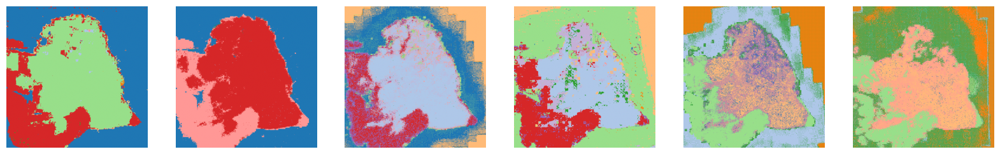

In [44]:
import seaborn as sns
extended = sns.color_palette('tab20') + sns.color_palette('tab20b') + sns.color_palette('tab20c')
fig, axs = plt.subplots(ncols=len(slice_embs), figsize=(20, 5))
for i, d in enumerate(slice_embs):
    ax = axs[i]
    x = d['clusters']
    rgb = utils.display_labeled_as_rgb(x, cmap=extended)
    ax.imshow(rgb)
    ax.axis('off')

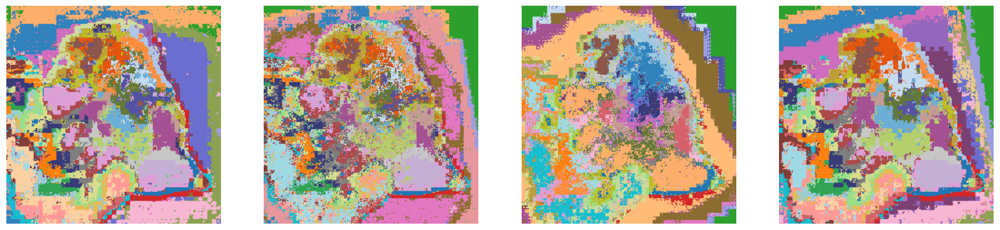

In [292]:
extended = sns.color_palette('tab20') + sns.color_palette('tab20b') + sns.color_palette('tab20c')
fig, axs = plt.subplots(ncols=len(slice_embs), figsize=(20, 5))
for i, d in enumerate(slice_embs):
    ax = axs[i]
    x = d['clusters']
    rgb = display_labeled_as_rgb(x, cmap=extended)
    ax.imshow(rgb)
    ax.axis('off')

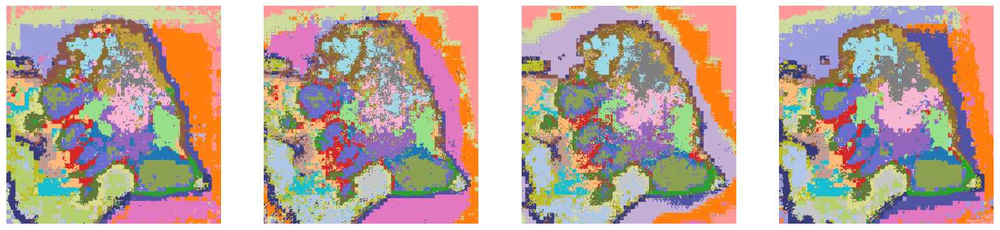

In [270]:
extended = sns.color_palette('tab20') + sns.color_palette('tab20b') + sns.color_palette('tab20c')
fig, axs = plt.subplots(ncols=len(slice_embs), figsize=(20, 5))
for i, d in enumerate(slice_embs):
    ax = axs[i]
    x = d['clusters']
    rgb = display_labeled_as_rgb(x, cmap=extended)
    ax.imshow(rgb)
    ax.axis('off')

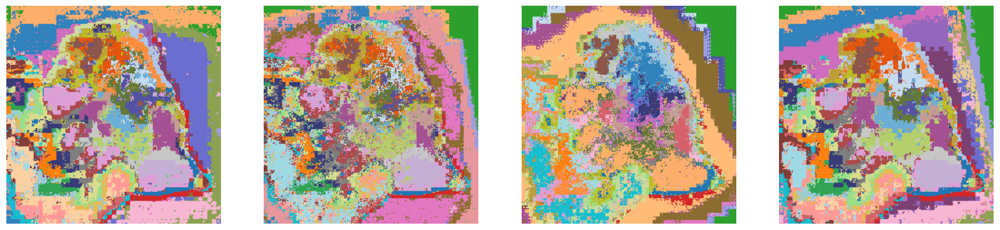

In [847]:
extended = sns.color_palette('tab20') + sns.color_palette('tab20b') + sns.color_palette('tab20c')
fig, axs = plt.subplots(ncols=len(slice_embs), figsize=(20, 5))
for i, d in enumerate(slice_embs):
    ax = axs[i]
    x = d['clusters']
    rgb = display_labeled_as_rgb(x, cmap=extended)
    ax.imshow(rgb)
    ax.axis('off')

In [282]:
len(slice_embs)

4

In [293]:
result_dir = os.path.join(run_dir, 'results')
Path(result_dir).mkdir(parents=True, exist_ok=True)

In [294]:
meta = json.load(open('/data/estorrs/mushroom/data/test_registration/HT397B1_v2/registered/metadata.json'))
meta

{'downsample_scaler': 0.1,
 'phenocycler_pixels_per_micron': 1.9604911906033102,
 'order': ['HT397B1-S1H3A1U1',
  'HT397B1-S1H3A1U2',
  'HT397B1-S1H3A1U12',
  'HT397B1-S1H3A1U21',
  'HT397B1-S1H3A1U22',
  'HT397B1-S1H3A1U31'],
 'data_type': ['visium', 'codex', 'codex', 'visium', 'codex', 'codex'],
 'slices': ['s0', 's1', 's2', 's3', 's4', 's5']}

In [295]:
slice_dict = {
    1: slice_embs[0]['clusters'],
    2: slice_embs[1]['clusters'],
    12: slice_embs[2]['clusters'],
    21: slice_embs[3]['clusters']
}

In [296]:
xyz = []
for k, v in slice_dict.items():
    for i in np.arange(0, v.shape[0], 1):
        for j in np.arange(0, v.shape[1], 1):
            xyz.append([j, i, k, v[i, j]])
xyz = np.asarray(xyz)
xyz.shape
np.save(os.path.join(result_dir, f'{n_clusters}kmeans_xyz.npy'), xyz)

Exception in thread SystemMonitor:
Traceback (most recent call last):
  File "/data/estorrs/miniconda3/envs/mushroom/lib/python3.10/threading.py", line 1016, in _bootstrap_inner
    self.run()
  File "/data/estorrs/miniconda3/envs/mushroom/lib/python3.10/threading.py", line 953, in run
    self._target(*self._args, **self._kwargs)
  File "/data/estorrs/miniconda3/envs/mushroom/lib/python3.10/site-packages/wandb/sdk/internal/system/system_monitor.py", line 118, in _start
    asset.start()
  File "/data/estorrs/miniconda3/envs/mushroom/lib/python3.10/site-packages/wandb/sdk/internal/system/assets/cpu.py", line 166, in start
    self.metrics_monitor.start()
  File "/data/estorrs/miniconda3/envs/mushroom/lib/python3.10/site-packages/wandb/sdk/internal/system/assets/interfaces.py", line 168, in start
    logger.info(f"Started {self._process.name}")
AttributeError: 'NoneType' object has no attribute 'name'


In [275]:
result_dir

'/data/estorrs/mushroom/data/slice_clustering/slice_clusterer/slice_clusterer_v1/results'

In [767]:
z_scaler = (240 / 15000) * 20.
z_scaler

0.32

In [849]:
xyz = np.load(os.path.join(result_dir, f'20kmeans_xyz.npy'))

In [858]:
def cluster_pt_clouds(pts, clusters, collapse_z=True, eps=.01, alpha=.25):
    pts = pts.astype(np.float32)
    init_z = pts[:, 2].copy()
    if collapse_z:
        mapping = {x:i for i, x in enumerate(np.unique(pts[:, 2]))}
        r_mapping = {v:k for k, v in mapping.items()}
        pts[:, 2] = [mapping[x] for x in pts[:, 2]]
    scaler = pts.max()
    pts /= scaler
    
    mesh_dict = {}
    for c in np.unique(clusters):
#     for c in [11]:
        mesh_dict[c] = {}
        filtered = pts[clusters==c]
        clustering = DBSCAN(eps=eps)
        groups = clustering.fit_predict(filtered)
        print(c, np.unique(groups))
        filtered *= scaler
        filtered[:, 2] = init_z[clusters==c] # transform back
        for g in np.unique(groups):
            if g >= 0:
                print(c, g)
                group_pts = filtered[groups==g]
                print(np.unique(group_pts[:, -1]))
                
#                 fig = plt.figure()
#                 ax = fig.add_subplot(111, projection="3d")
#                 ax.scatter(group_pts[:, 0], group_pts[:, 1], group_pts[:, 2])
#                 plt.show()
                
                if len(np.unique(group_pts[:, 2])) >= 2:
                    try:
                        mesh = alphashape.alphashape(group_pts, alpha)
                        d = trimesh.exchange.export.export_dict(mesh)
                        d['type'] =  '3d'
                    except:
                        d = {'type': '2d', 'vertices': []}
                else:
                    mesh = alphashape.alphashape(group_pts[:, :-1], 1.)
                    try:
                        x, y = mesh.exterior.xy
                    except AttributeError:
                        if isinstance(mesh, shapely.GeometryCollection):
                            try:
                                x, y = mesh.geoms[0].exterior.xy
                            except IndexError:
                                x, y = [], []
                        elif isinstance(mesh, shapely.MultiPolygon):
                            x, y = mesh.convex_hull.exterior.xy
                        else:
                            x, y = [], []
                    x, y = np.asarray(x), np.asarray(y)
                    coords = np.concatenate(
                        [np.expand_dims(arr, -1) for arr in [x, y, [np.unique(group_pts[:, 2])[0]] * len(x)]],
                        axis=-1)
                    d = {'type': '2d', 'vertices': coords.tolist()}
#                 print(c, g, len(d.get('faces', [])))
                mesh_dict[c][g] = d
    return mesh_dict

In [851]:
import logging
logging.disable()

In [852]:
z_scaled_xyz = xyz.copy().astype(np.float32)
z_scaled_xyz[:, 2] *= z_scaler

0.0 [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31 32]
0.0 0
[0.32 0.64 3.84 6.72]


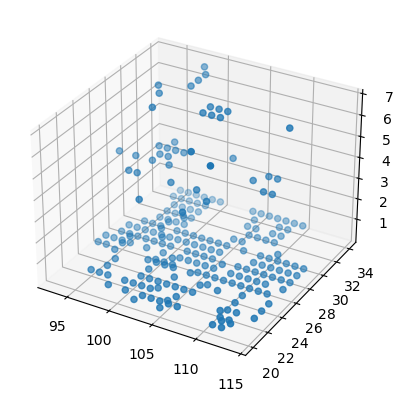

0.0 0 418
0.0 1
[0.32]


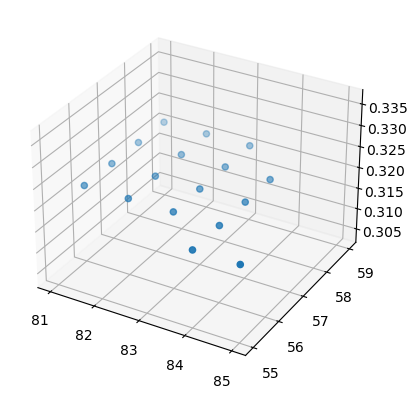

0.0 1 0
0.0 2
[0.32 0.64 3.84 6.72]


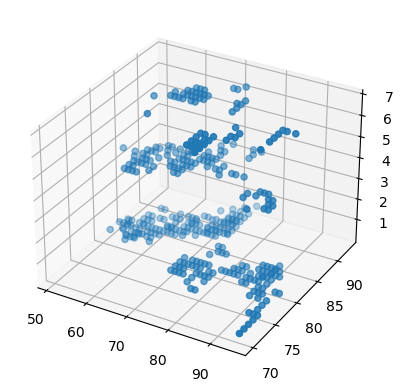

0.0 2 542
0.0 3
[0.32 0.64 3.84 6.72]


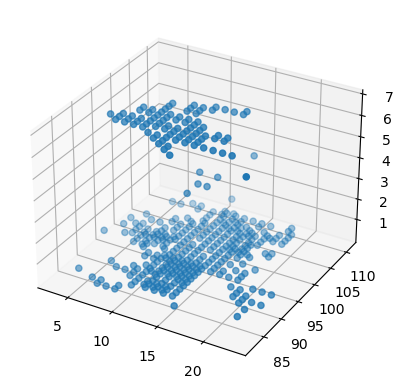

0.0 3 672
0.0 4
[0.32 0.64]


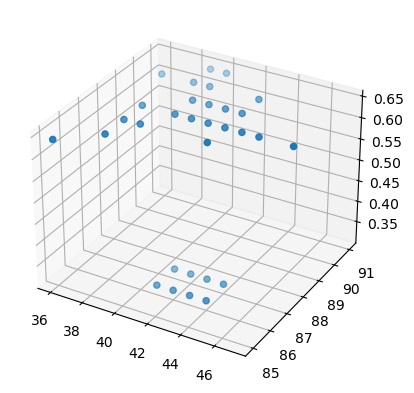

0.0 4 52
0.0 5
[0.32 3.84 6.72]


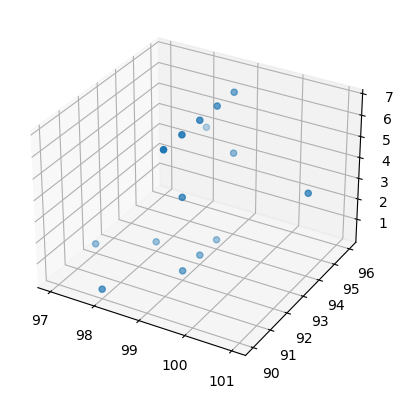

0.0 5 26
0.0 6
[0.32 3.84 6.72]


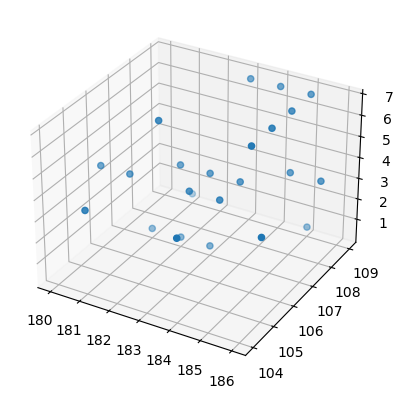

0.0 6 34
0.0 7
[0.32 0.64 3.84 6.72]


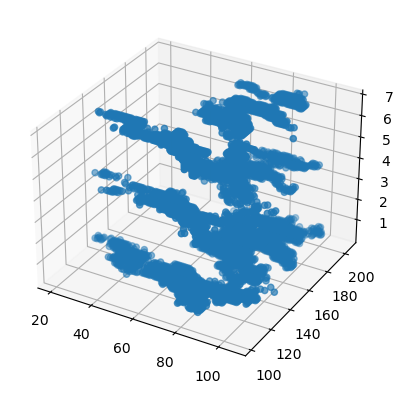

0.0 7 0
0.0 8
[0.32 0.64 3.84 6.72]


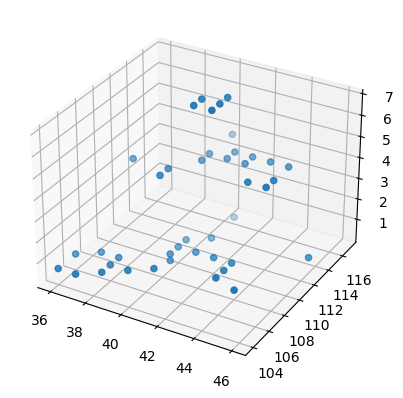

0.0 8 58
0.0 9
[0.32 0.64 3.84 6.72]


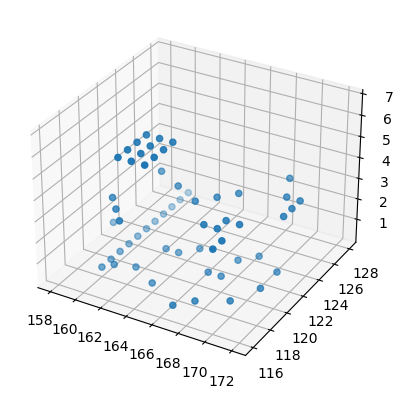

0.0 9 102
0.0 10
[0.32 0.64 3.84 6.72]


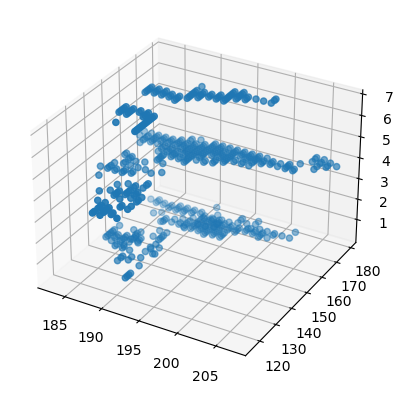

0.0 10 692
0.0 11
[0.32 0.64 6.72]


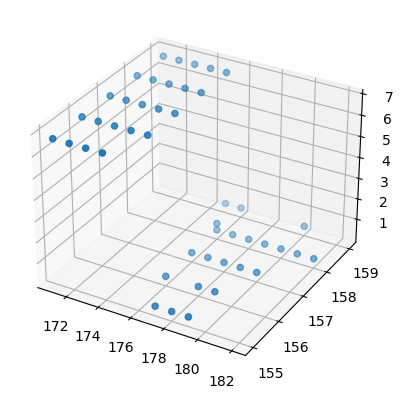

0.0 11 86
0.0 12
[0.32 0.64 3.84 6.72]


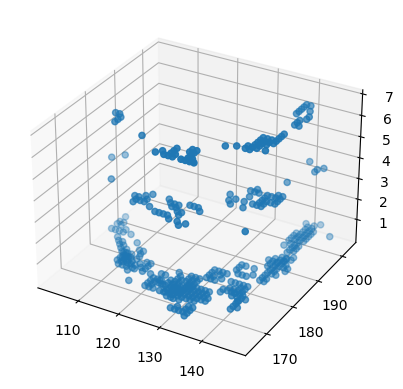

0.0 12 710
0.0 13
[0.64]


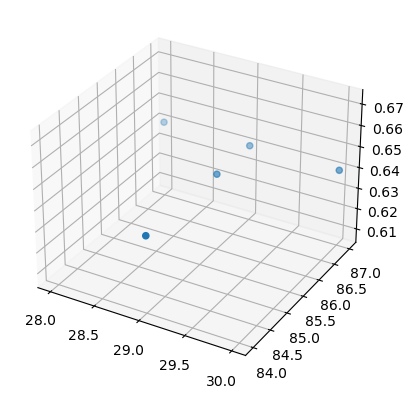

0.0 13 0
0.0 14
[0.64]


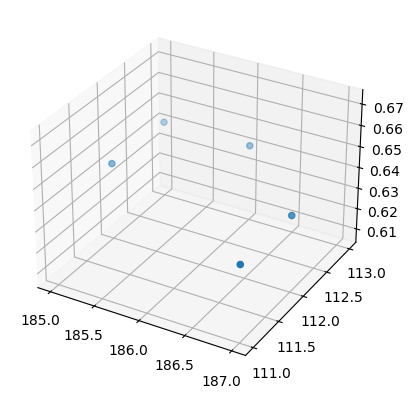

0.0 14 0
0.0 15
[0.64]


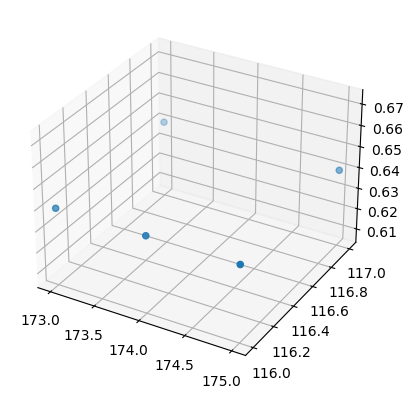

0.0 15 0
0.0 16
[0.64 3.84]


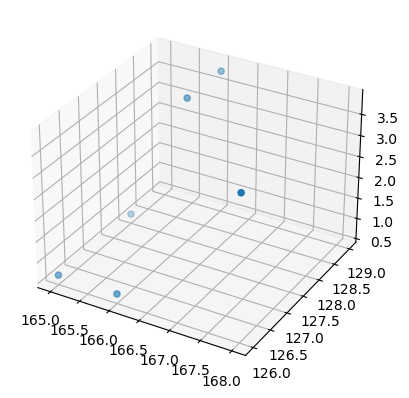

0.0 16 8
0.0 17
[0.64 3.84]


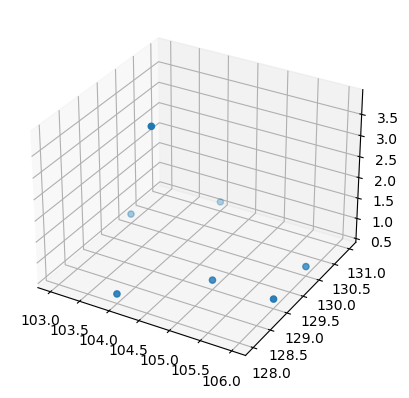

0.0 17 10
0.0 18
[0.64 3.84 6.72]


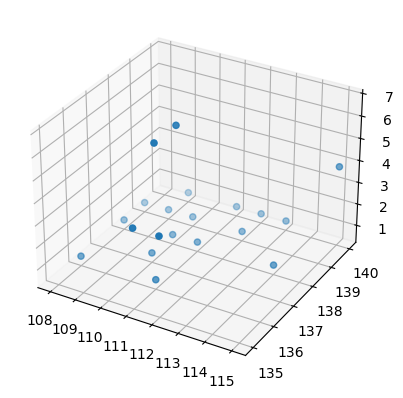

0.0 18 36
0.0 19
[0.64 3.84]


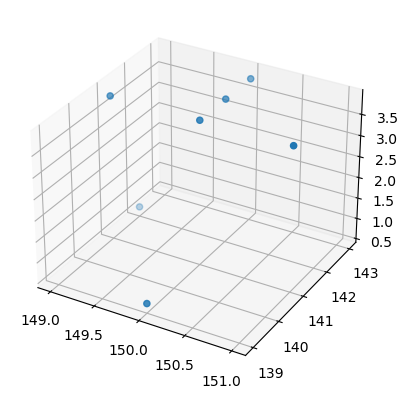

0.0 19 10
0.0 20
[0.64 3.84]


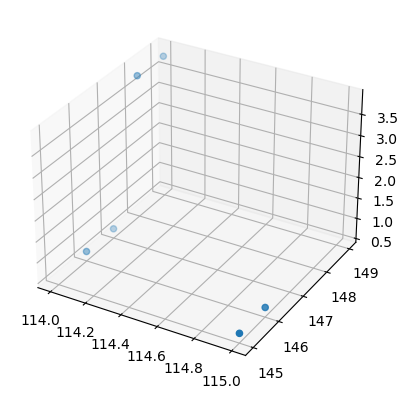

0.0 20 8
0.0 21
[0.64 3.84]


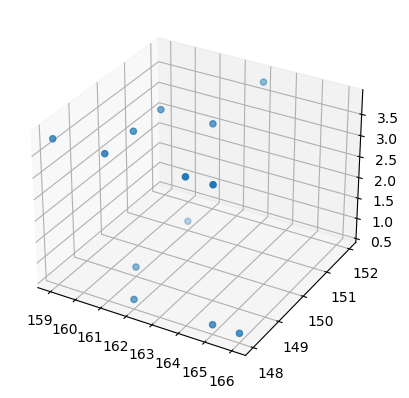

0.0 21 22
0.0 22
[0.64]


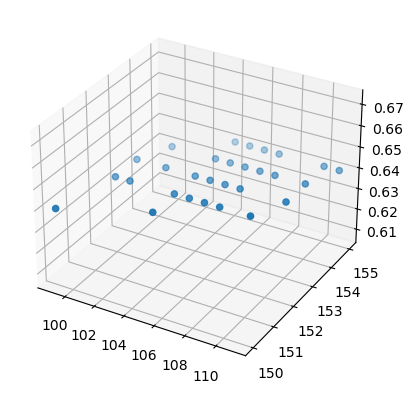

0.0 22 0
0.0 23
[0.64]


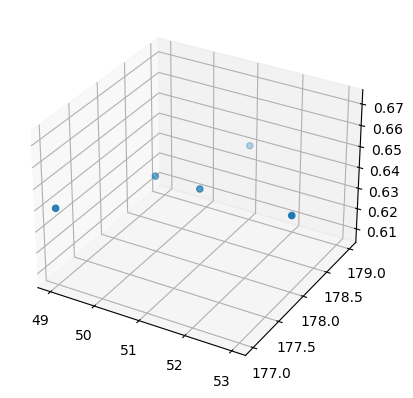

0.0 23 0
0.0 24
[0.64 3.84]


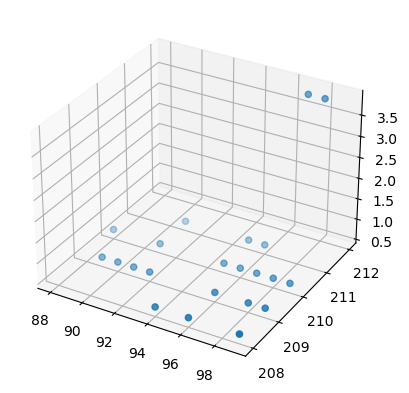

0.0 24 32
0.0 25
[0.64 3.84]


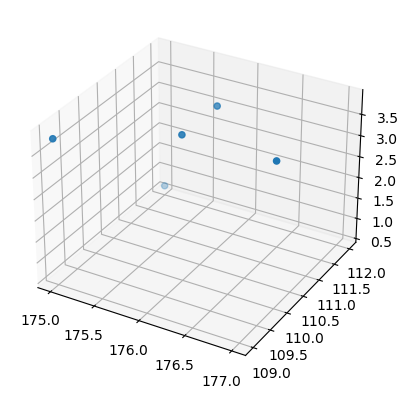

0.0 25 6
0.0 26
[0.64 3.84]


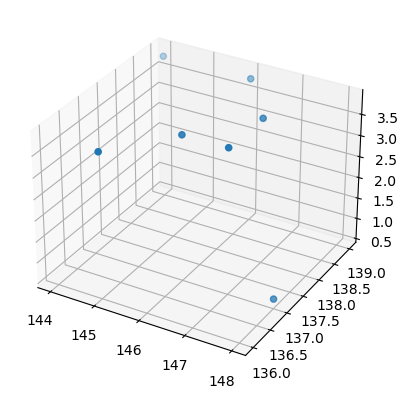

0.0 26 10
0.0 27
[3.84]


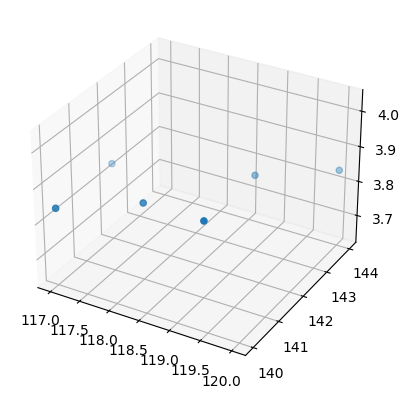

0.0 27 0
0.0 28
[3.84]


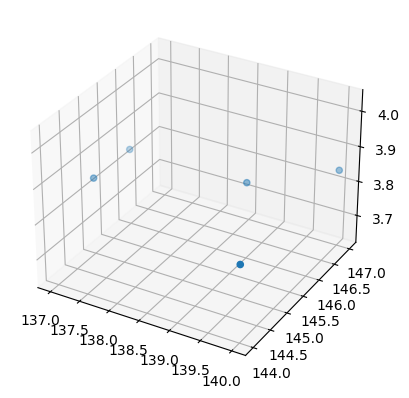

0.0 28 0
0.0 29
[3.84]


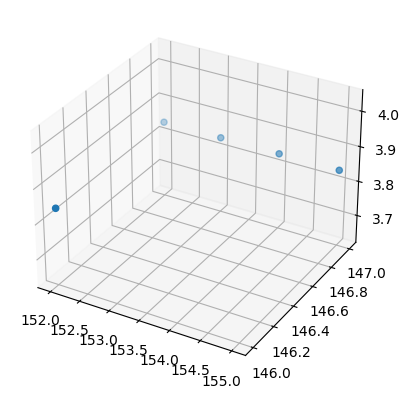

0.0 29 0
0.0 30
[3.84 6.72]


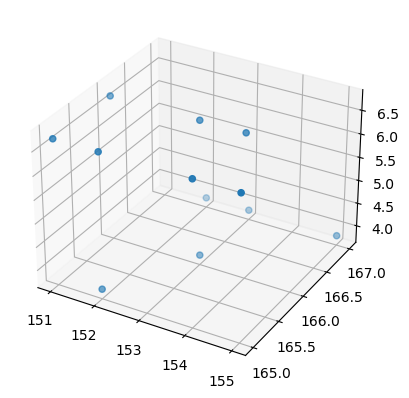

0.0 30 20
0.0 31
[3.84 6.72]


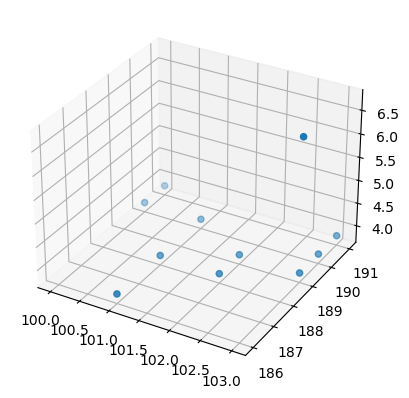

0.0 31 18
0.0 32
[0.64 6.72]


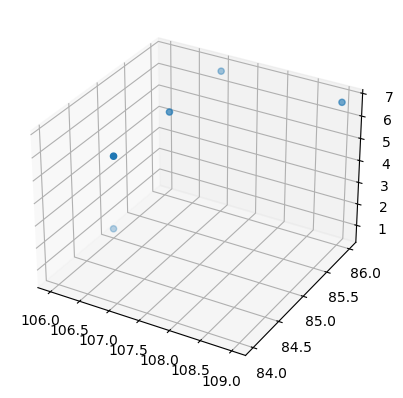

0.0 32 6
1.0 [-1  0  1  2  3  4  5  6  7  8  9 10]
1.0 0
[0.32 0.64 3.84 6.72]


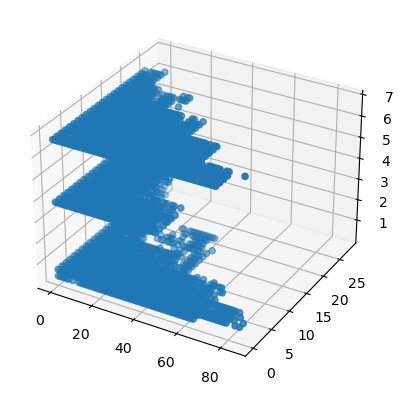

1.0 0 4648
1.0 1
[0.32 0.64 3.84 6.72]


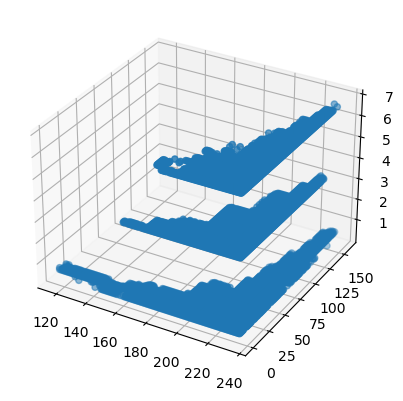

1.0 1 16670
1.0 2
[0.32]


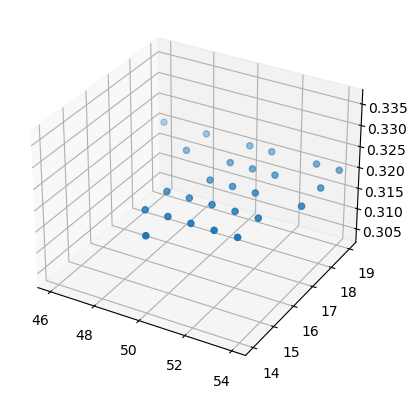

1.0 2 0
1.0 3
[0.32]


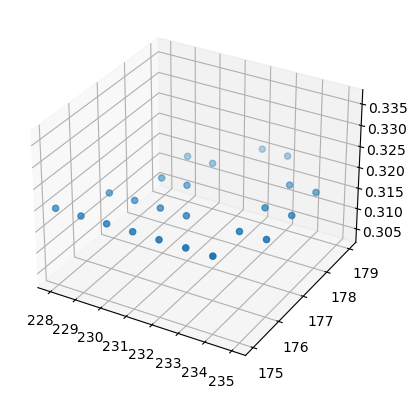

1.0 3 0
1.0 4
[0.32]


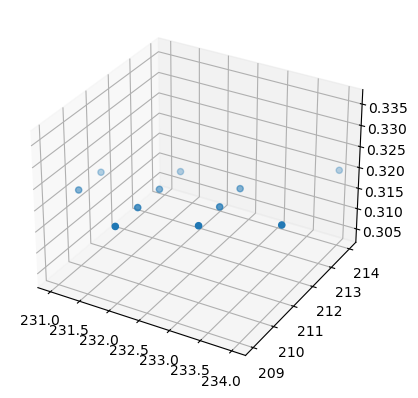

1.0 4 0
1.0 5
[0.32]


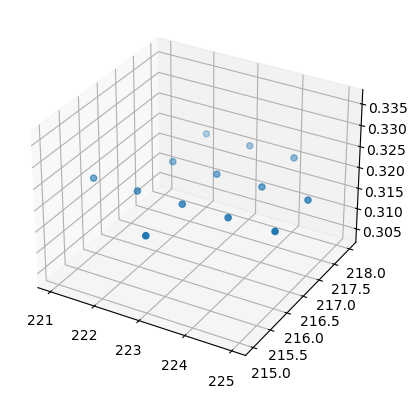

1.0 5 0
1.0 6
[0.32 3.84 6.72]


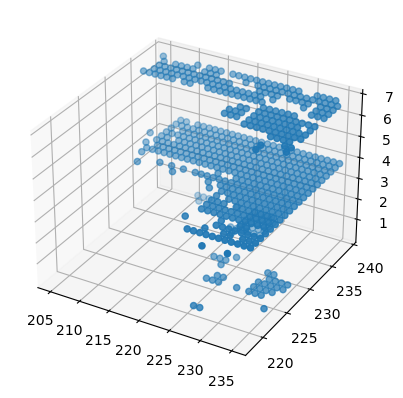

1.0 6 886
1.0 7
[0.32]


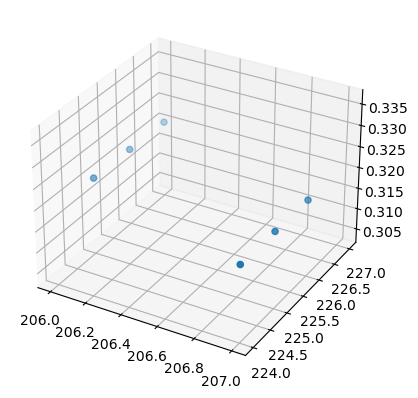

1.0 7 0
1.0 8
[0.32]


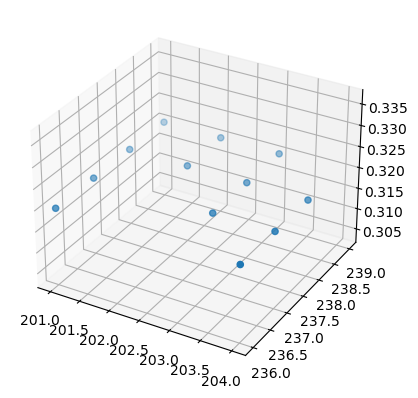

1.0 8 0
1.0 9
[0.64]


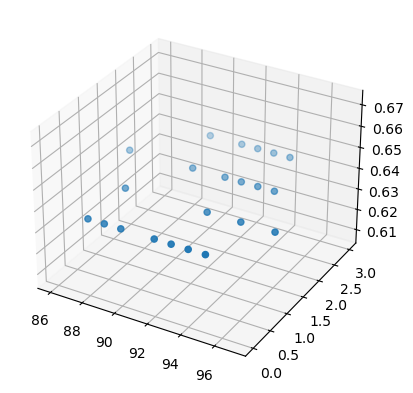

1.0 9 0
1.0 10
[6.72]


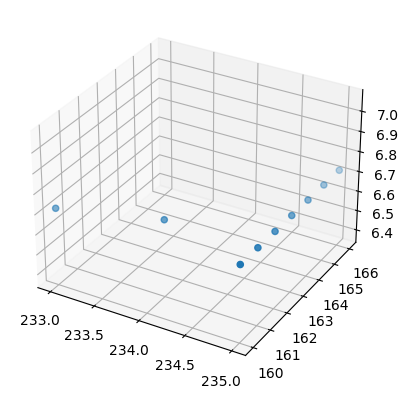

1.0 10 0
2.0 [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31 32]
2.0 0
[0.32 0.64 3.84]


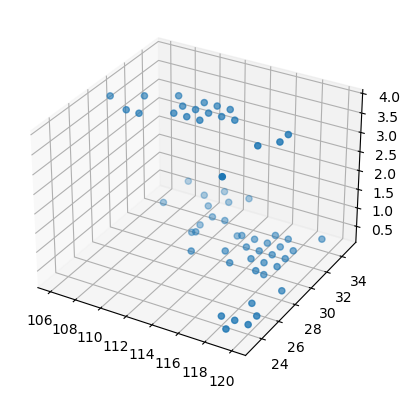

2.0 0 108
2.0 1
[0.32 0.64 3.84]


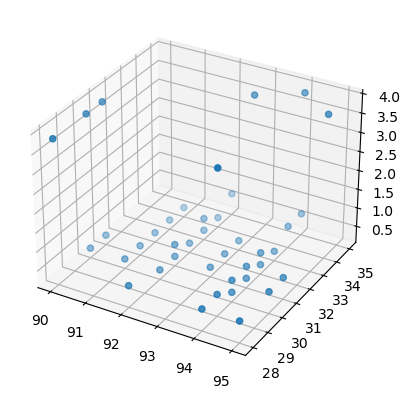

2.0 1 76
2.0 2
[0.32 0.64]


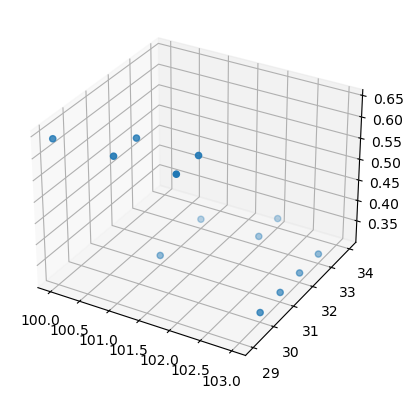

2.0 2 16
2.0 3
[0.32 3.84]


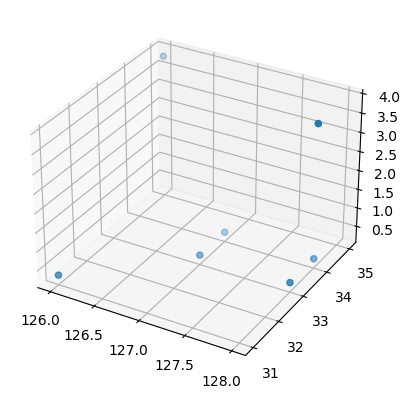

2.0 3 10
2.0 4
[0.32 0.64 3.84 6.72]


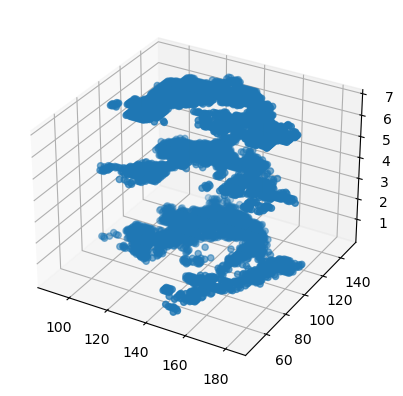

2.0 4 8800
2.0 5
[0.32 0.64]


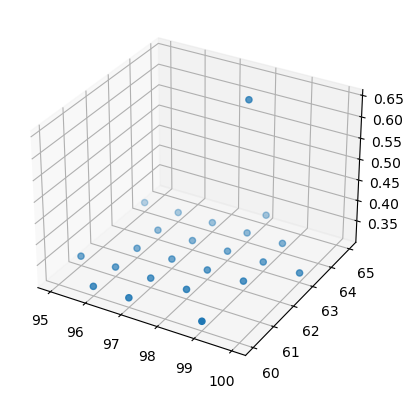

2.0 5 36
2.0 6
[0.32 0.64 3.84]


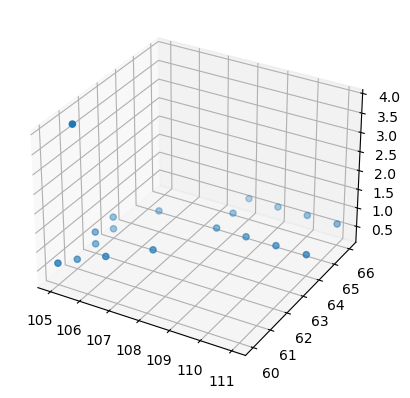

2.0 6 20
2.0 7
[0.32]


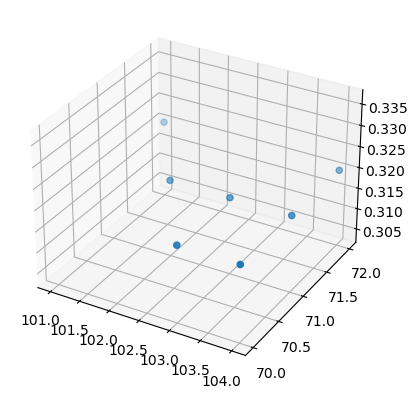

2.0 7 0
2.0 8
[0.32 0.64 3.84 6.72]


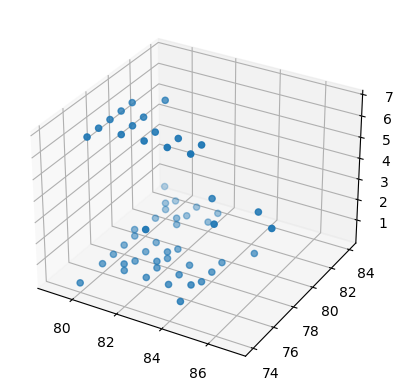

2.0 8 102
2.0 9
[0.32]


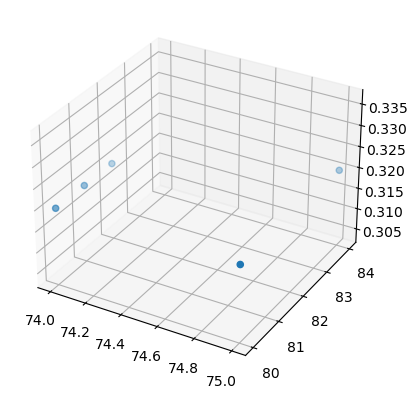

2.0 9 0
2.0 10
[0.32]


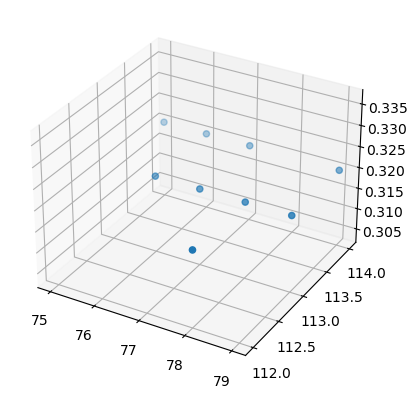

2.0 10 0
2.0 11
[0.32 0.64]


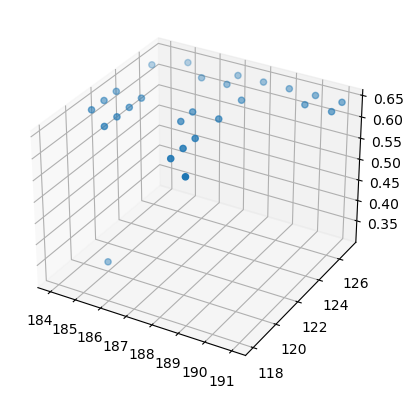

2.0 11 32
2.0 12
[0.32 0.64 3.84 6.72]


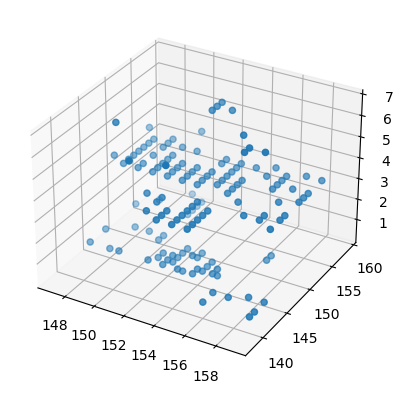

2.0 12 216
2.0 13
[0.32 0.64]


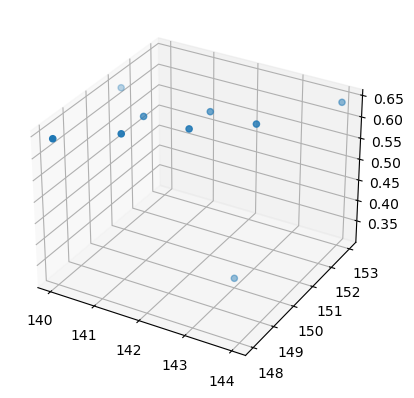

2.0 13 12
2.0 14
[0.32]


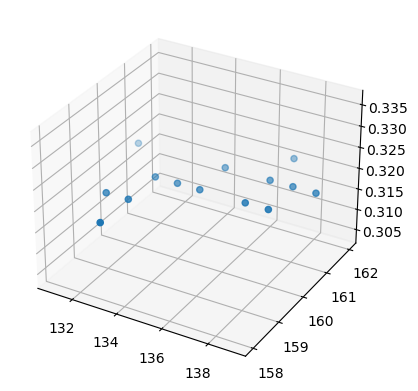

2.0 14 0
2.0 15
[0.32]


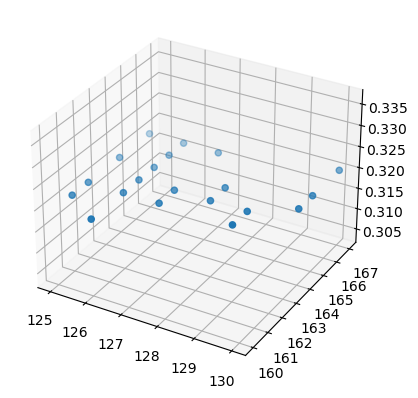

2.0 15 0
2.0 16
[0.32]


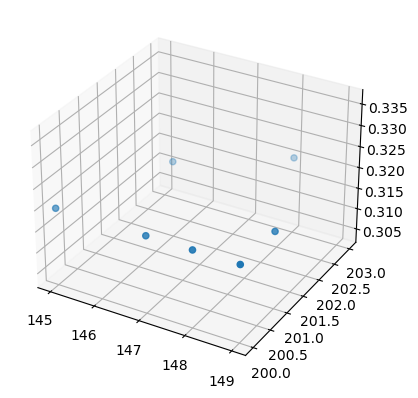

2.0 16 0
2.0 17
[0.32 0.64]


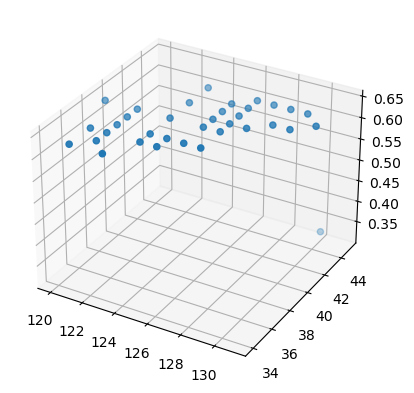

2.0 17 24
2.0 18
[0.64 3.84]


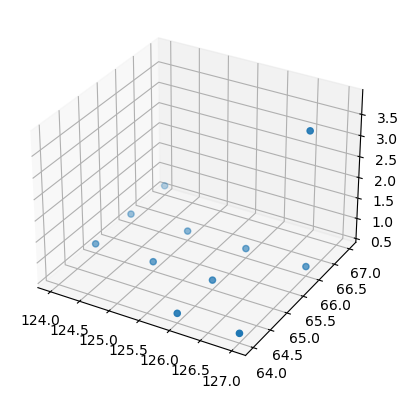

2.0 18 18
2.0 19
[0.64]


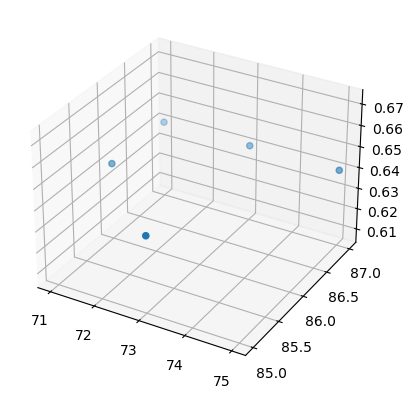

2.0 19 0
2.0 20
[0.64 3.84]


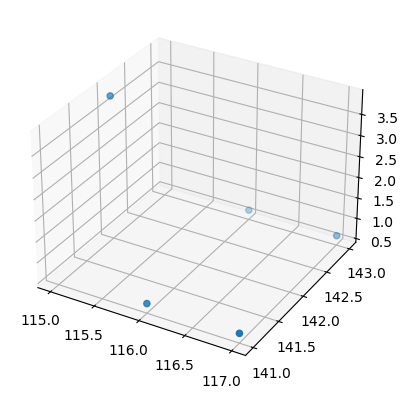

2.0 20 6
2.0 21
[3.84]


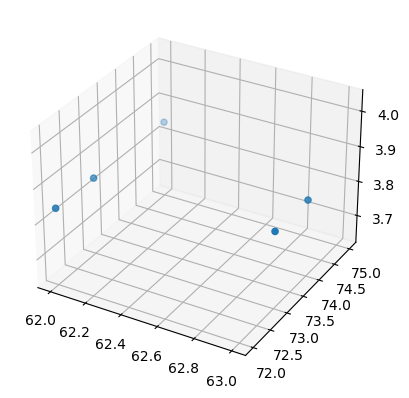

2.0 21 0
2.0 22
[0.64 3.84 6.72]


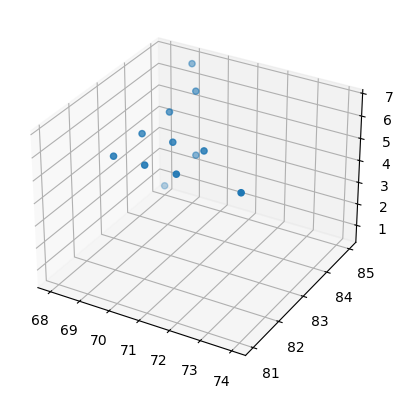

2.0 22 16
2.0 23
[3.84]


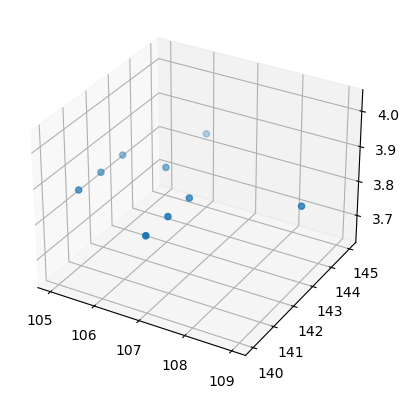

2.0 23 0
2.0 24
[3.84 6.72]


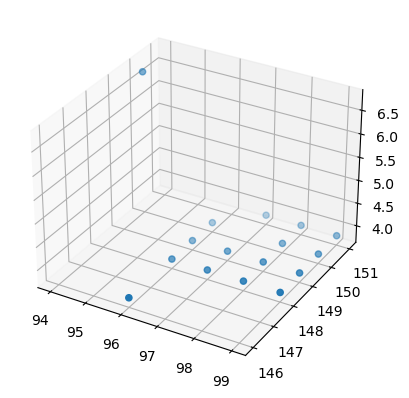

2.0 24 30
2.0 25
[6.72]


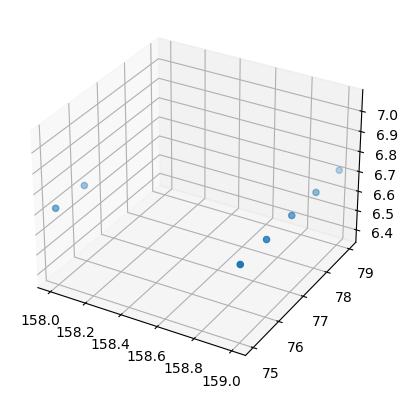

2.0 25 0
2.0 26
[6.72]


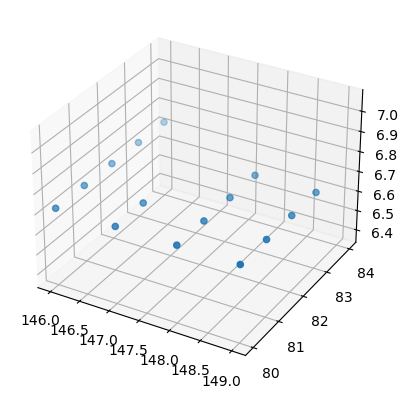

2.0 26 0
2.0 27
[6.72]


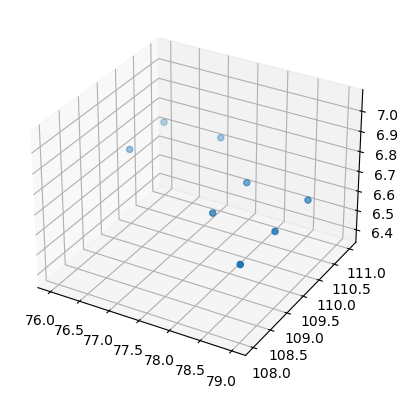

2.0 27 0
2.0 28
[6.72]


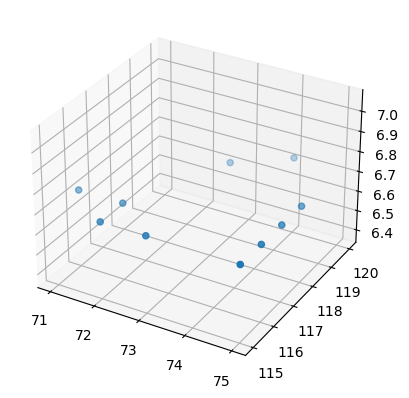

2.0 28 0
2.0 29
[6.72]


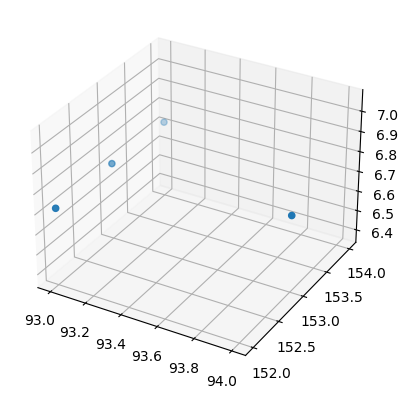

2.0 29 0
2.0 30
[6.72]


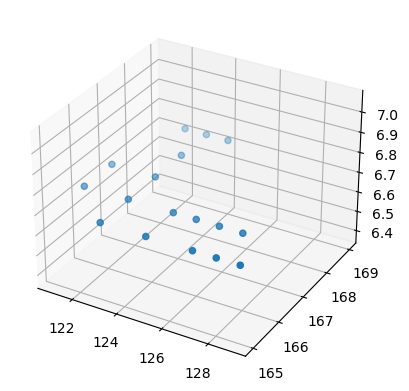

2.0 30 0
2.0 31
[6.72]


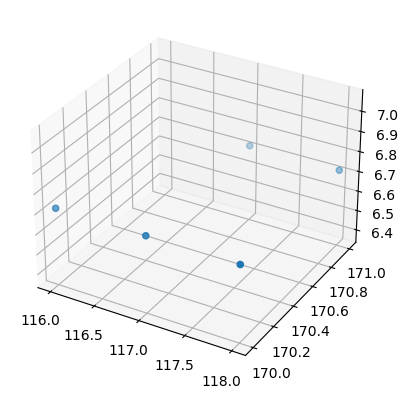

2.0 31 0
2.0 32
[6.72]


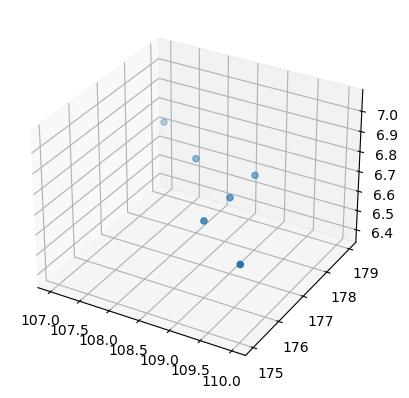

2.0 32 0
3.0 [-1  0  1  2  3  4  5  6  7  8  9]
3.0 0
[0.32 0.64 3.84]


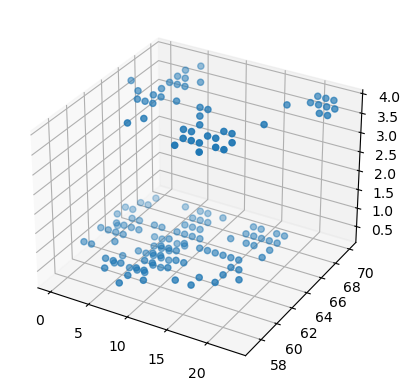

3.0 0 294
3.0 1
[0.32 0.64 3.84 6.72]


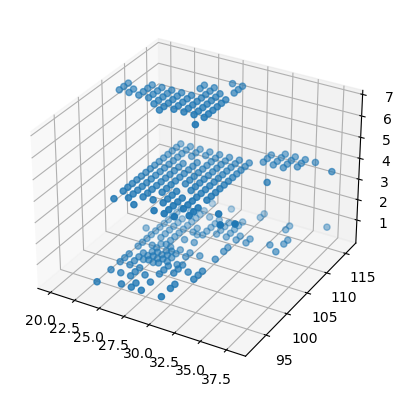

3.0 1 496
3.0 2
[0.32 0.64 3.84 6.72]


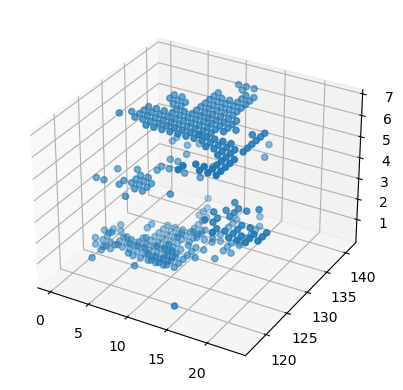

3.0 2 590
3.0 3
[0.32 0.64 3.84 6.72]


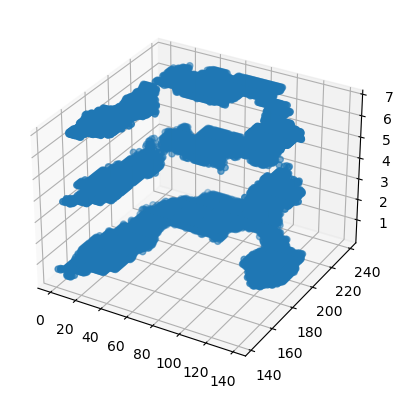

3.0 3 19454
3.0 4
[0.32 0.64 3.84 6.72]


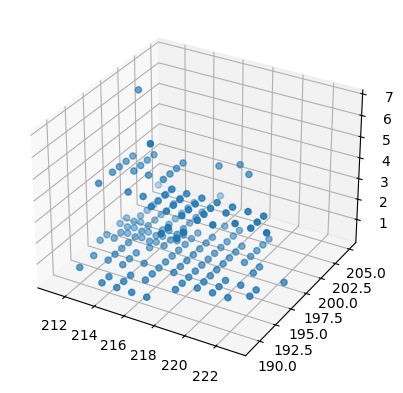

3.0 4 262
3.0 5
[0.64 3.84]


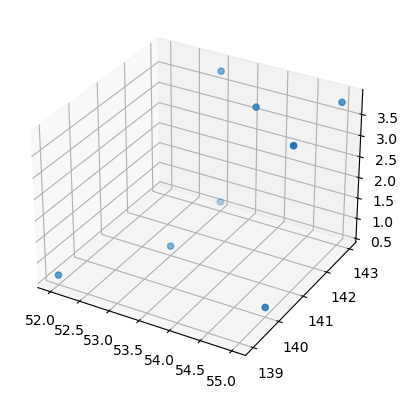

3.0 5 12
3.0 6
[0.64 3.84]


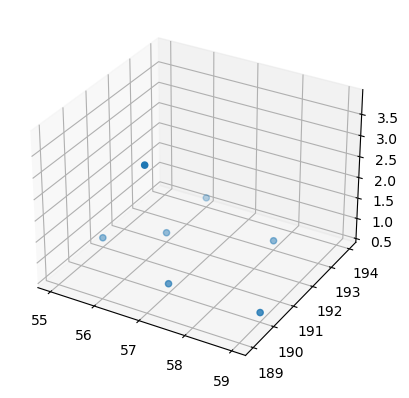

3.0 6 8
3.0 7
[0.64]


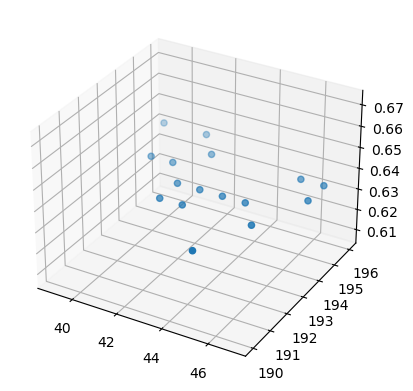

3.0 7 0
3.0 8
[3.84]


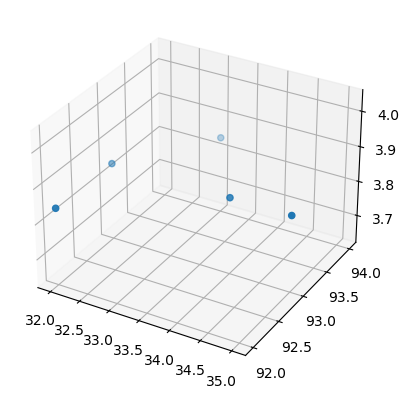

3.0 8 0
3.0 9
[3.84]


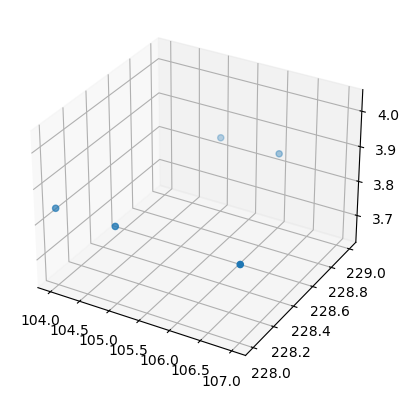

3.0 9 0
4.0 [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
4.0 0
[0.32]


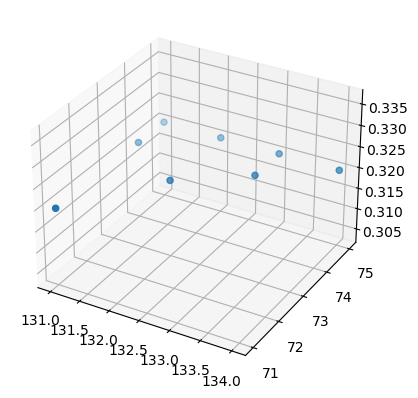

4.0 0 0
4.0 1
[0.32]


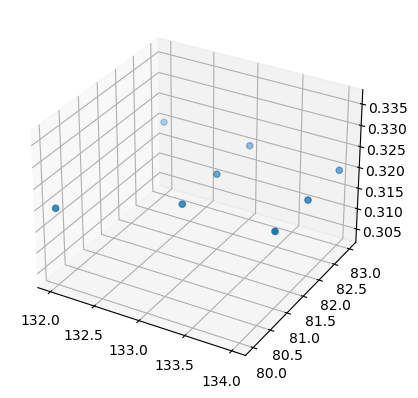

4.0 1 0
4.0 2
[0.32 0.64 3.84 6.72]


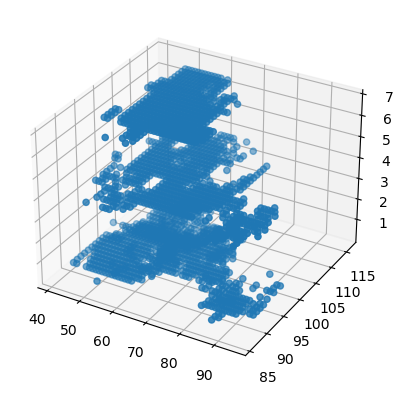

4.0 2 2772
4.0 3
[0.32 3.84]


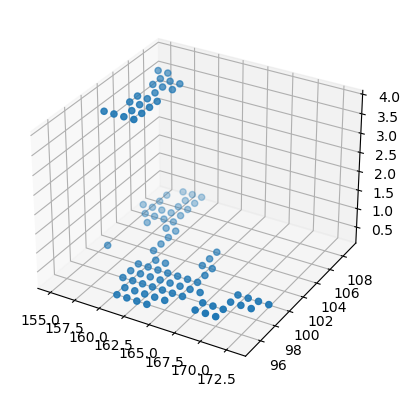

4.0 3 198
4.0 4
[0.32]


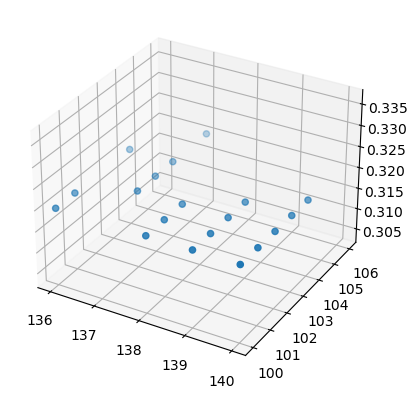

4.0 4 0
4.0 5
[0.32]


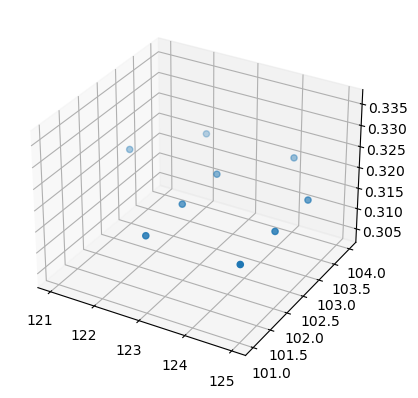

4.0 5 0
4.0 6
[0.32 0.64 3.84 6.72]


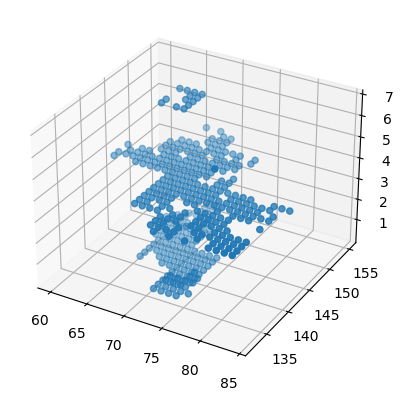

4.0 6 598
4.0 7
[0.32 0.64 3.84 6.72]


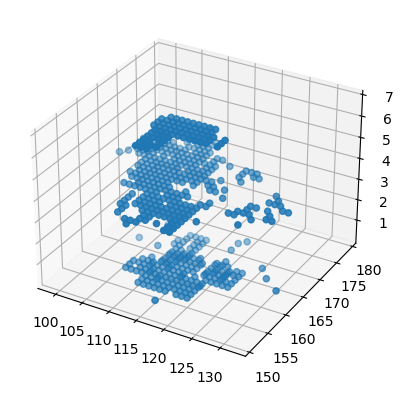

4.0 7 764
4.0 8
[0.32 0.64 3.84 6.72]


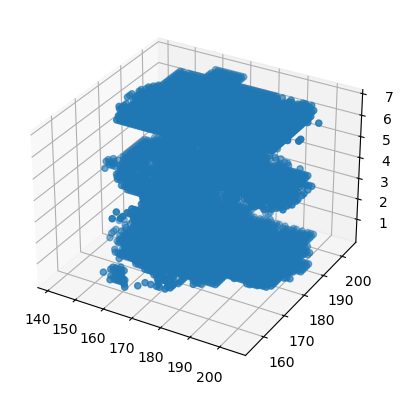

4.0 8 8122
4.0 9
[0.32 3.84 6.72]


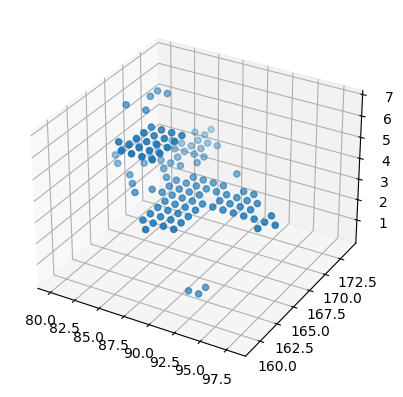

4.0 9 202
4.0 10
[0.32 0.64]


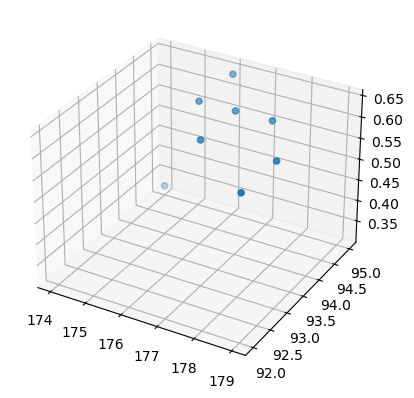

4.0 10 0
4.0 11
[0.64 3.84]


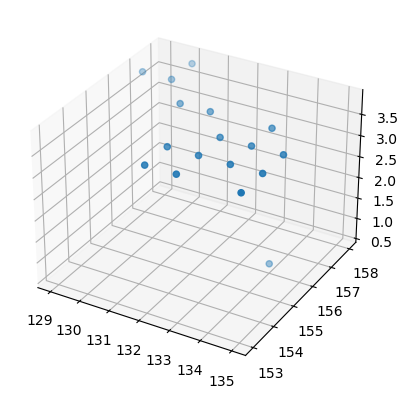

4.0 11 32
4.0 12
[0.64 3.84]


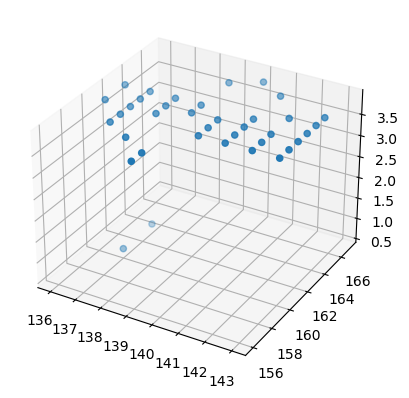

4.0 12 62
4.0 13
[0.64 3.84]


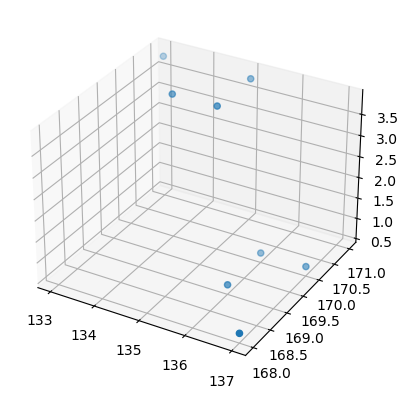

4.0 13 12
4.0 14
[0.64 3.84]


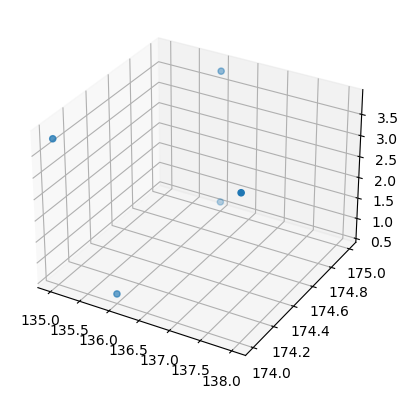

4.0 14 6
4.0 15
[0.32 3.84]


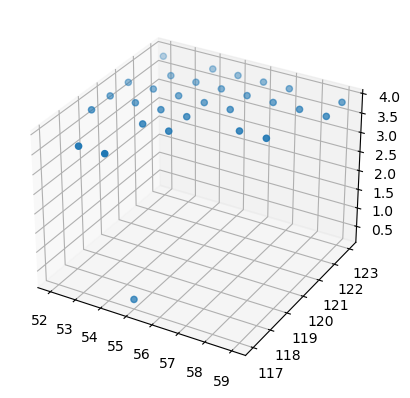

4.0 15 48
4.0 16
[3.84]


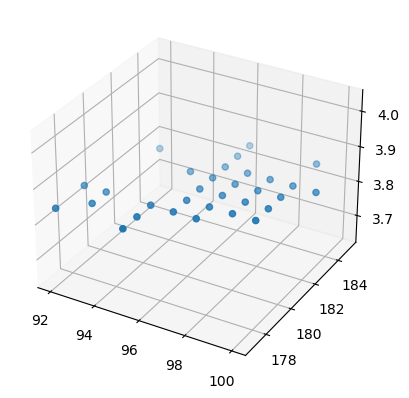

4.0 16 0
4.0 17
[3.84 6.72]


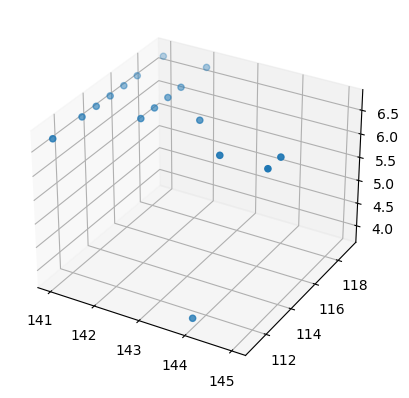

4.0 17 24
4.0 18
[6.72]


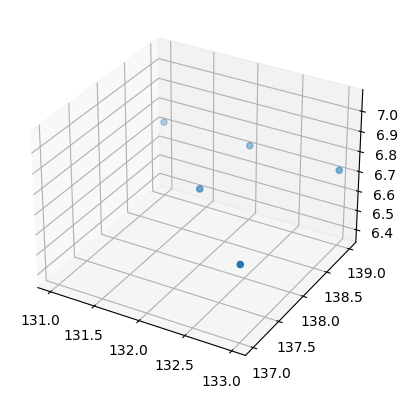

4.0 18 0
5.0 [-1  0  1  2  3  4  5  6  7  8]
5.0 0
[0.32 0.64 6.72]


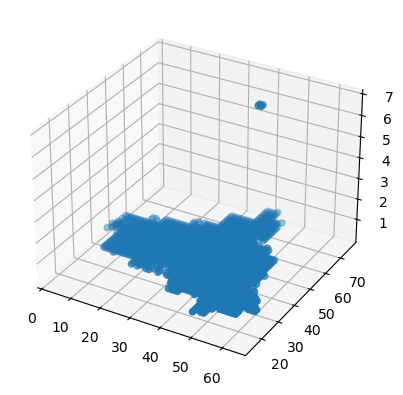

5.0 0 2082
5.0 1
[0.32 0.64 6.72]


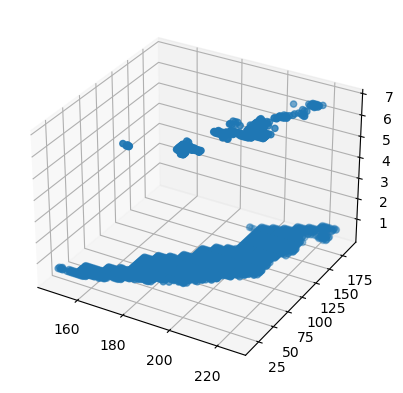

5.0 1 5622
5.0 2
[0.32]


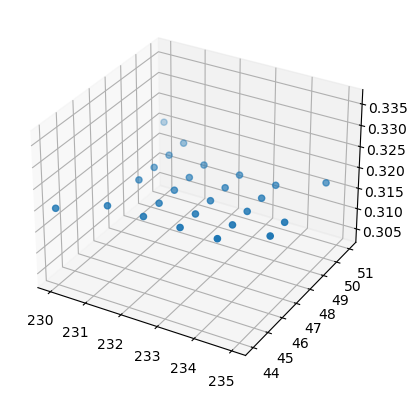

5.0 2 0
5.0 3
[0.32]


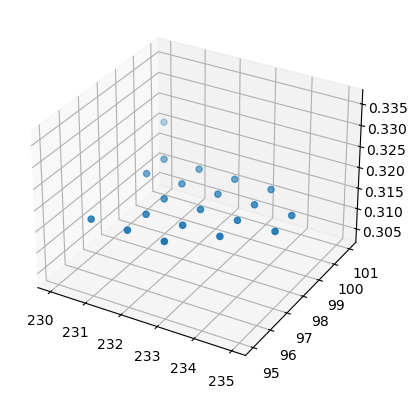

5.0 3 0
5.0 4
[0.32]


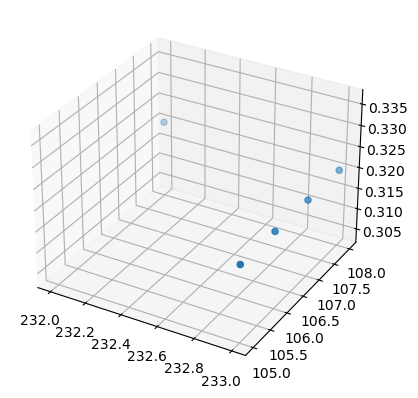

5.0 4 0
5.0 5
[0.32]


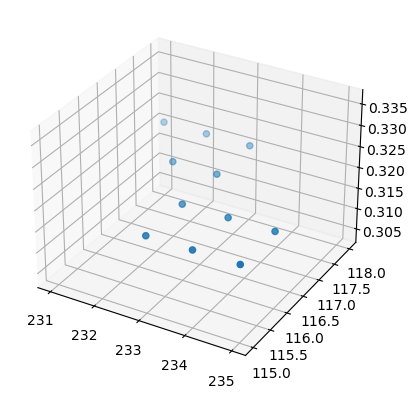

5.0 5 0
5.0 6
[0.32 0.64 3.84 6.72]


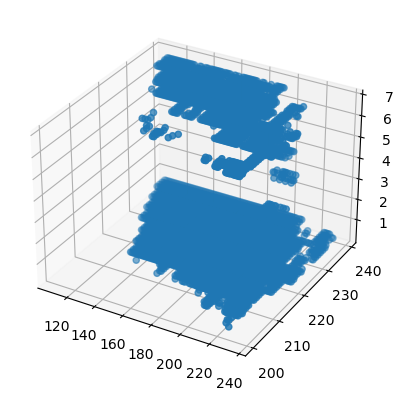

5.0 6 11768
5.0 7
[0.64 6.72]


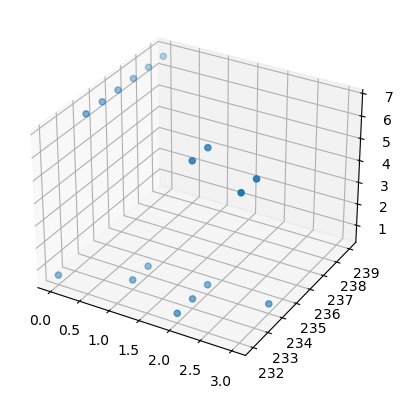

5.0 7 26
5.0 8
[6.72]


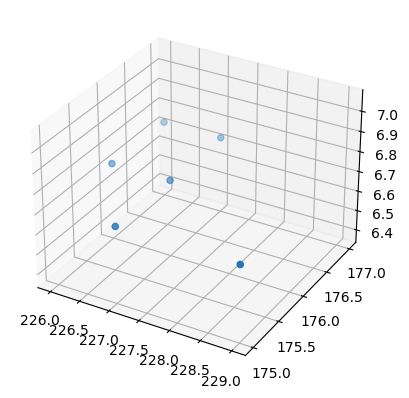

5.0 8 0
6.0 [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22]
6.0 0
[0.32 0.64 3.84 6.72]


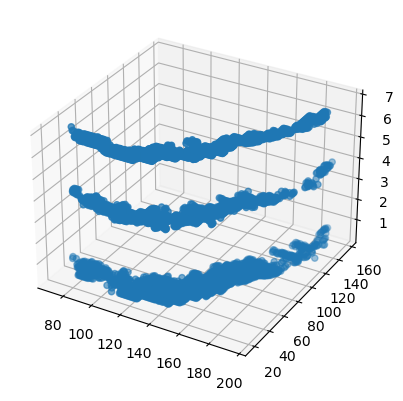

6.0 0 7160
6.0 1
[0.32 0.64 3.84 6.72]


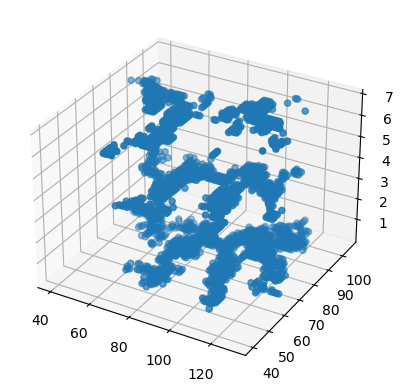

6.0 1 3966
6.0 2
[0.32 3.84 6.72]


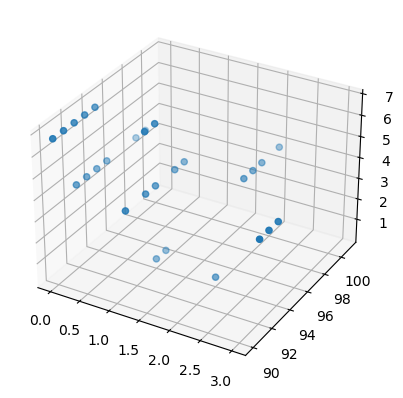

6.0 2 44
6.0 3
[0.32 0.64 3.84 6.72]


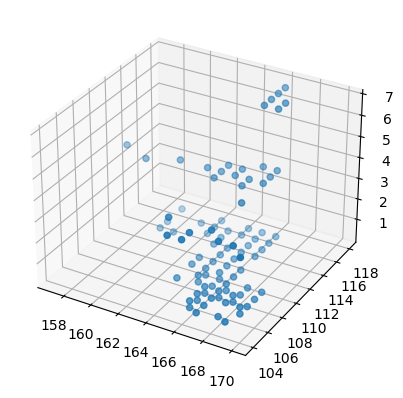

6.0 3 154
6.0 4
[0.32 3.84]


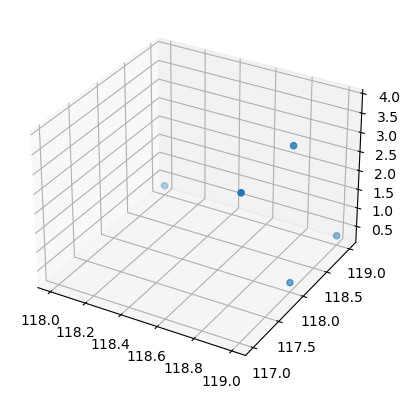

6.0 4 6
6.0 5
[0.32 3.84]


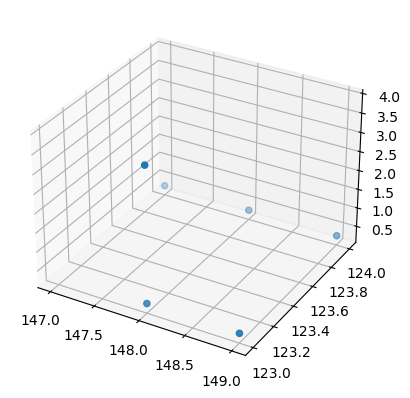

6.0 5 8
6.0 6
[0.32 0.64 3.84 6.72]


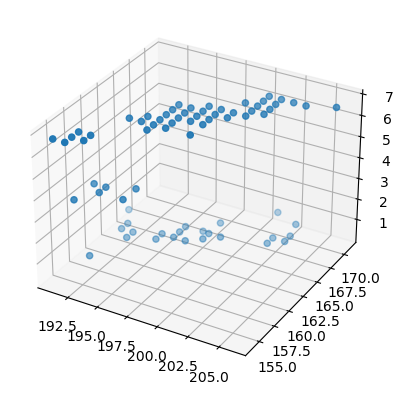

6.0 6 138
6.0 7
[0.32]


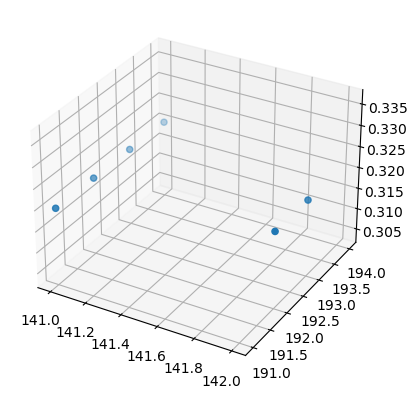

6.0 7 0
6.0 8
[0.64 3.84]


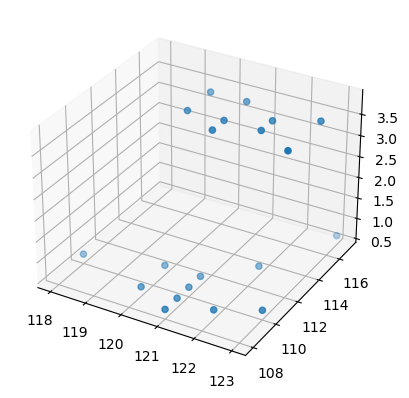

6.0 8 36
6.0 9
[0.64]


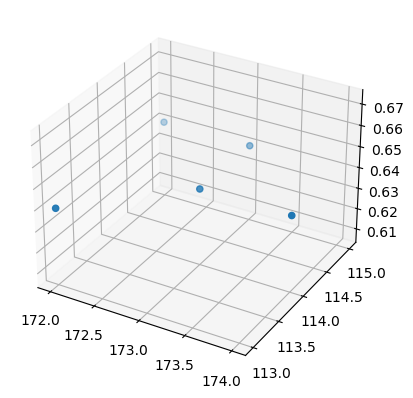

6.0 9 0
6.0 10
[0.64 3.84 6.72]


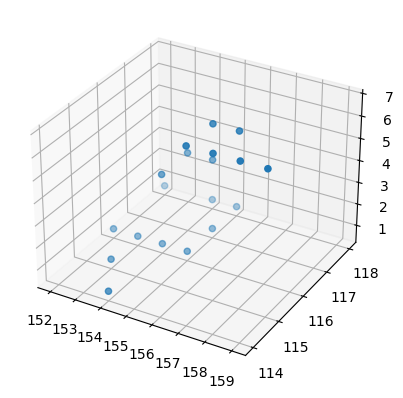

6.0 10 34
6.0 11
[0.64]


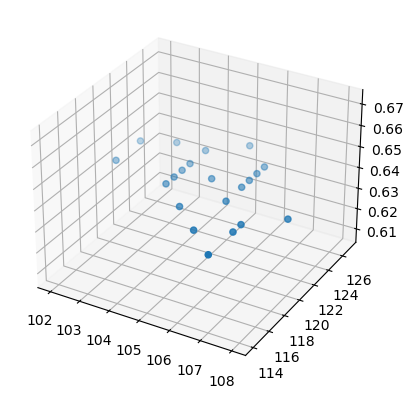

6.0 11 0
6.0 12
[0.64 3.84]


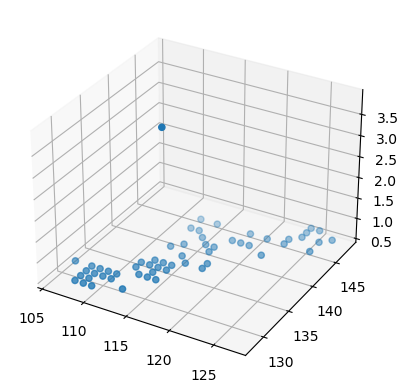

6.0 12 84
6.0 13
[0.64 3.84]


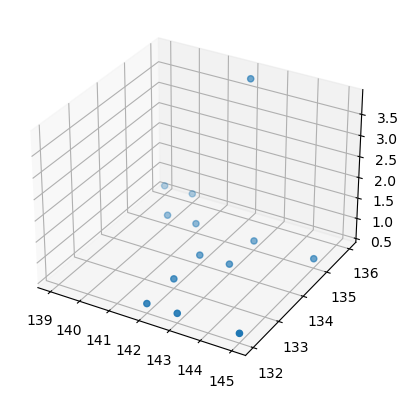

6.0 13 22
6.0 14
[0.32 0.64 3.84 6.72]


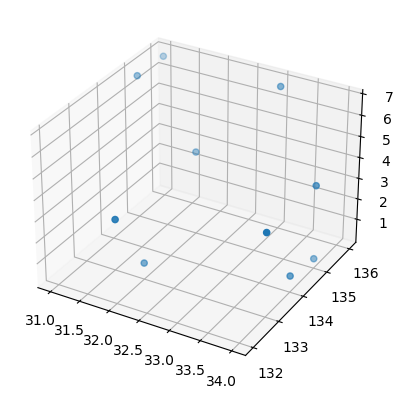

6.0 14 16
6.0 15
[0.64]


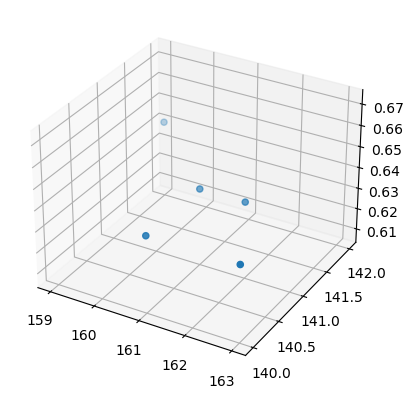

6.0 15 0
6.0 16
[0.64]


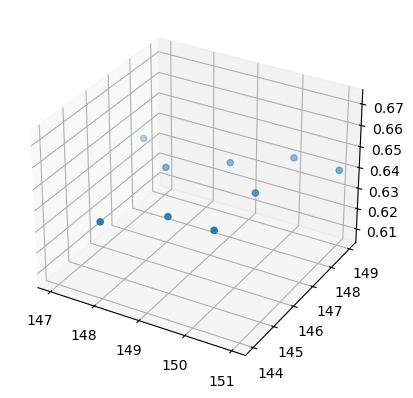

6.0 16 0
6.0 17
[0.64]


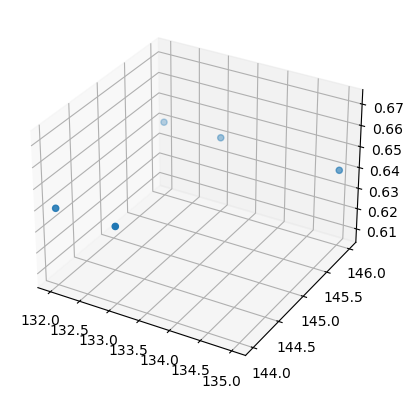

6.0 17 0
6.0 18
[0.64]


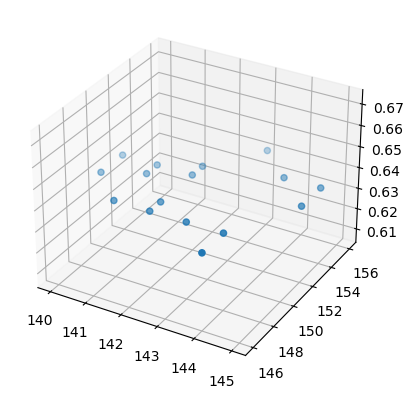

6.0 18 0
6.0 19
[3.84 6.72]


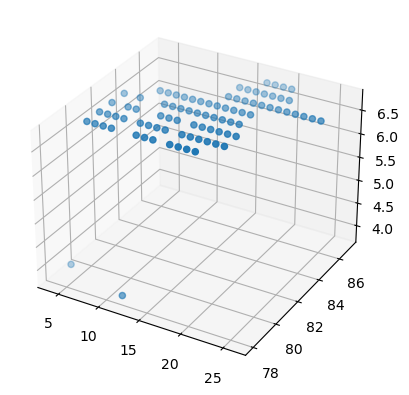

6.0 19 212
6.0 20
[3.84 6.72]


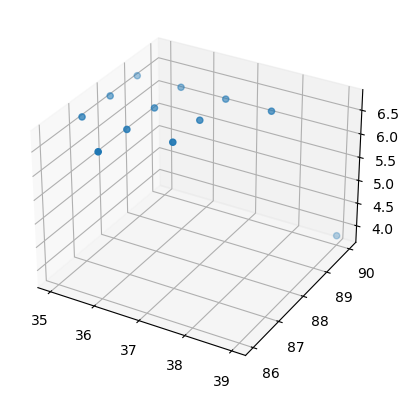

6.0 20 20
6.0 21
[6.72]


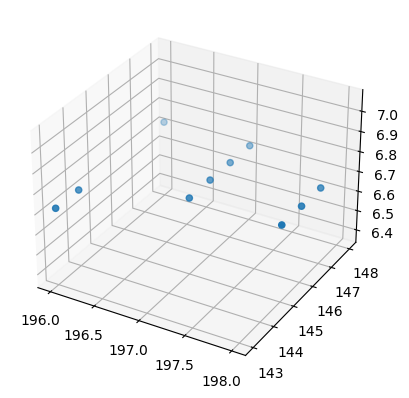

6.0 21 0
6.0 22
[6.72]


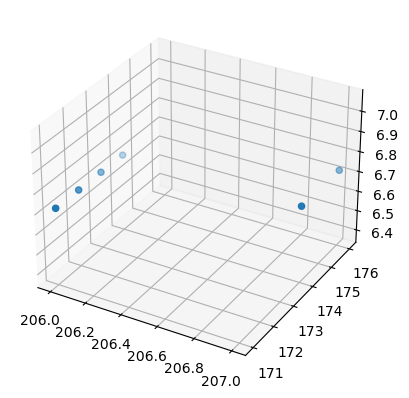

6.0 22 0
7.0 [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
7.0 0
[0.32 0.64 3.84 6.72]


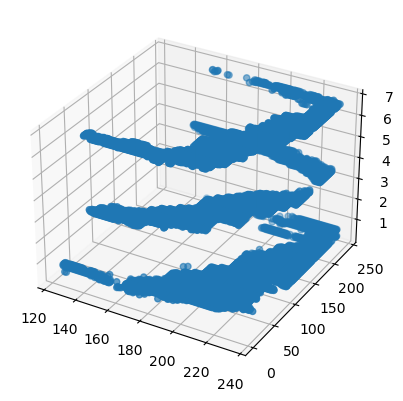

7.0 0 29374
7.0 1
[0.32]


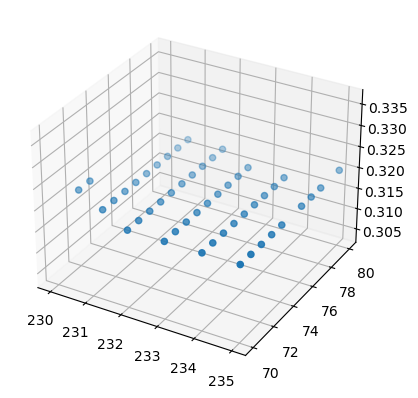

7.0 1 0
7.0 2
[0.32 3.84]


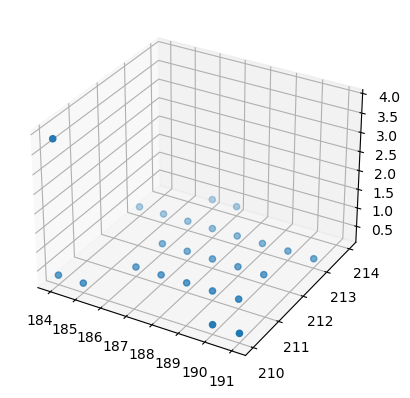

7.0 2 44
7.0 3
[0.32 0.64 3.84 6.72]


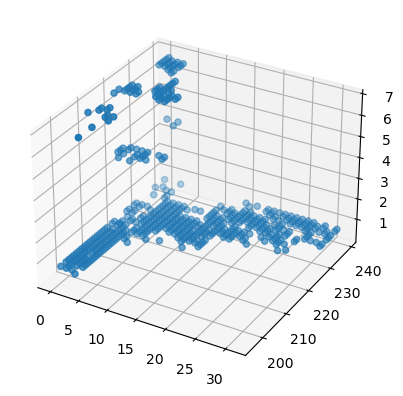

7.0 3 582
7.0 4
[0.32]


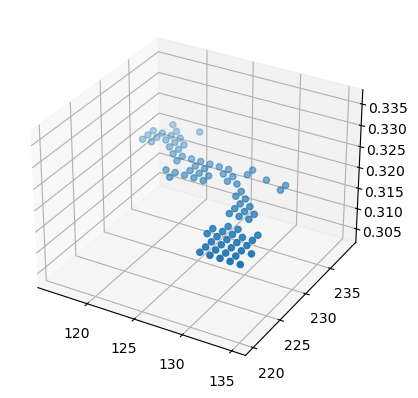

7.0 4 0
7.0 5
[0.64 3.84 6.72]


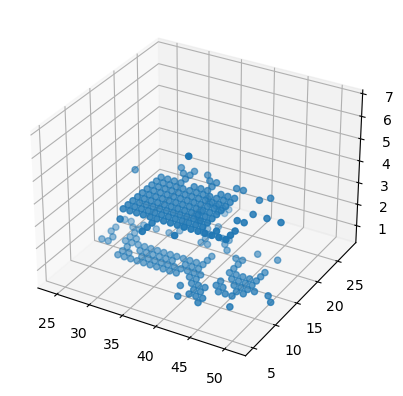

7.0 5 480
7.0 6
[0.64 3.84]


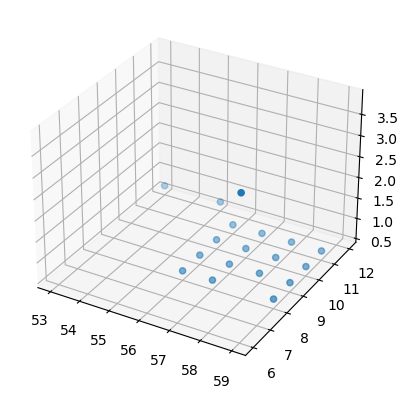

7.0 6 26
7.0 7
[0.64]


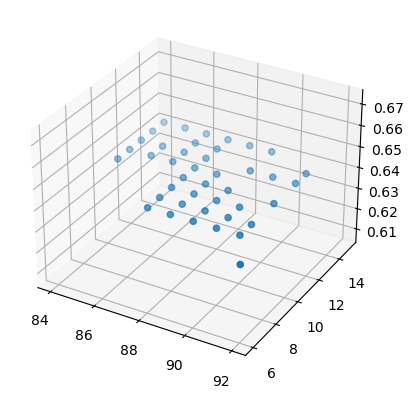

7.0 7 0
7.0 8
[0.64 6.72]


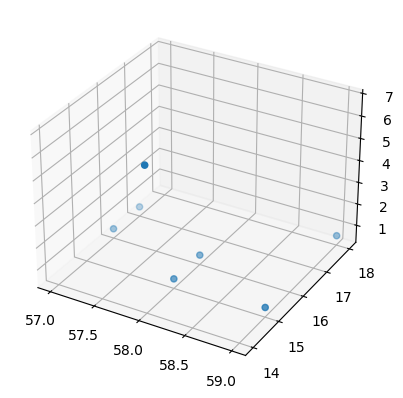

7.0 8 10
7.0 9
[0.64]


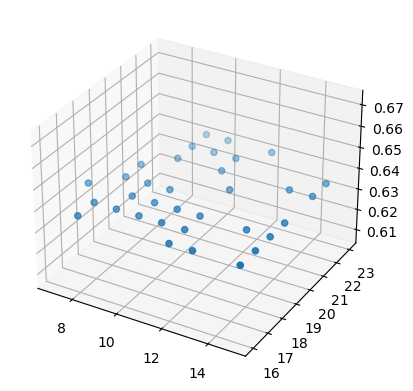

7.0 9 0
7.0 10
[0.64 3.84]


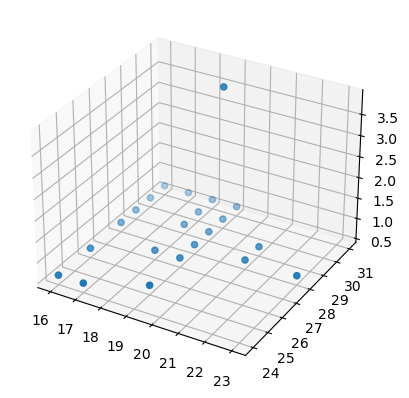

7.0 10 38
7.0 11
[0.64]


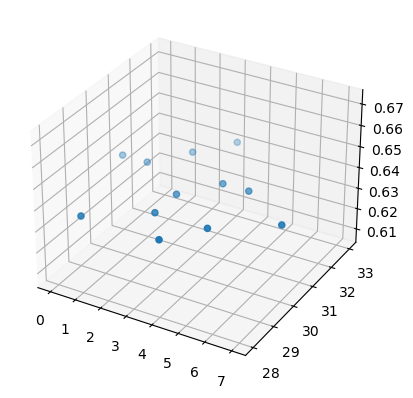

7.0 11 0
7.0 12
[0.64]


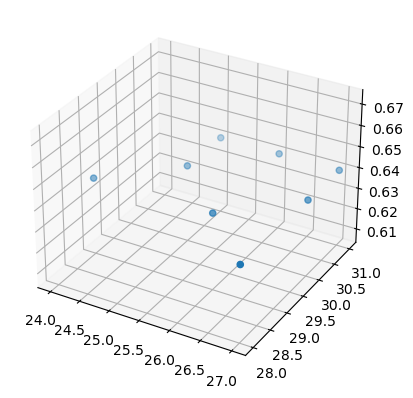

7.0 12 0
7.0 13
[0.32 0.64]


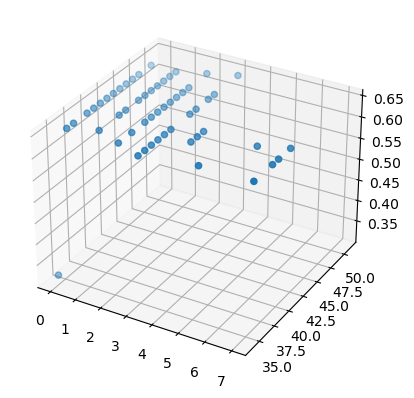

7.0 13 72
7.0 14
[3.84 6.72]


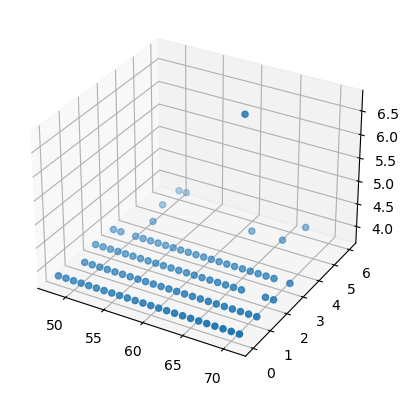

7.0 14 226
7.0 15
[3.84]


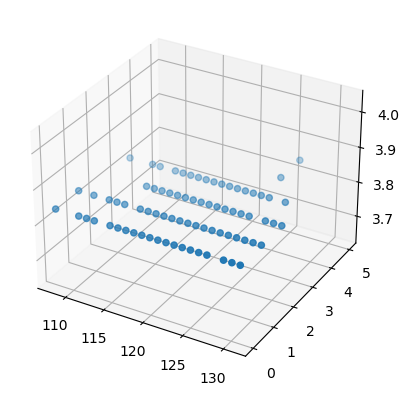

7.0 15 0
7.0 16
[3.84]


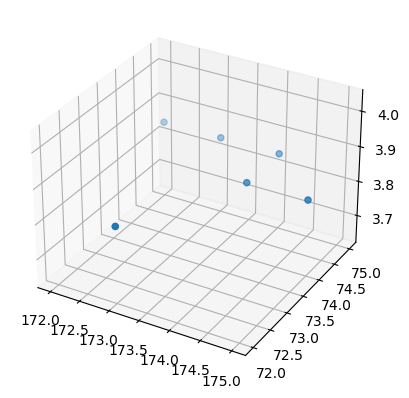

7.0 16 0
7.0 17
[6.72]


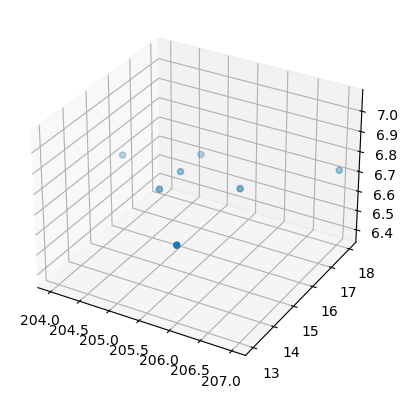

7.0 17 0
7.0 18
[6.72]


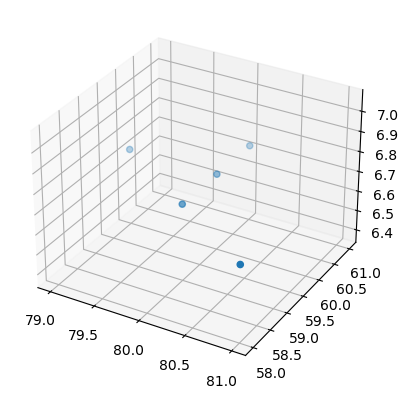

7.0 18 0
7.0 19
[6.72]


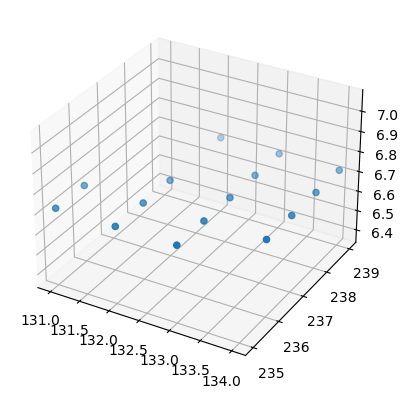

7.0 19 0
8.0 [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15]
8.0 0
[0.32 0.64 3.84 6.72]


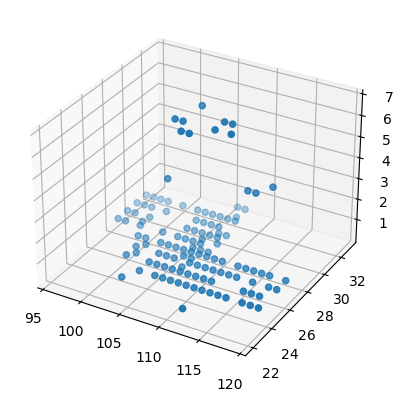

8.0 0 208
8.0 1
[0.32 3.84]


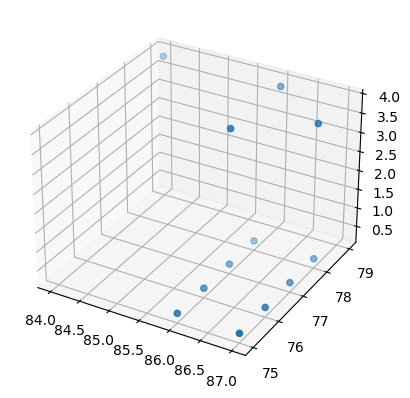

8.0 1 20
8.0 2
[0.32 0.64]


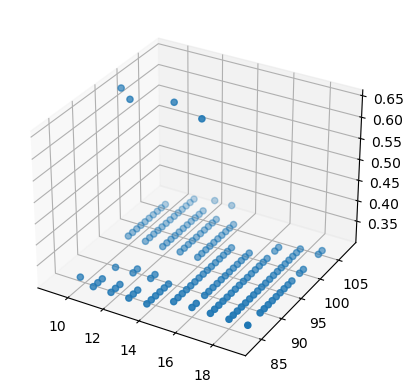

8.0 2 418
8.0 3
[0.32 0.64 3.84 6.72]


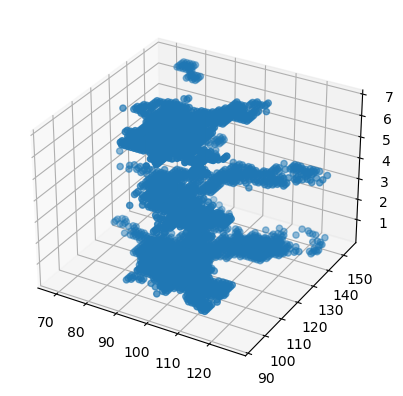

8.0 3 4416
8.0 4
[0.32 0.64 3.84 6.72]


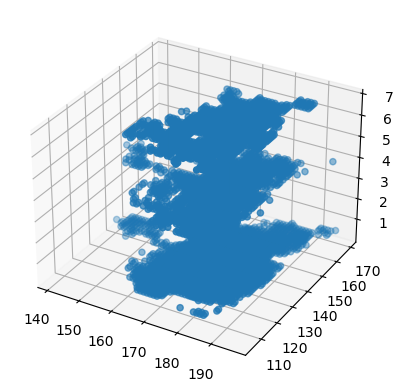

8.0 4 5824
8.0 5
[0.32 3.84 6.72]


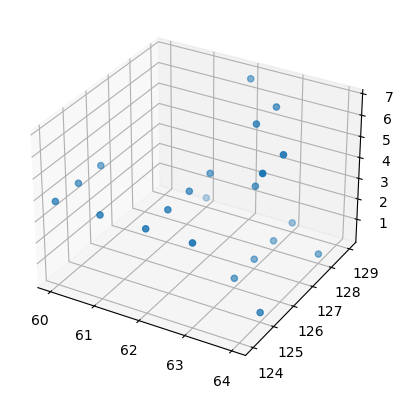

8.0 5 38
8.0 6
[0.32 0.64 3.84 6.72]


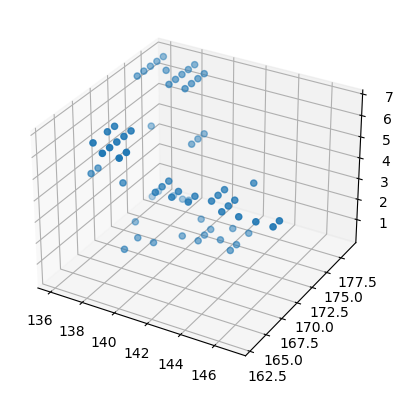

8.0 6 130
8.0 7
[0.64 3.84]


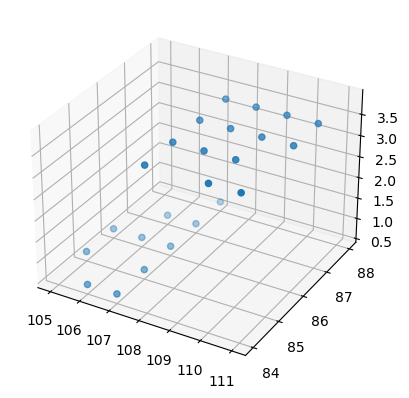

8.0 7 44
8.0 8
[0.64 3.84]


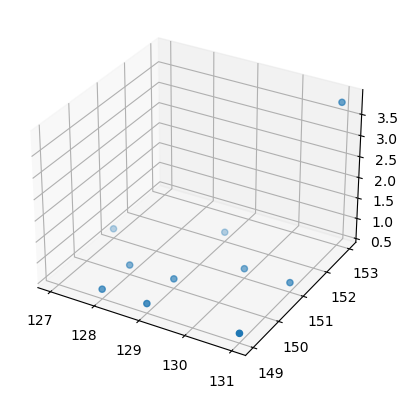

8.0 8 14
8.0 9
[0.64 3.84]


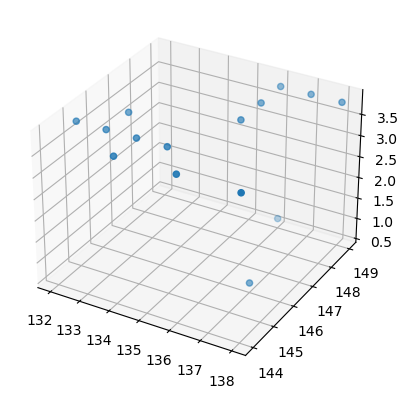

8.0 9 24
8.0 10
[0.64 3.84]


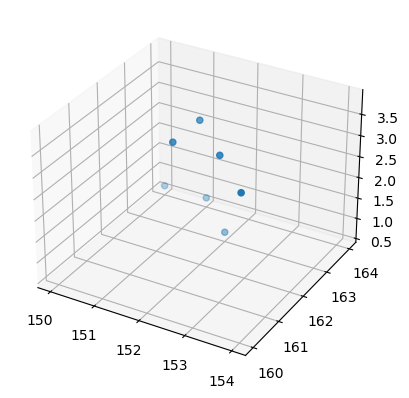

8.0 10 10
8.0 11
[0.32 0.64]


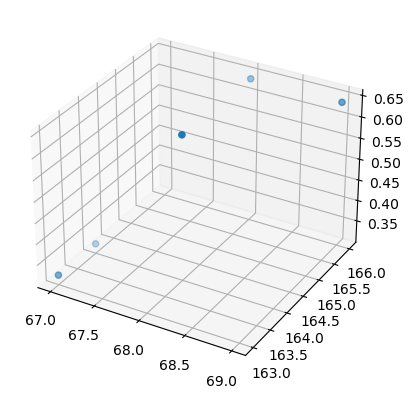

8.0 11 4
8.0 12
[0.64]


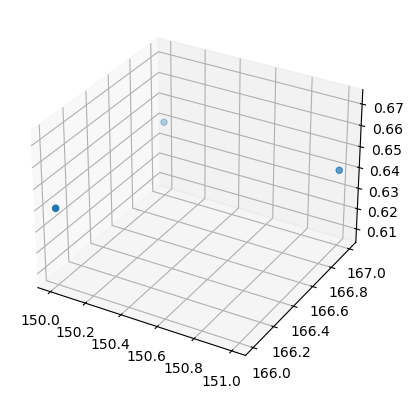

8.0 12 0
8.0 13
[0.32 0.64 3.84]


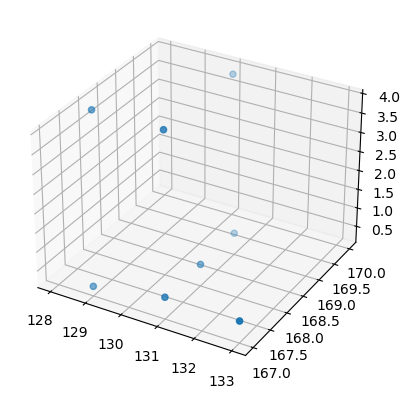

8.0 13 12
8.0 14
[0.64 3.84]


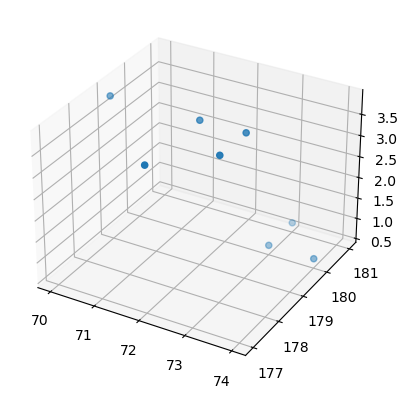

8.0 14 12
8.0 15
[6.72]


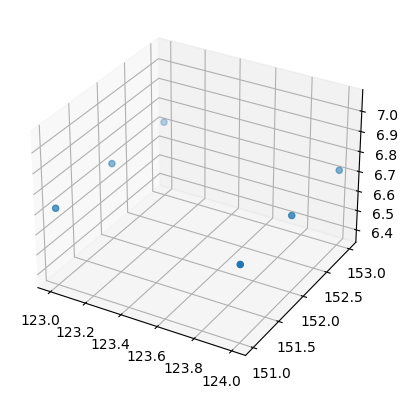

8.0 15 0
9.0 [-1  0  1  2  3  4  5  6]
9.0 0
[0.32 0.64 3.84 6.72]


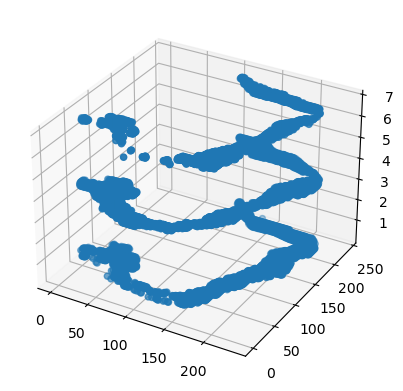

9.0 0 22760
9.0 1
[0.32 0.64 3.84]


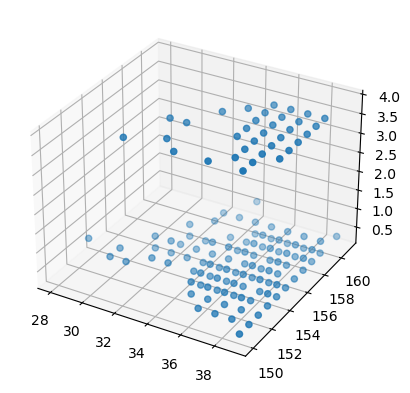

9.0 1 214
9.0 2
[0.32 0.64 3.84 6.72]


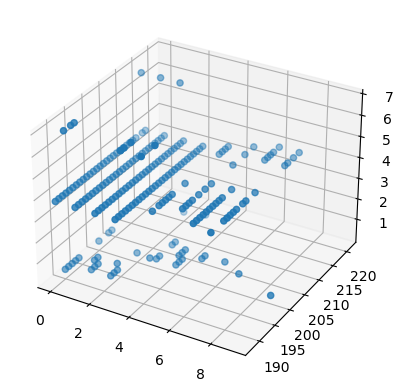

9.0 2 344
9.0 3
[0.64 3.84 6.72]


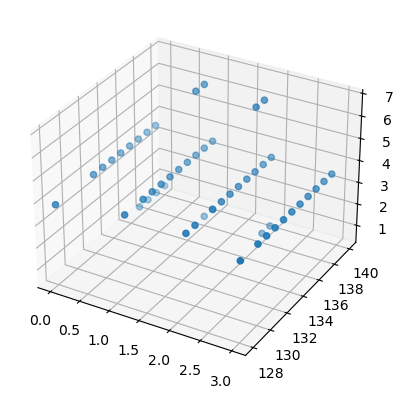

9.0 3 66
9.0 4
[0.64]


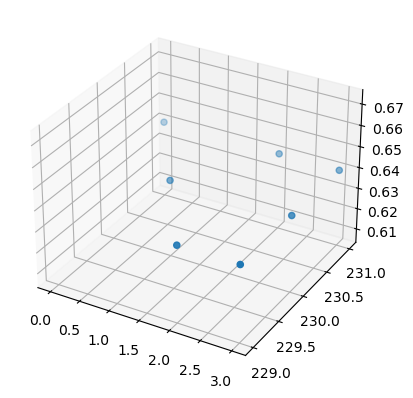

9.0 4 0
9.0 5
[0.32 3.84]


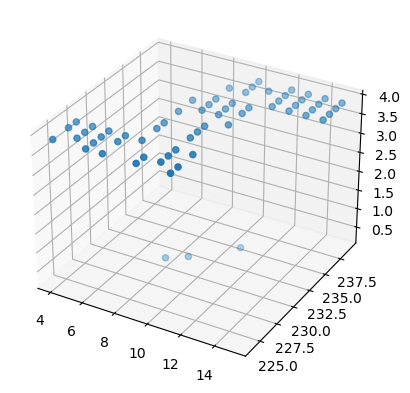

9.0 5 120
9.0 6
[3.84]


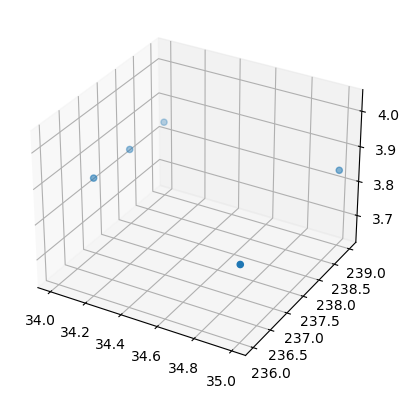

9.0 6 0
10.0 [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22]
10.0 0
[0.32 0.64 3.84]


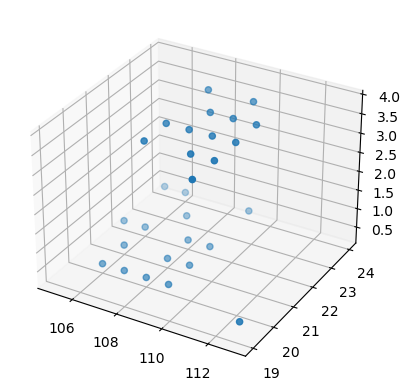

10.0 0 54
10.0 1
[0.32 0.64 3.84 6.72]


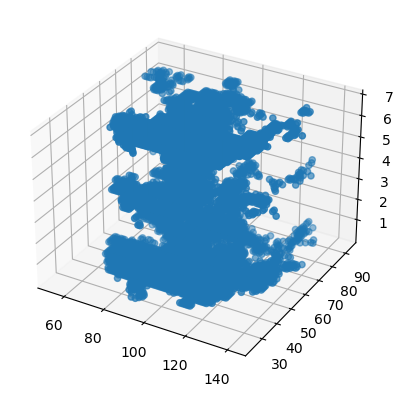

10.0 1 10270
10.0 2
[0.32 0.64 3.84]


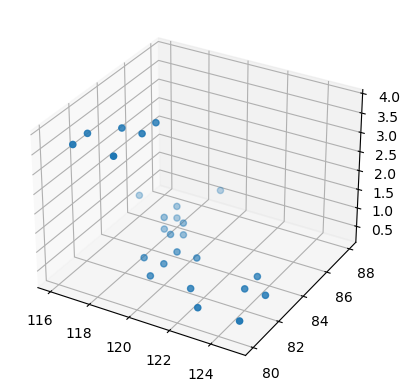

10.0 2 46
10.0 3
[0.32 0.64 3.84 6.72]


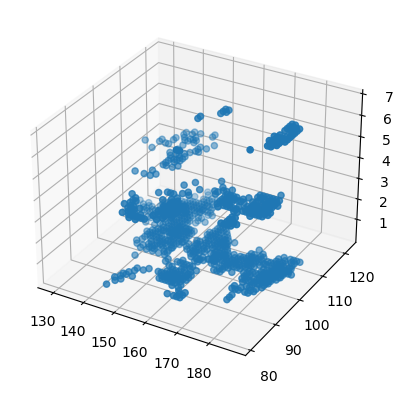

10.0 3 1564
10.0 4
[0.32 0.64 3.84 6.72]


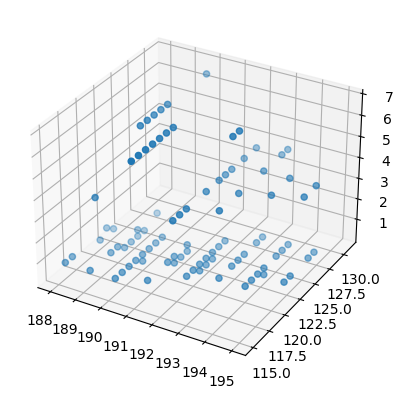

10.0 4 132
10.0 5
[0.32 0.64 3.84 6.72]


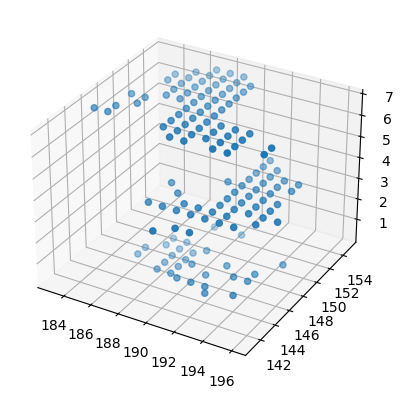

10.0 5 210
10.0 6
[0.32 3.84 6.72]


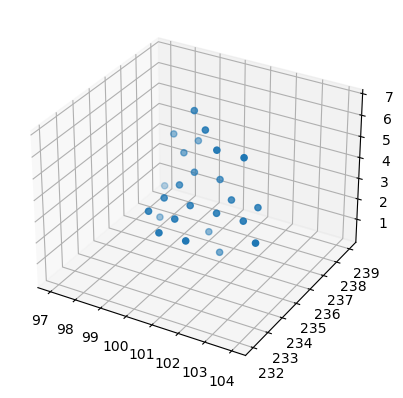

10.0 6 36
10.0 7
[0.64 3.84]


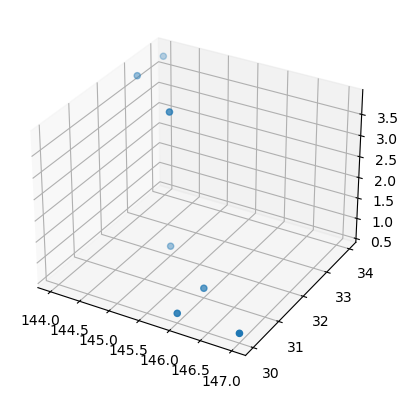

10.0 7 10
10.0 8
[0.64 3.84 6.72]


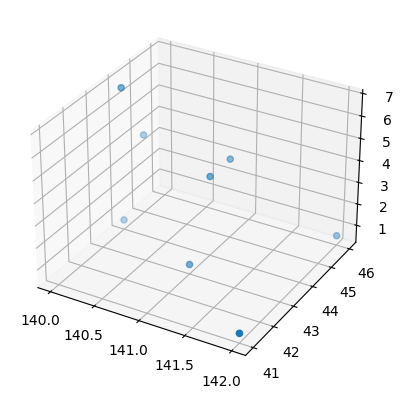

10.0 8 12
10.0 9
[0.64]


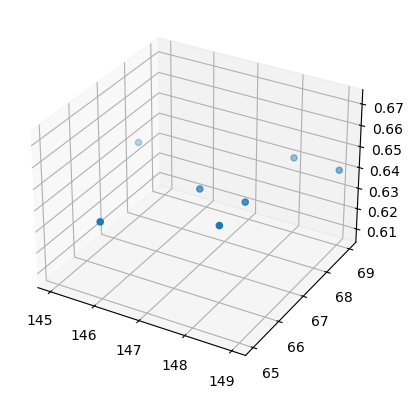

10.0 9 0
10.0 10
[0.64]


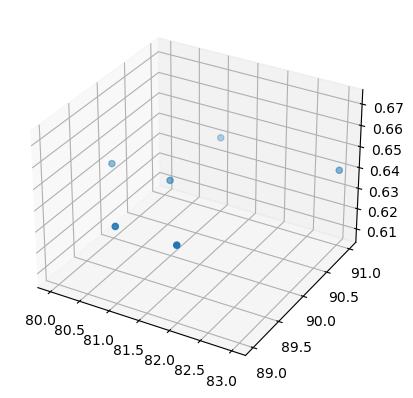

10.0 10 0
10.0 11
[0.64]


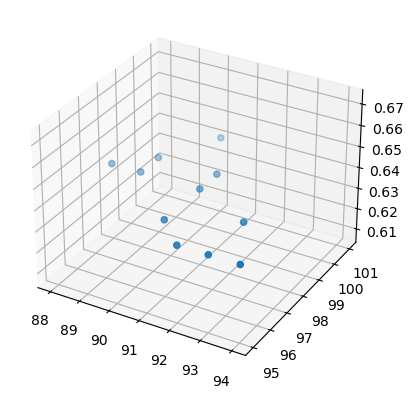

10.0 11 0
10.0 12
[0.64]


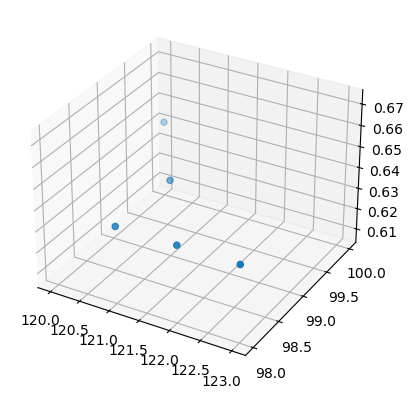

10.0 12 0
10.0 13
[0.64]


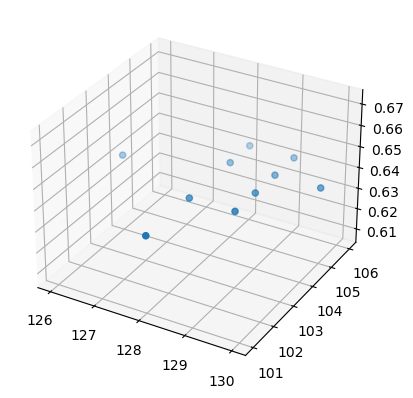

10.0 13 0
10.0 14
[0.64]


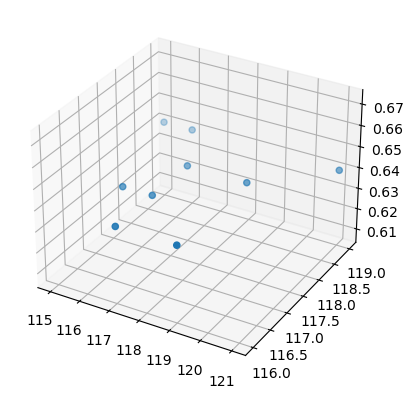

10.0 14 0
10.0 15
[0.64]


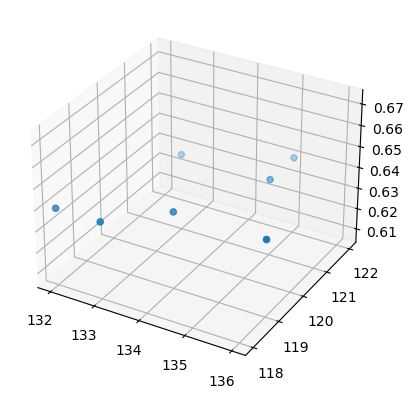

10.0 15 0
10.0 16
[0.64 3.84]


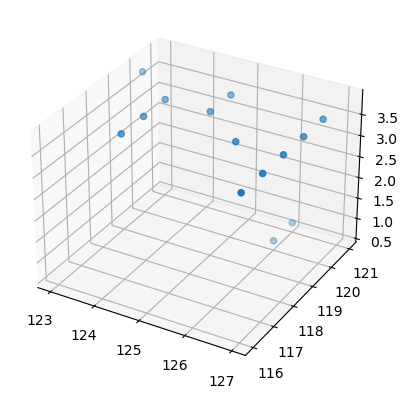

10.0 16 24
10.0 17
[0.64]


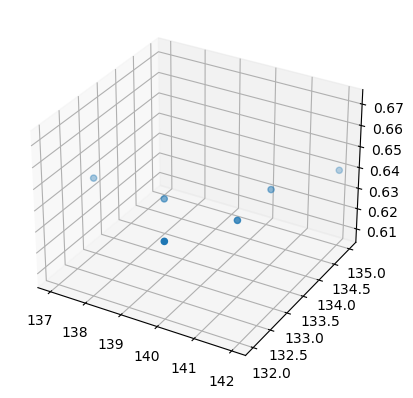

10.0 17 0
10.0 18
[0.64 3.84]


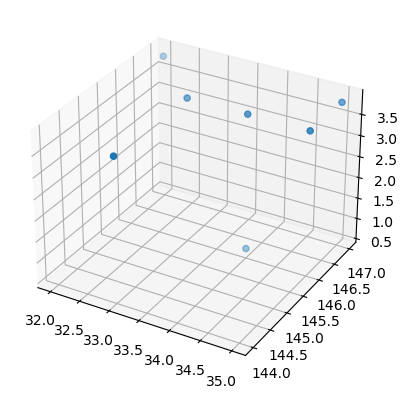

10.0 18 10
10.0 19
[3.84]


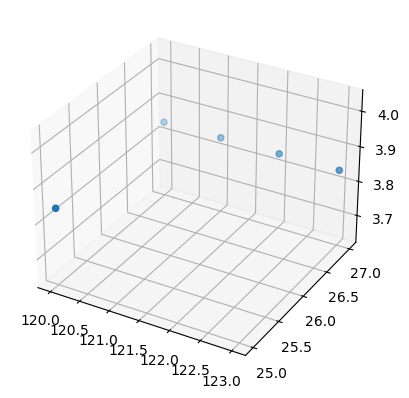

10.0 19 0
10.0 20
[3.84]


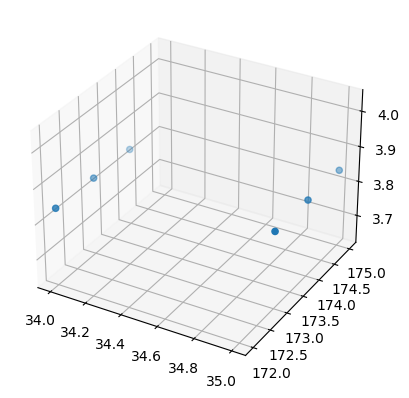

10.0 20 0
10.0 21
[0.64 6.72]


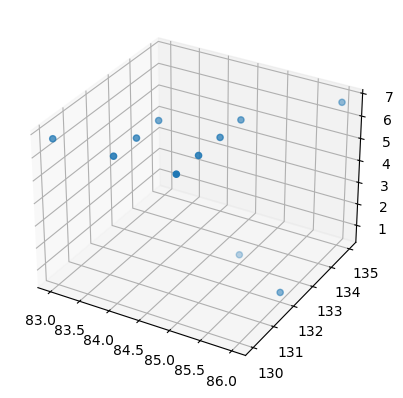

10.0 21 18
10.0 22
[6.72]


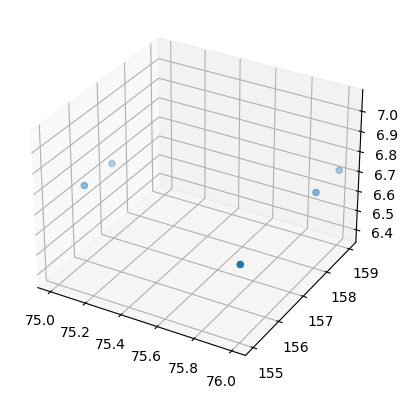

10.0 22 0
11.0 [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22]
11.0 0
[0.32]


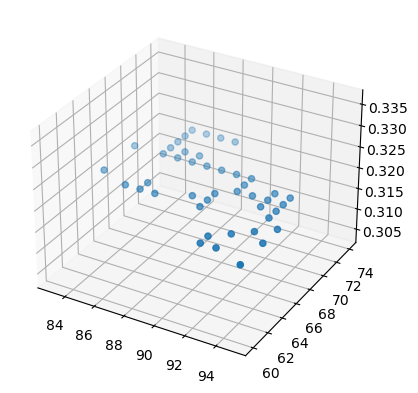

11.0 0 0
11.0 1
[0.32 0.64 3.84 6.72]


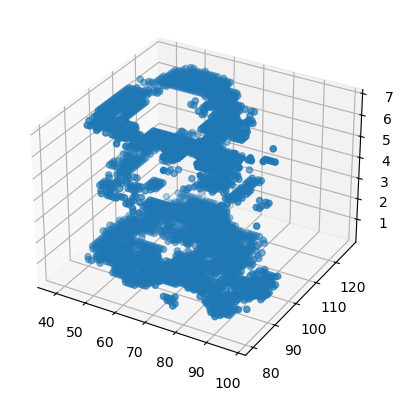

11.0 1 4802
11.0 2
[0.32]


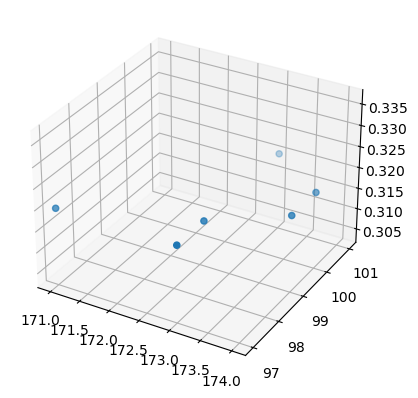

11.0 2 0
11.0 3
[0.32 0.64 3.84 6.72]


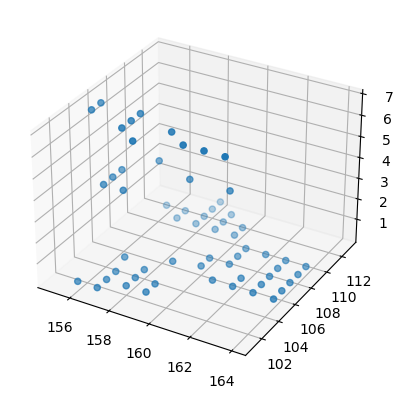

11.0 3 114
11.0 4
[0.32 0.64]


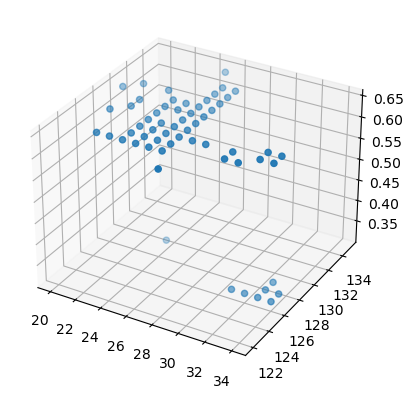

11.0 4 110
11.0 5
[0.32 0.64 3.84 6.72]


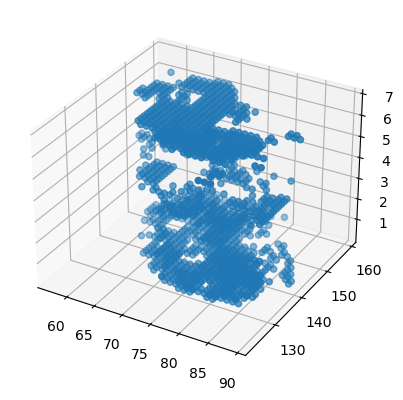

11.0 5 2030
11.0 6
[0.32 0.64 3.84 6.72]


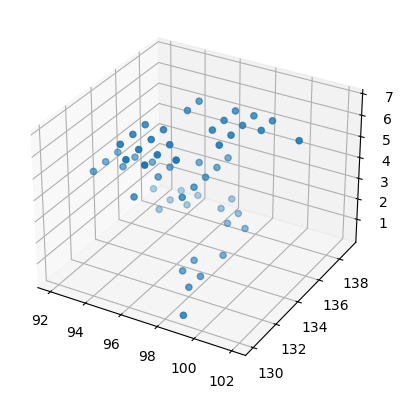

11.0 6 96
11.0 7
[0.32 0.64 3.84 6.72]


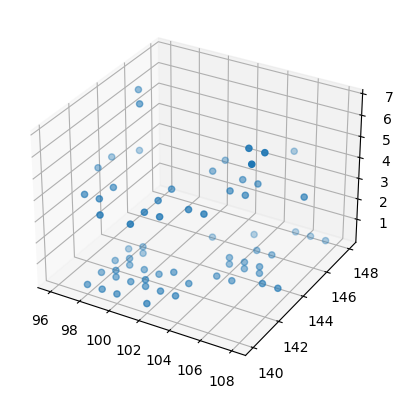

11.0 7 106
11.0 8
[0.32 3.84]


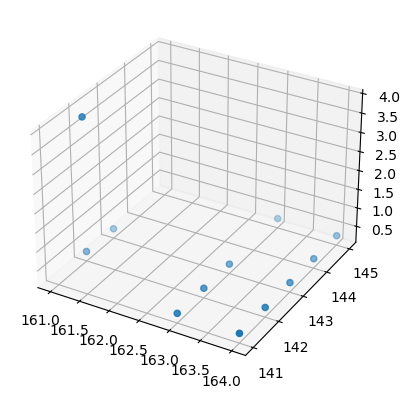

11.0 8 20
11.0 9
[0.32 0.64 3.84 6.72]


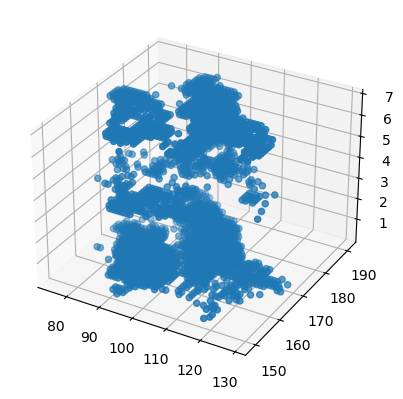

11.0 9 3694
11.0 10
[0.32 0.64]


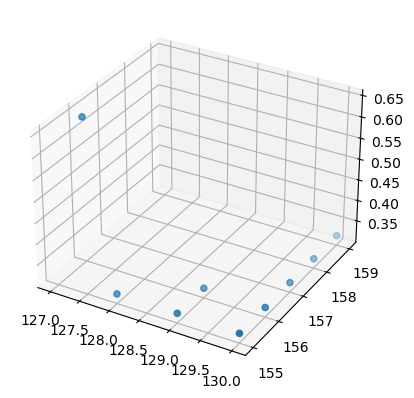

11.0 10 12
11.0 11
[0.32 0.64 3.84 6.72]


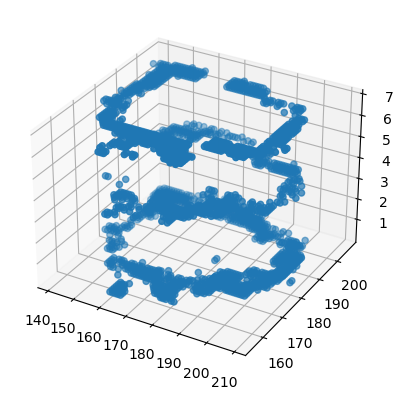

11.0 11 3252
11.0 12
[0.32 3.84]


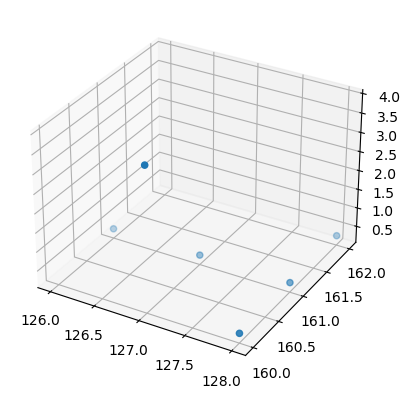

11.0 12 8
11.0 13
[0.32 0.64 3.84 6.72]


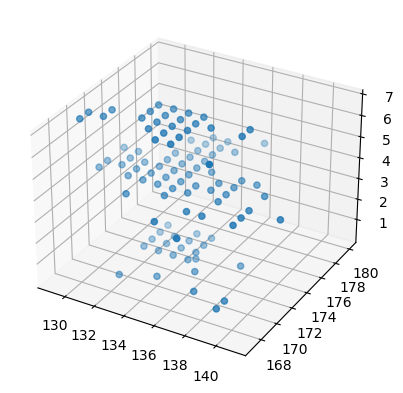

11.0 13 134
11.0 14
[0.32]


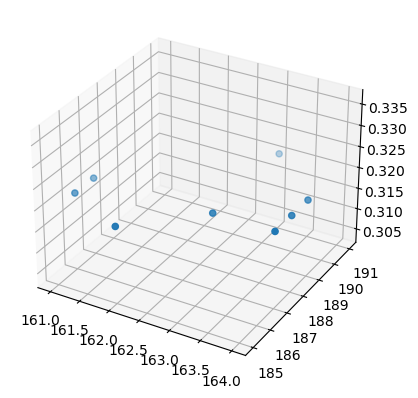

11.0 14 0
11.0 15
[0.32 0.64 3.84 6.72]


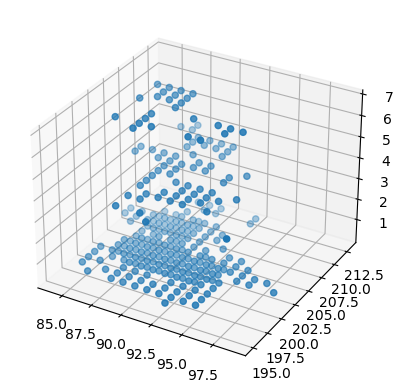

11.0 15 360
11.0 16
[0.64 3.84]


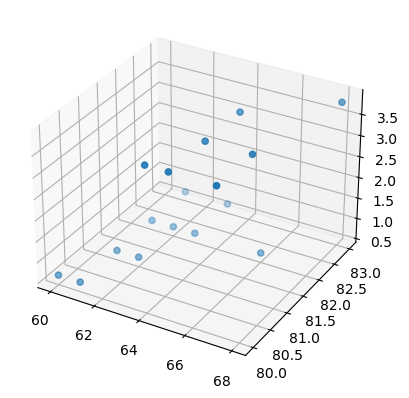

11.0 16 30
11.0 17
[3.84 6.72]


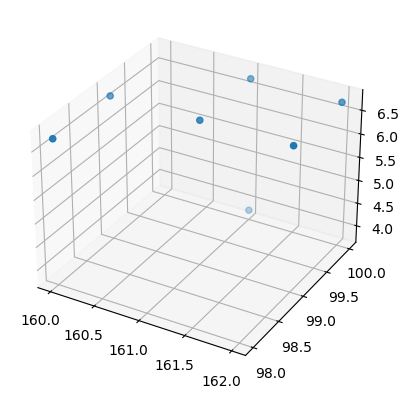

11.0 17 10
11.0 18
[6.72]


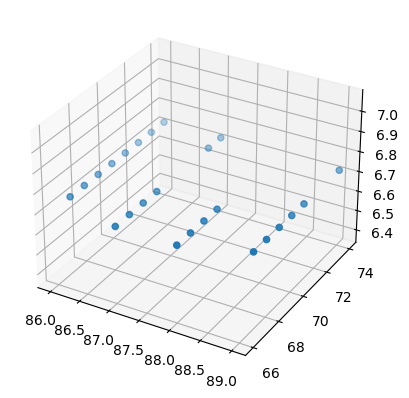

11.0 18 0
11.0 19
[6.72]


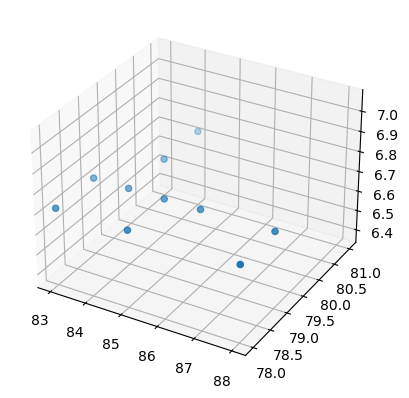

11.0 19 0
11.0 20
[6.72]


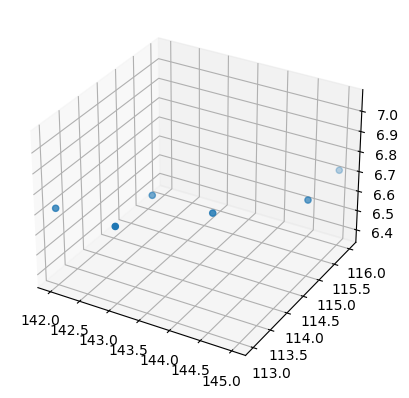

11.0 20 0
11.0 21
[6.72]


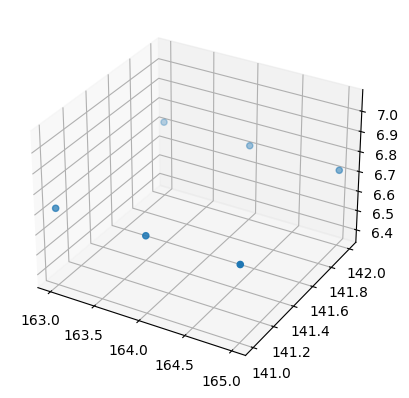

11.0 21 0
11.0 22
[6.72]


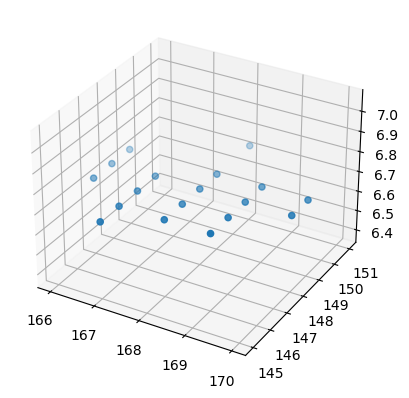

11.0 22 0
12.0 [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15]
12.0 0
[0.32 0.64 3.84 6.72]


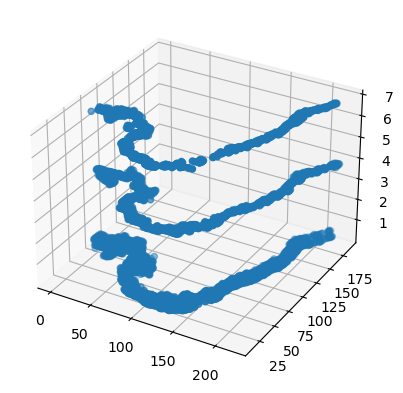

12.0 0 9300
12.0 1
[0.32 0.64]


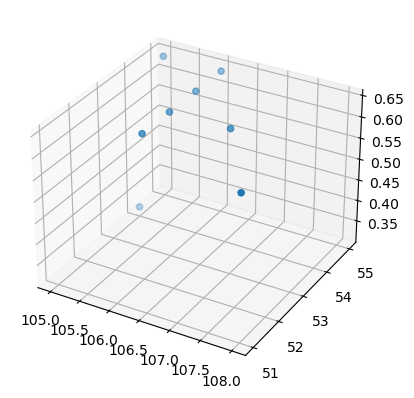

12.0 1 8
12.0 2
[0.32 0.64 3.84 6.72]


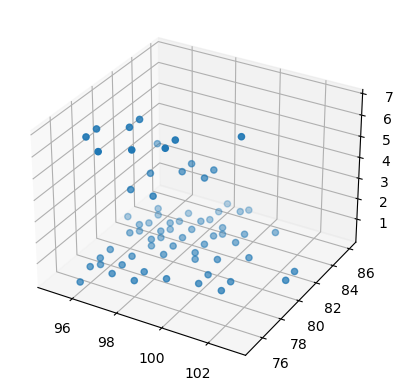

12.0 2 104
12.0 3
[0.32 0.64 3.84 6.72]


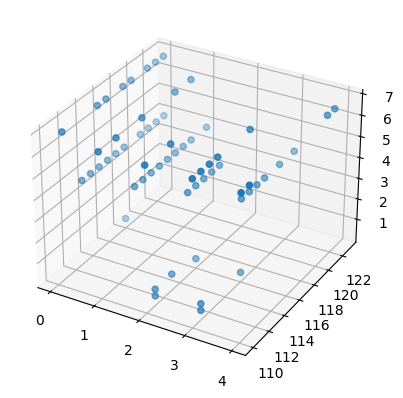

12.0 3 106
12.0 4
[0.32 0.64 3.84 6.72]


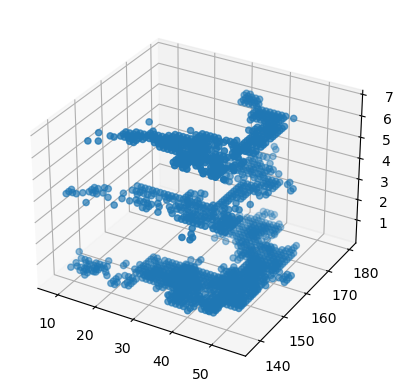

12.0 4 2098
12.0 5
[0.32]


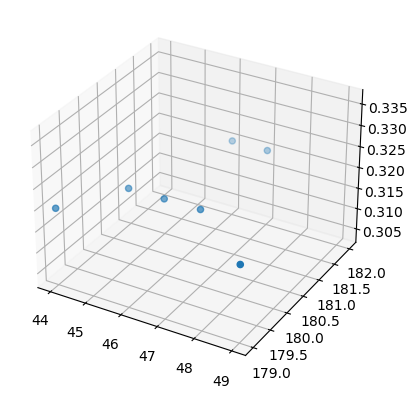

12.0 5 0
12.0 6
[0.32]


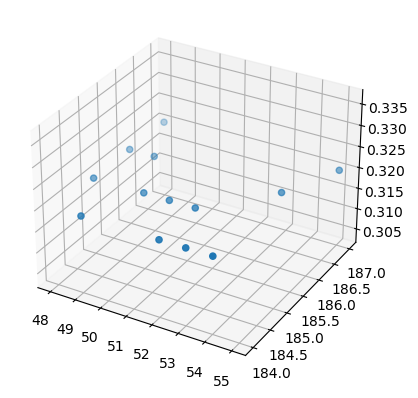

12.0 6 0
12.0 7
[0.32 0.64 3.84 6.72]


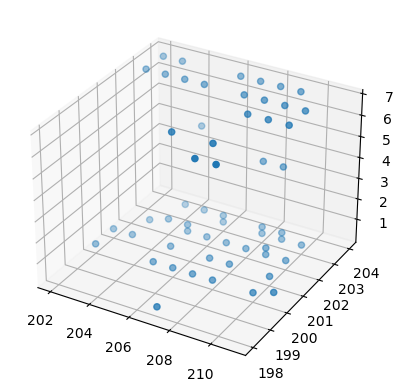

12.0 7 104
12.0 8
[0.32 0.64 3.84 6.72]


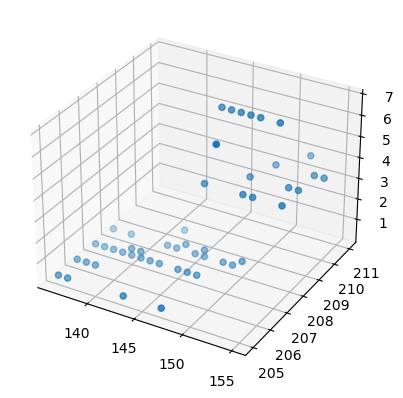

12.0 8 94
12.0 9
[0.32 0.64 3.84 6.72]


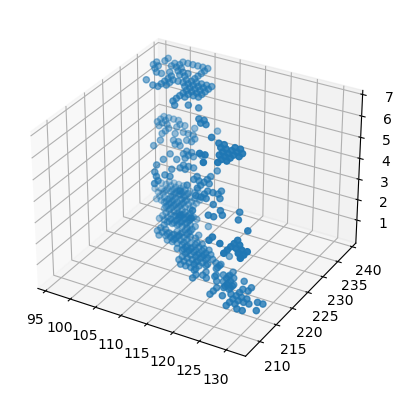

12.0 9 686
12.0 10
[0.32 3.84]


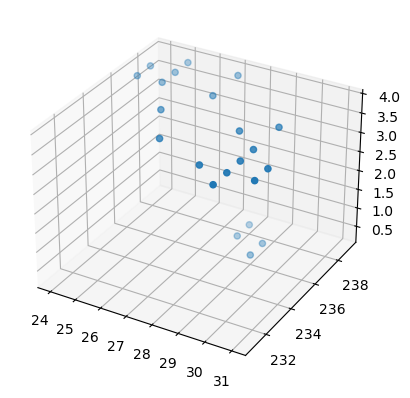

12.0 10 38
12.0 11
[0.64 3.84]


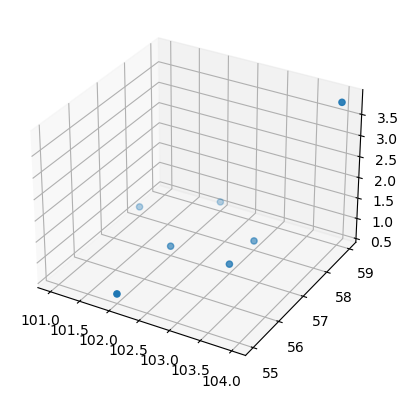

12.0 11 10
12.0 12
[0.64]


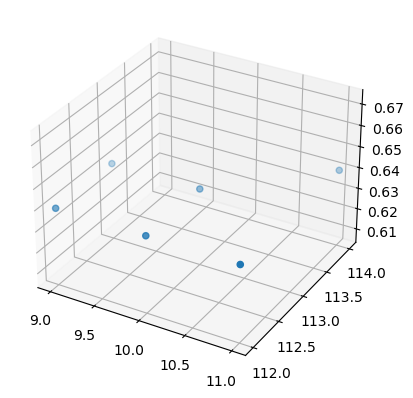

12.0 12 0
12.0 13
[3.84 6.72]


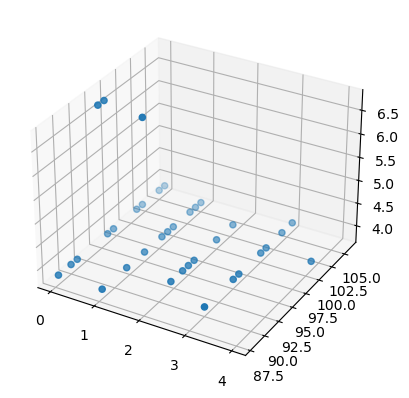

12.0 13 64
12.0 14
[3.84]


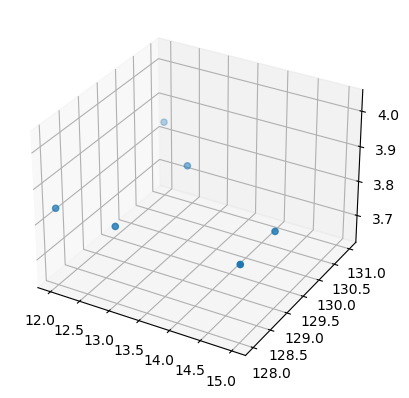

12.0 14 0
12.0 15
[6.72]


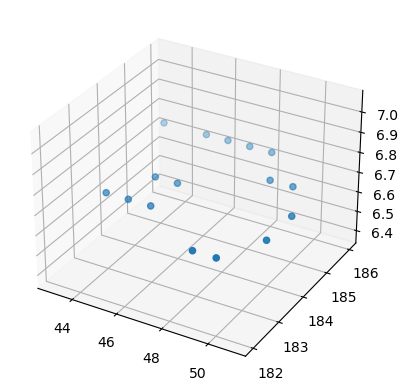

12.0 15 0
13.0 [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31 32]
13.0 0
[0.32 0.64 3.84 6.72]


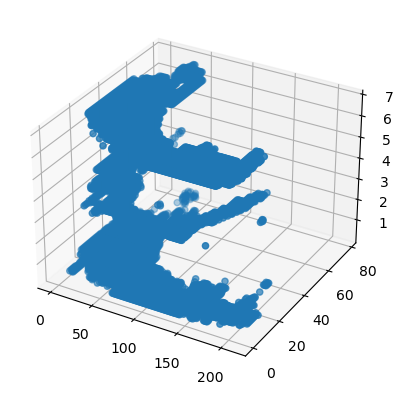

13.0 0 24206
13.0 1
[0.32]


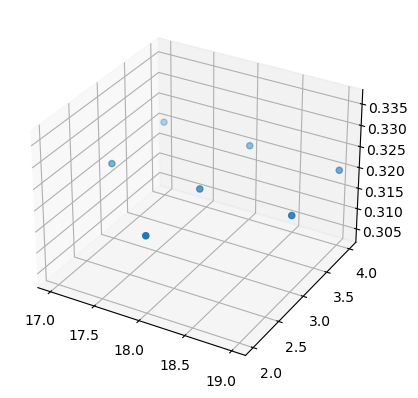

13.0 1 0
13.0 2
[0.32]


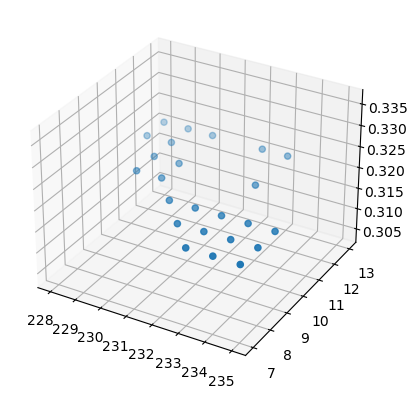

13.0 2 0
13.0 3
[0.32 0.64 3.84 6.72]


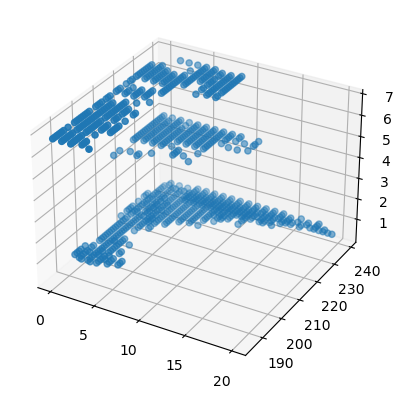

13.0 3 1242
13.0 4
[0.32]


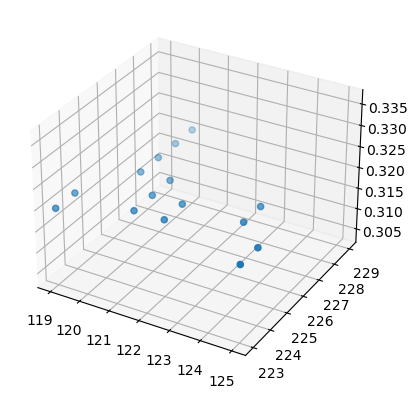

13.0 4 0
13.0 5
[0.64 6.72]


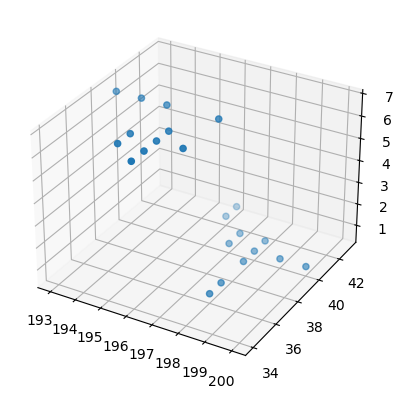

13.0 5 40
13.0 6
[0.64]


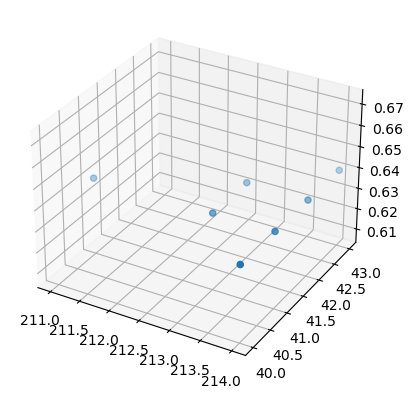

13.0 6 0
13.0 7
[0.64]


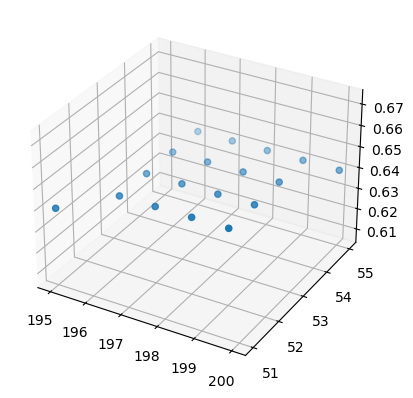

13.0 7 0
13.0 8
[0.64 3.84]


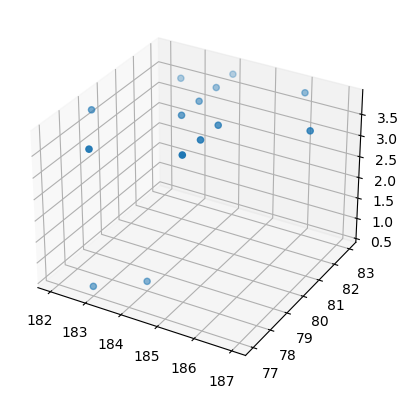

13.0 8 22
13.0 9
[0.64 6.72]


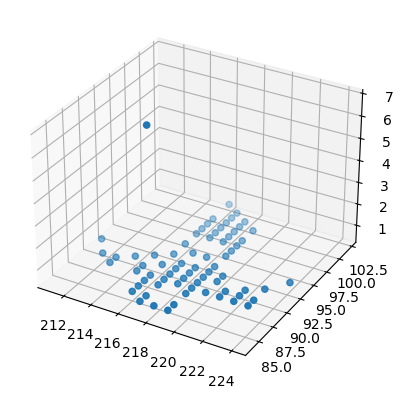

13.0 9 124
13.0 10
[0.64 3.84]


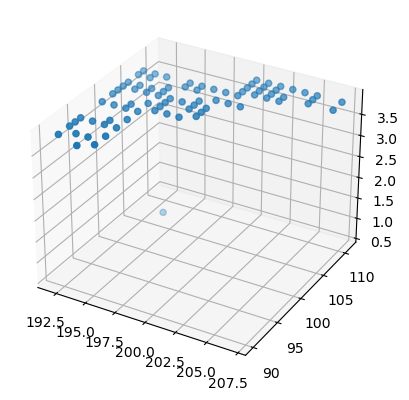

13.0 10 118
13.0 11
[0.64 3.84]


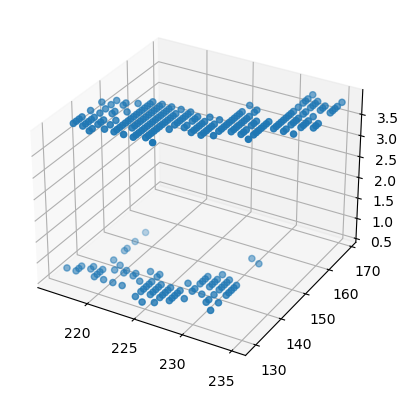

13.0 11 582
13.0 12
[0.64 3.84]


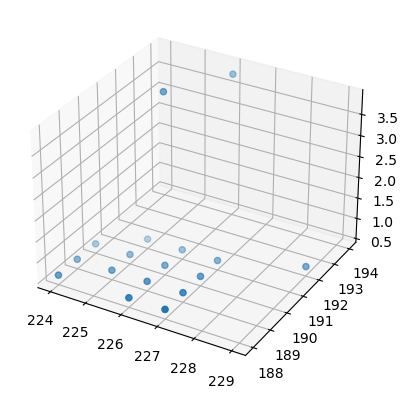

13.0 12 30
13.0 13
[0.64 3.84]


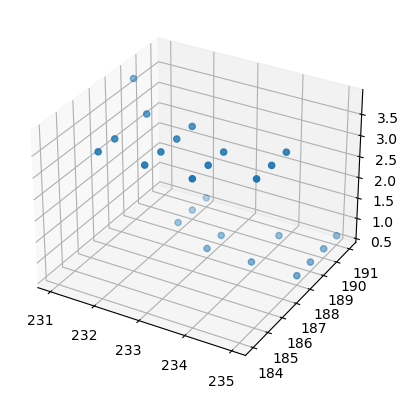

13.0 13 46
13.0 14
[0.64]


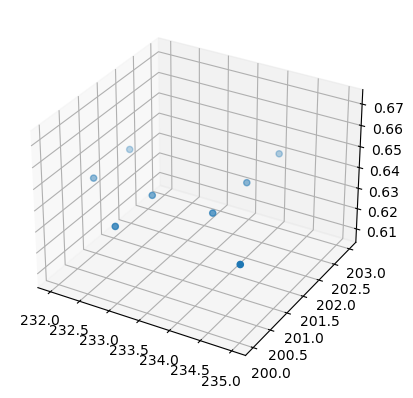

13.0 14 0
13.0 15
[0.64 3.84 6.72]


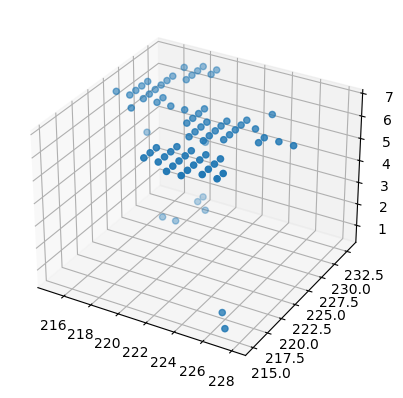

13.0 15 146
13.0 16
[0.64]


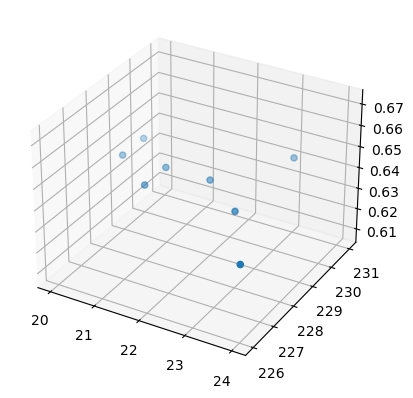

13.0 16 0
13.0 17
[3.84]


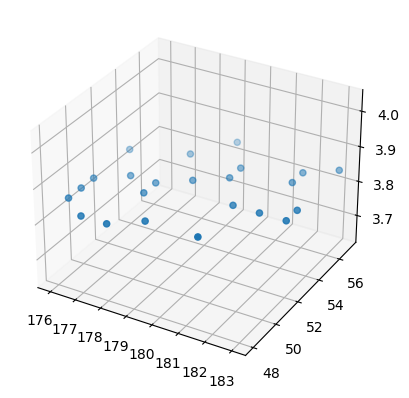

13.0 17 0
13.0 18
[3.84]


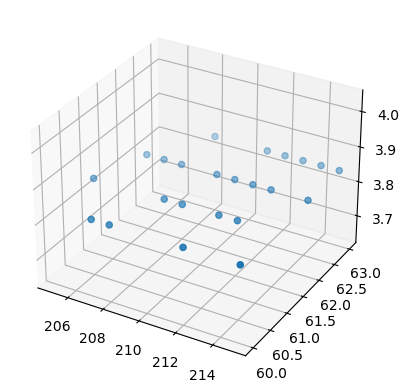

13.0 18 0
13.0 19
[3.84]


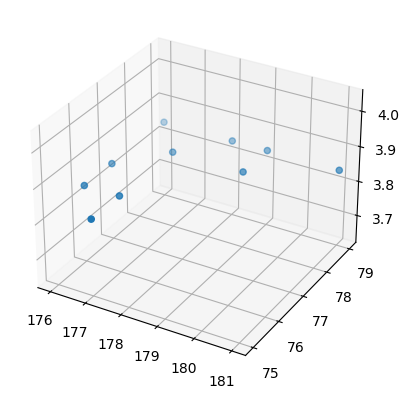

13.0 19 0
13.0 20
[3.84]


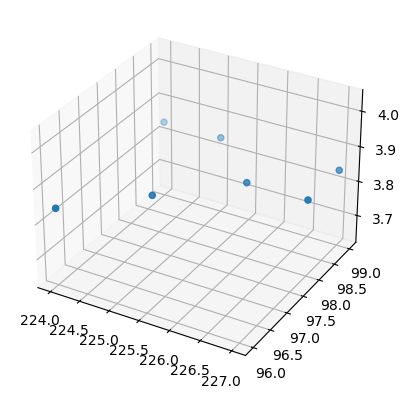

13.0 20 0
13.0 21
[3.84]


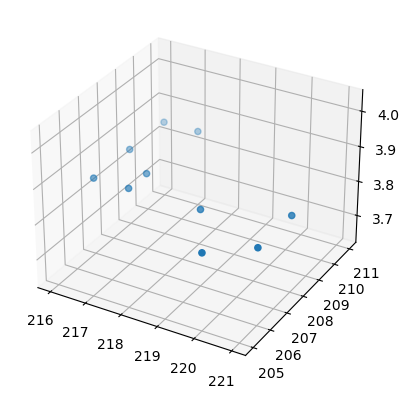

13.0 21 0
13.0 22
[3.84]


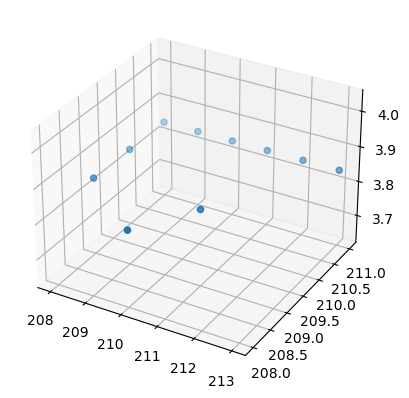

13.0 22 0
13.0 23
[3.84]


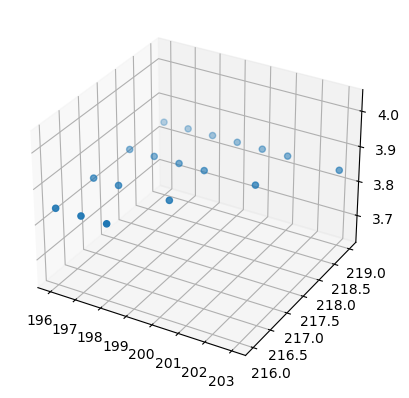

13.0 23 0
13.0 24
[3.84 6.72]


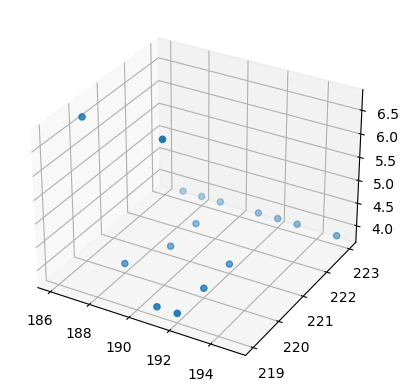

13.0 24 26
13.0 25
[3.84]


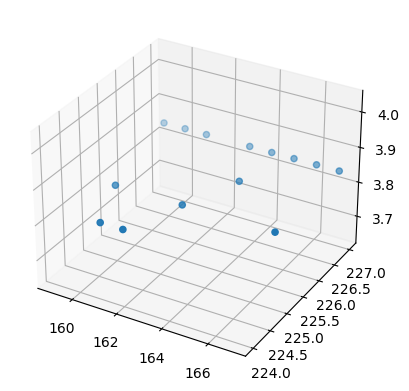

13.0 25 0
13.0 26
[3.84]


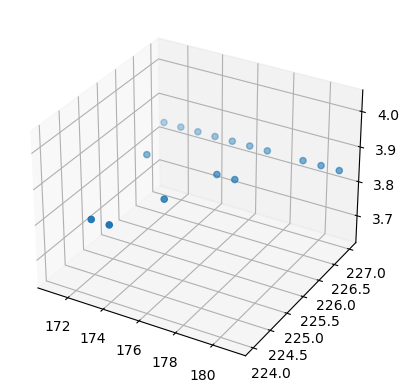

13.0 26 0
13.0 27
[3.84 6.72]


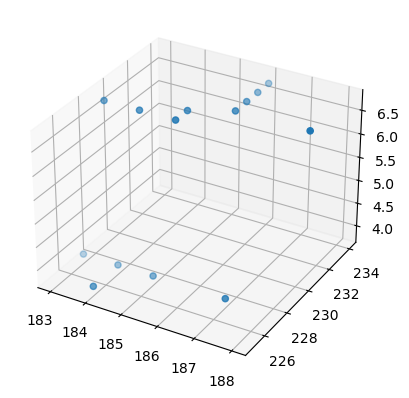

13.0 27 22
13.0 28
[6.72]


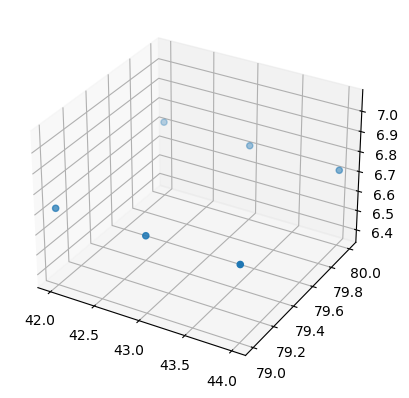

13.0 28 0
13.0 29
[6.72]


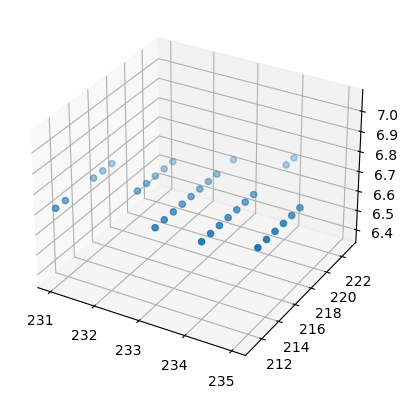

13.0 29 0
13.0 30
[6.72]


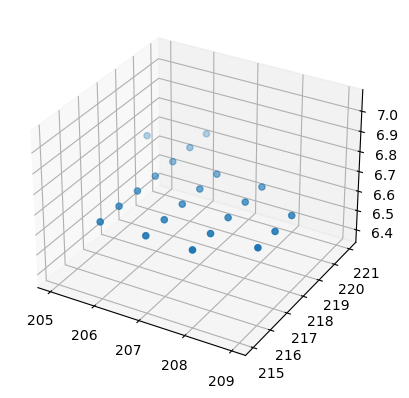

13.0 30 0
13.0 31
[6.72]


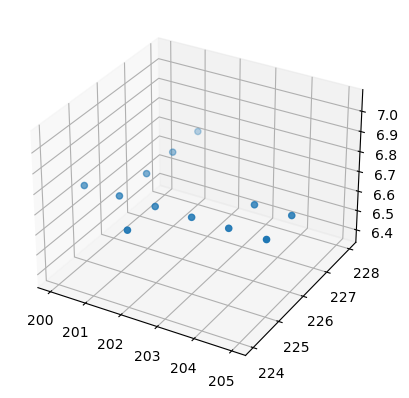

13.0 31 0
13.0 32
[6.72]


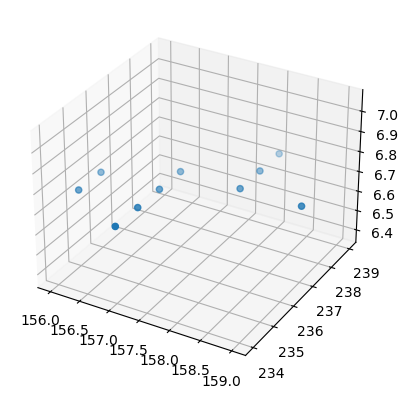

13.0 32 0
14.0 [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22]
14.0 0
[0.32 3.84]


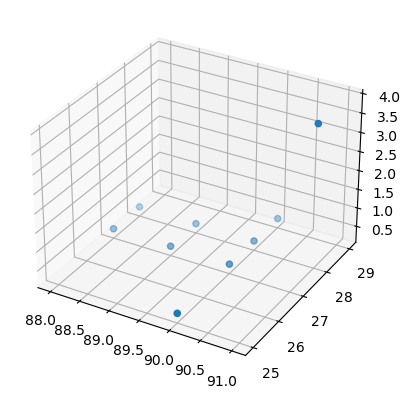

14.0 0 14
14.0 1
[0.32]


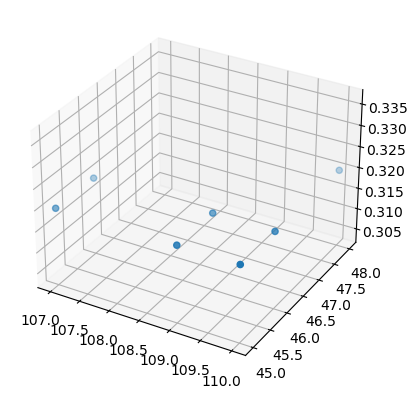

14.0 1 0
14.0 2
[0.32 0.64 3.84 6.72]


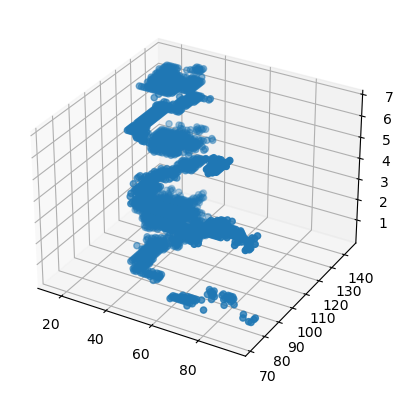

14.0 2 3210
14.0 3
[0.32 0.64 6.72]


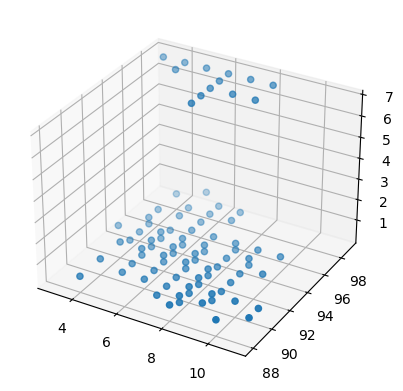

14.0 3 160
14.0 4
[0.32]


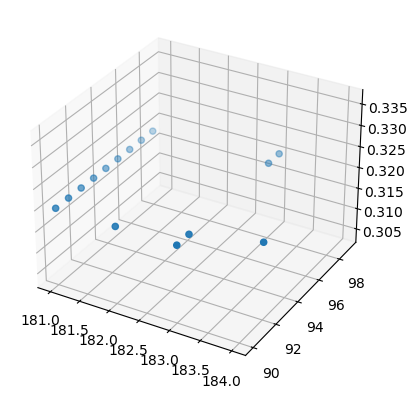

14.0 4 0
14.0 5
[0.32 3.84 6.72]


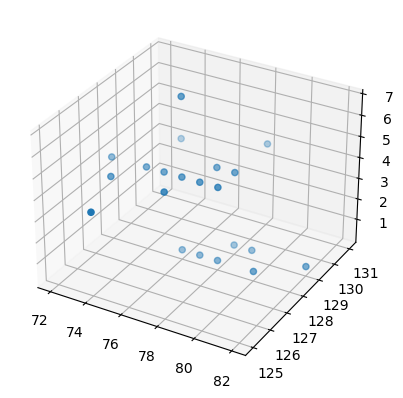

14.0 5 28
14.0 6
[0.32 0.64 3.84]


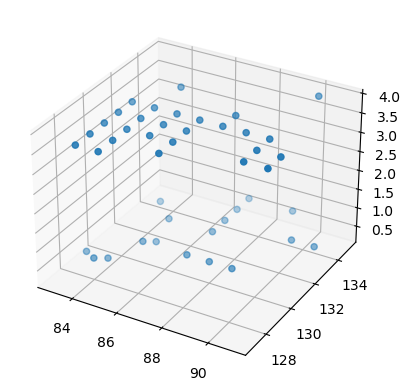

14.0 6 84
14.0 7
[0.32 0.64 3.84 6.72]


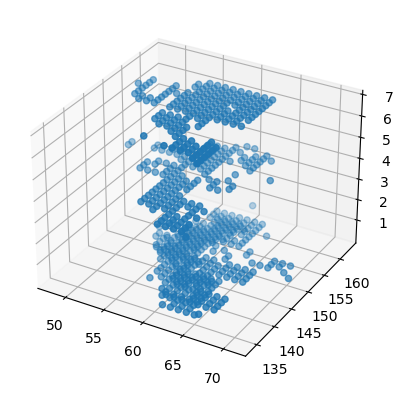

14.0 7 852
14.0 8
[0.32 0.64 3.84 6.72]


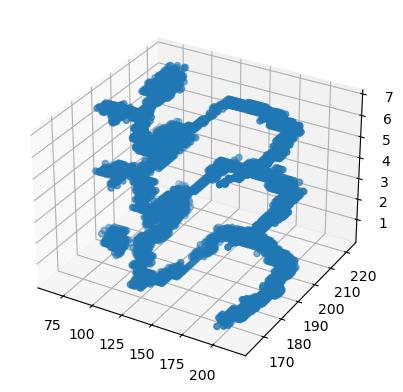

14.0 8 7000
14.0 9
[0.32 0.64]


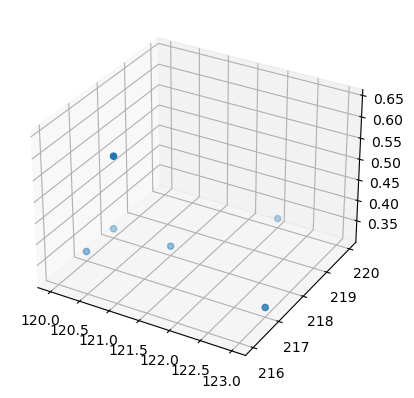

14.0 9 6
14.0 10
[0.64 3.84]


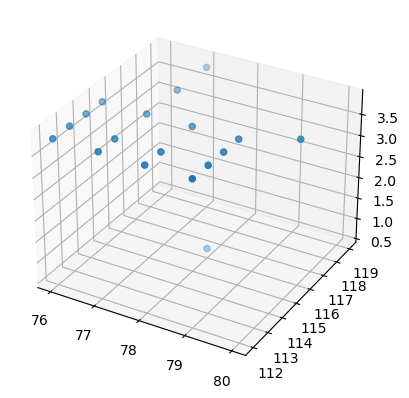

14.0 10 32
14.0 11
[0.64 3.84 6.72]


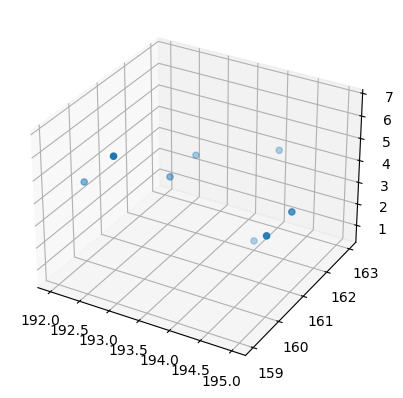

14.0 11 10
14.0 12
[0.64]


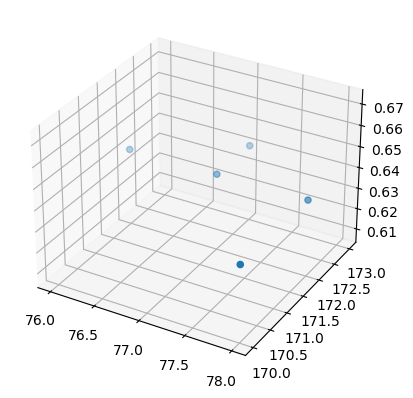

14.0 12 0
14.0 13
[0.64]


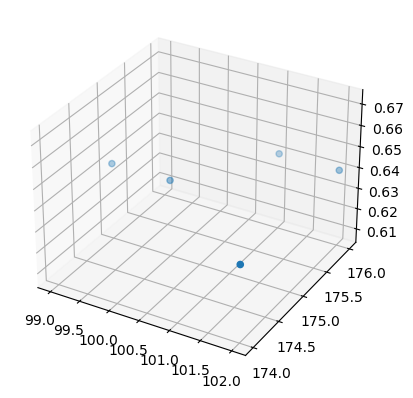

14.0 13 0
14.0 14
[0.64 3.84 6.72]


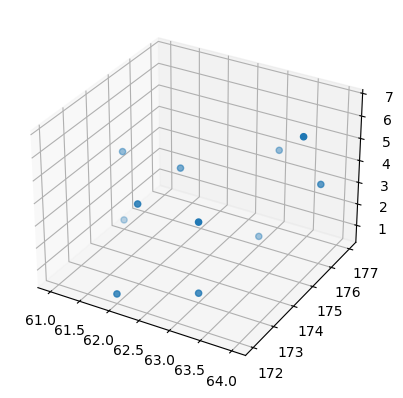

14.0 14 16
14.0 15
[0.64 6.72]


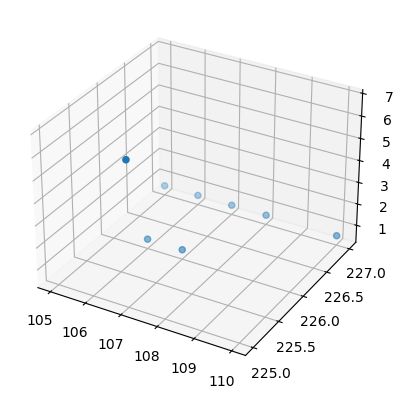

14.0 15 12
14.0 16
[0.64 6.72]


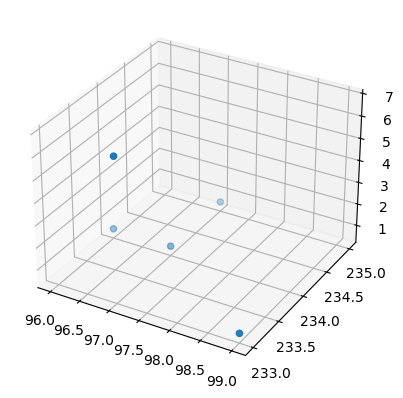

14.0 16 6
14.0 17
[0.64 3.84 6.72]


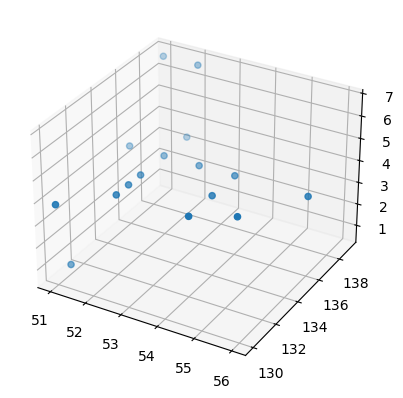

14.0 17 26
14.0 18
[3.84]


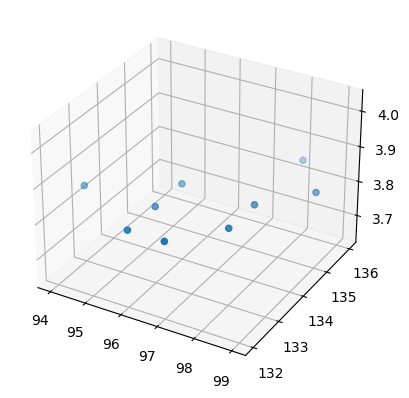

14.0 18 0
14.0 19
[3.84]


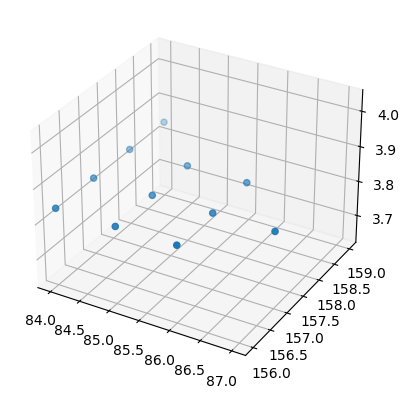

14.0 19 0
14.0 20
[0.64 3.84]


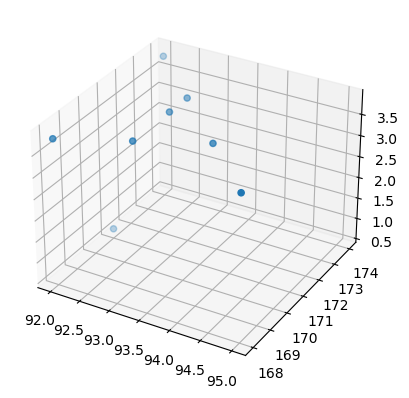

14.0 20 12
14.0 21
[3.84]


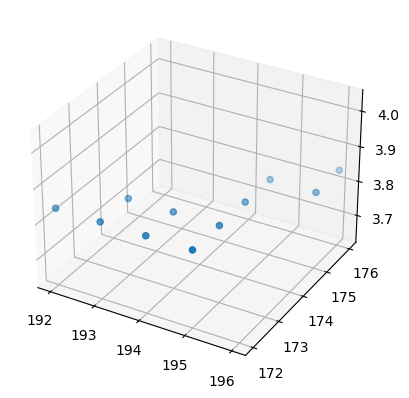

14.0 21 0
14.0 22
[6.72]


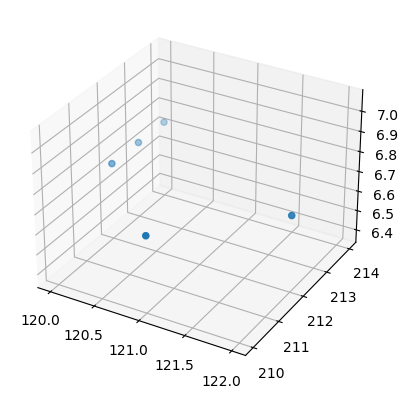

14.0 22 0
15.0 [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29]
15.0 0
[0.32 0.64]


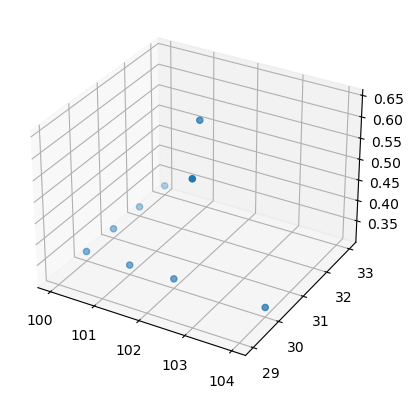

15.0 0 12
15.0 1
[0.32]


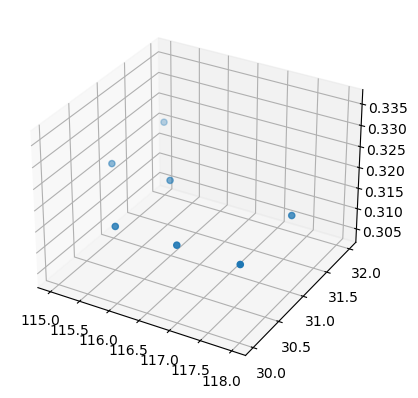

15.0 1 0
15.0 2
[0.32 0.64]


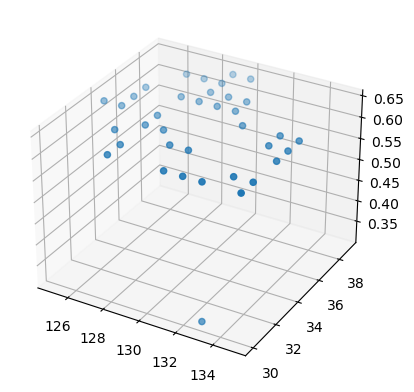

15.0 2 20
15.0 3
[0.32 0.64 3.84 6.72]


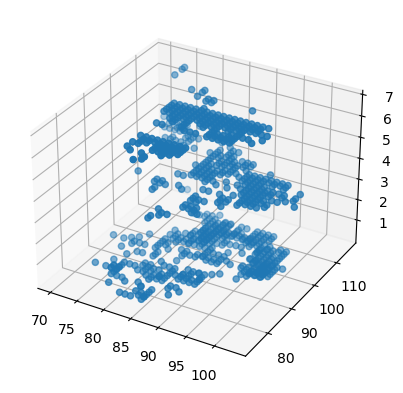

15.0 3 1034
15.0 4
[0.32 0.64 3.84 6.72]


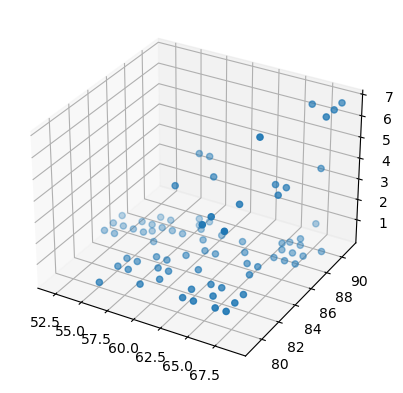

15.0 4 152
15.0 5
[0.32]


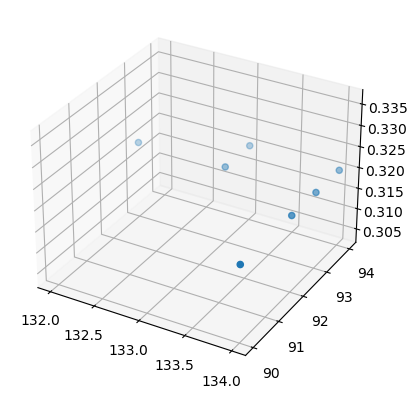

15.0 5 0
15.0 6
[0.32 0.64 3.84 6.72]


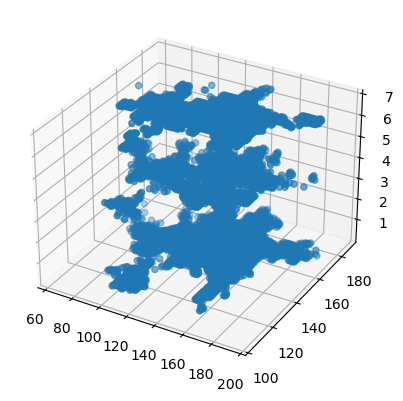

15.0 6 11960
15.0 7
[0.32]


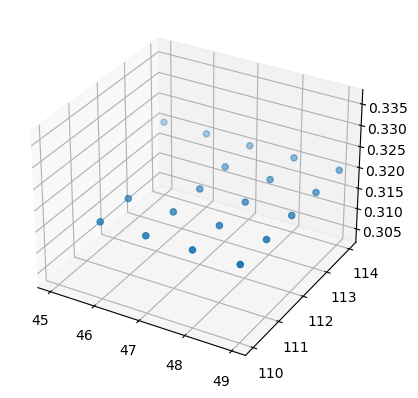

15.0 7 0
15.0 8
[0.32 0.64 3.84 6.72]


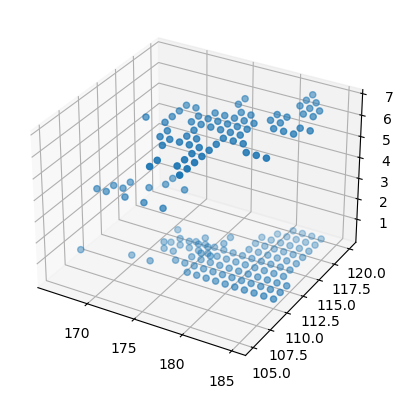

15.0 8 348
15.0 9
[0.32]


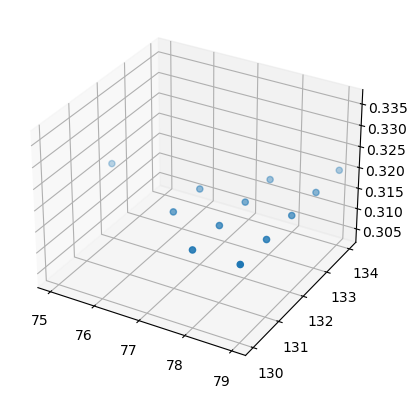

15.0 9 0
15.0 10
[0.32 0.64 3.84]


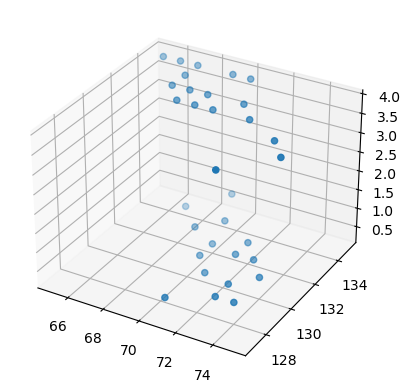

15.0 10 60
15.0 11
[0.32 0.64 3.84 6.72]


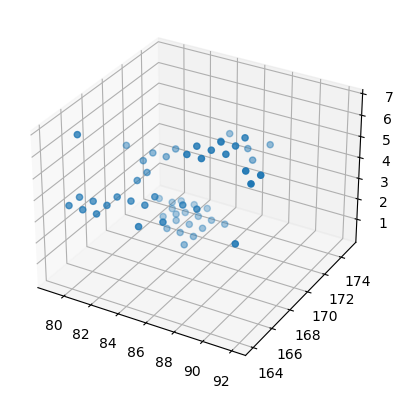

15.0 11 112
15.0 12
[0.32 0.64 3.84]


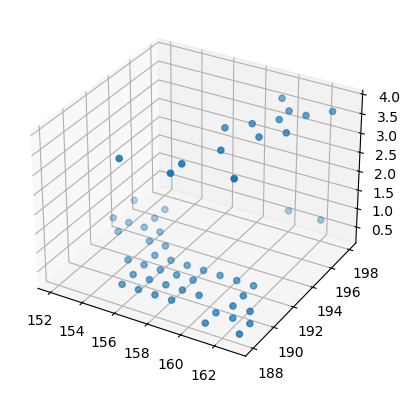

15.0 12 100
15.0 13
[0.64]


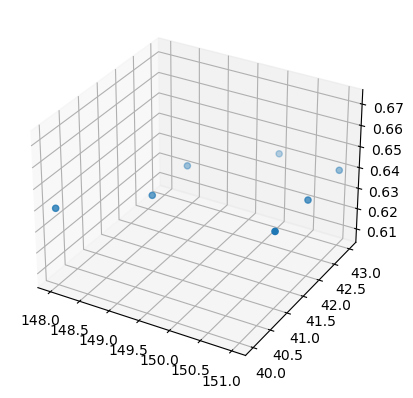

15.0 13 0
15.0 14
[0.64]


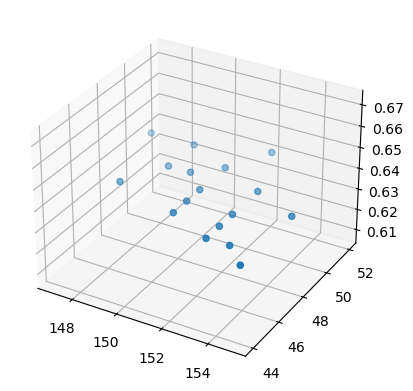

15.0 14 0
15.0 15
[0.64]


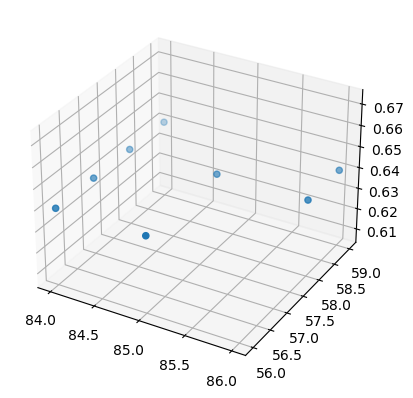

15.0 15 0
15.0 16
[0.64]


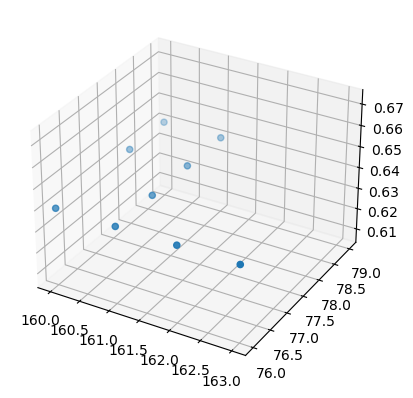

15.0 16 0
15.0 17
[0.64]


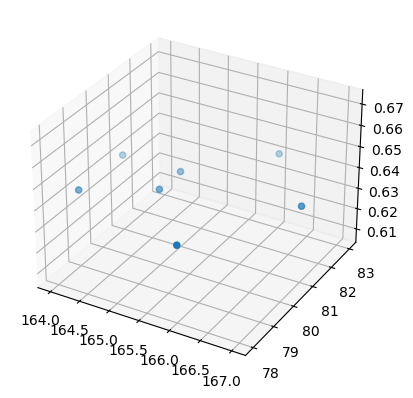

15.0 17 0
15.0 18
[0.64]


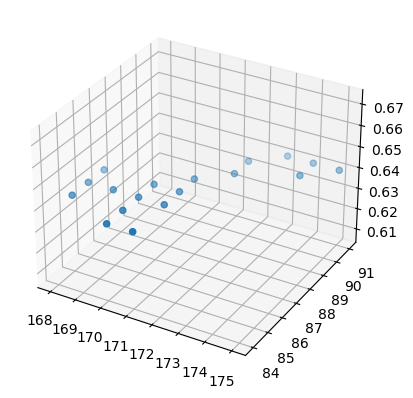

15.0 18 0
15.0 19
[0.64 3.84]


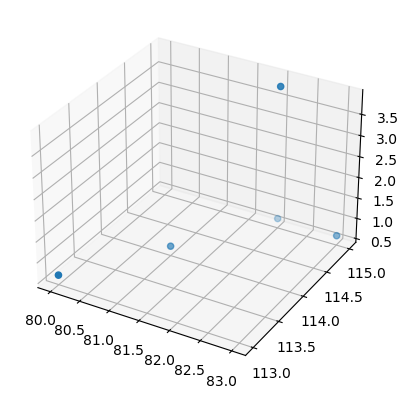

15.0 19 4
15.0 20
[0.64]


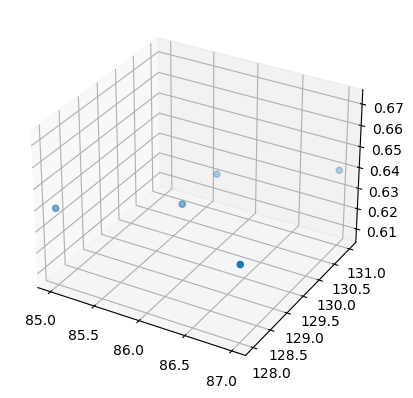

15.0 20 0
15.0 21
[0.64 3.84 6.72]


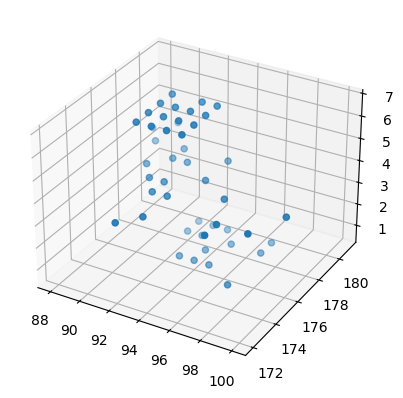

15.0 21 82
15.0 22
[0.32 0.64]


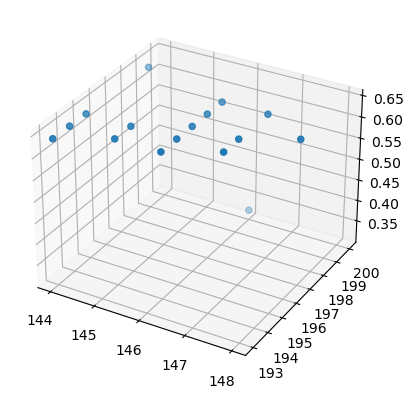

15.0 22 8
15.0 23
[3.84 6.72]


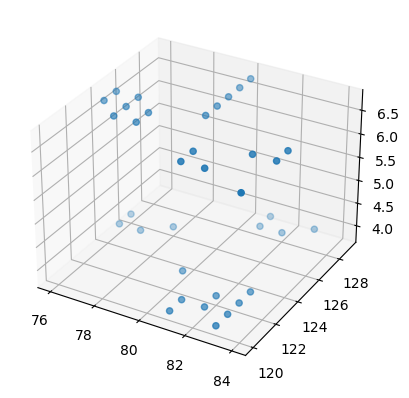

15.0 23 72
15.0 24
[3.84]


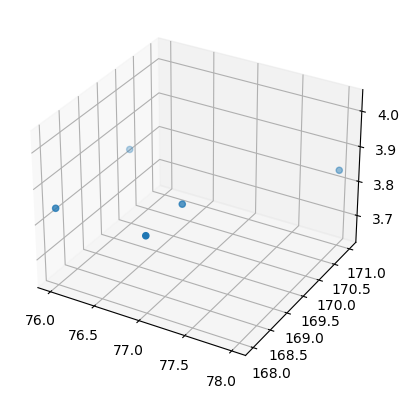

15.0 24 0
15.0 25
[6.72]


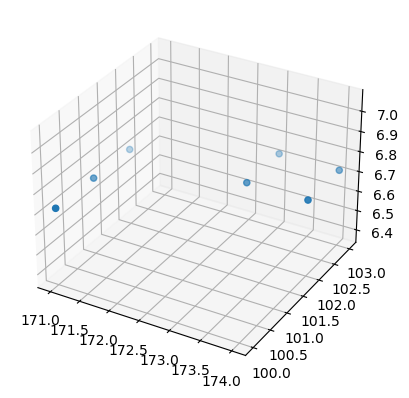

15.0 25 0
15.0 26
[6.72]


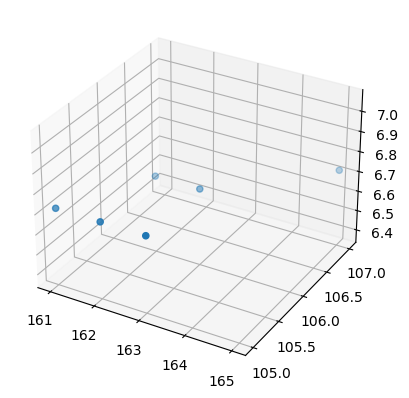

15.0 26 0
15.0 27
[6.72]


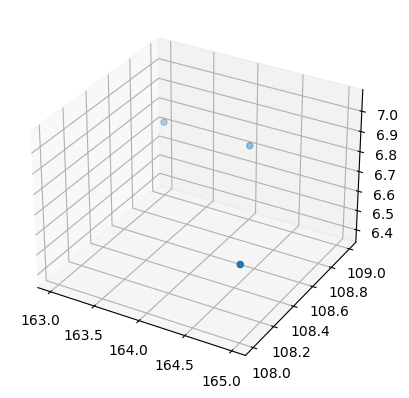

15.0 27 0
15.0 28
[6.72]


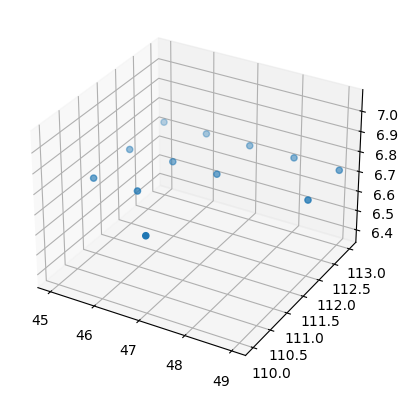

15.0 28 0
15.0 29
[6.72]


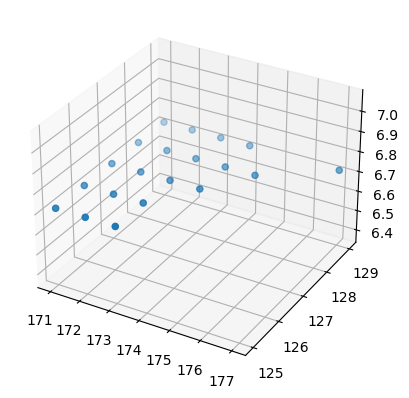

15.0 29 0
16.0 [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26]
16.0 0
[0.32 0.64 3.84]


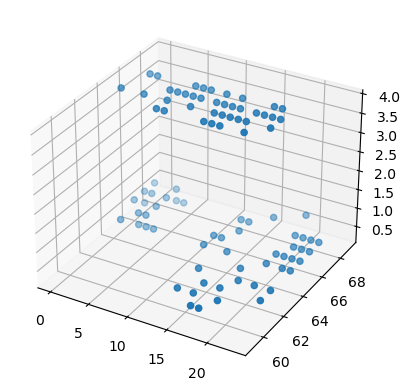

16.0 0 170
16.0 1
[0.32 0.64 3.84 6.72]


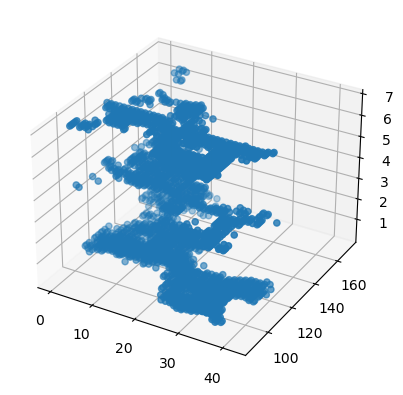

16.0 1 3706
16.0 2
[0.32 0.64 3.84 6.72]


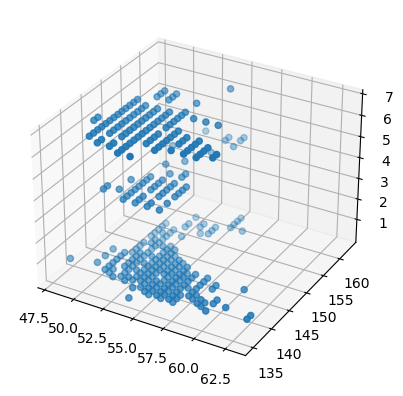

16.0 2 468
16.0 3
[0.32 0.64 3.84 6.72]


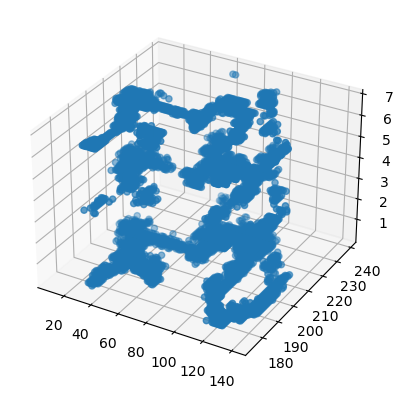

16.0 3 7744
16.0 4
[0.32 0.64]


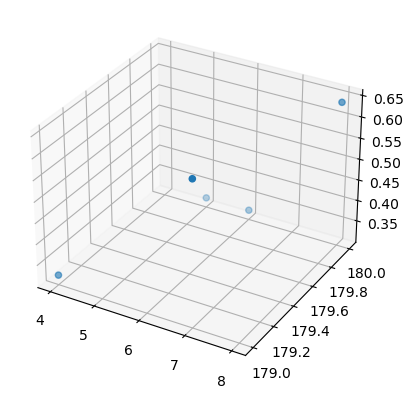

16.0 4 4
16.0 5
[0.32 0.64 3.84 6.72]


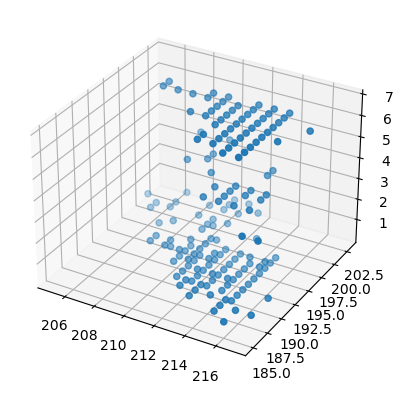

16.0 5 274
16.0 6
[0.32 0.64 3.84]


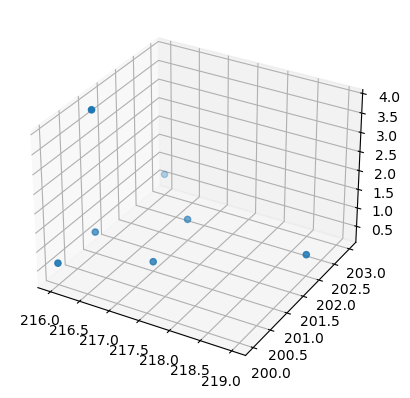

16.0 6 10
16.0 7
[0.64]


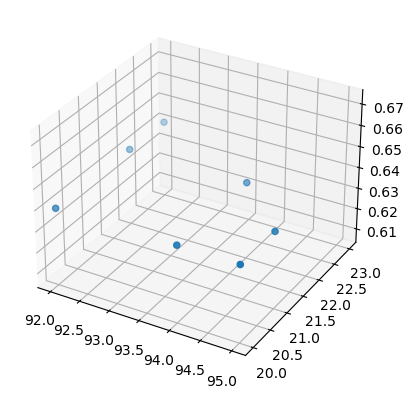

16.0 7 0
16.0 8
[0.32 0.64 6.72]


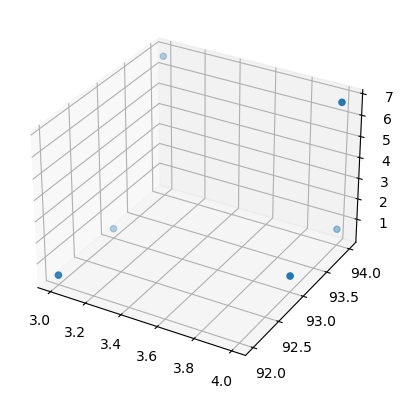

16.0 8 8
16.0 9
[0.64]


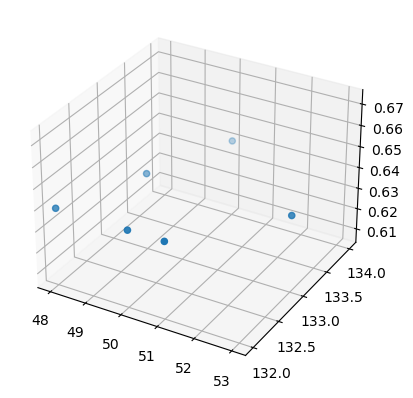

16.0 9 0
16.0 10
[0.64]


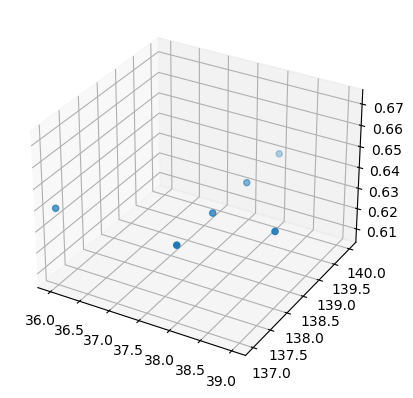

16.0 10 0
16.0 11
[0.64]


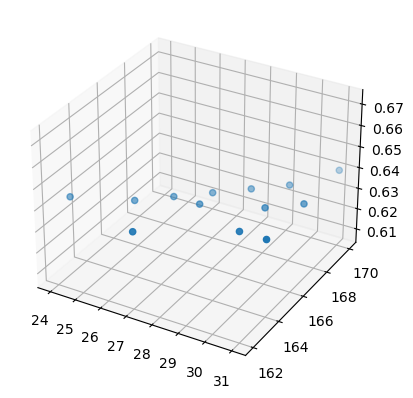

16.0 11 0
16.0 12
[0.64 3.84]


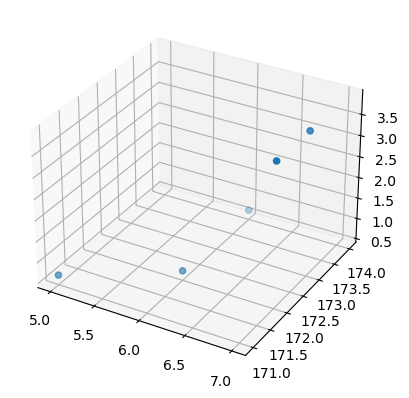

16.0 12 6
16.0 13
[0.64 3.84 6.72]


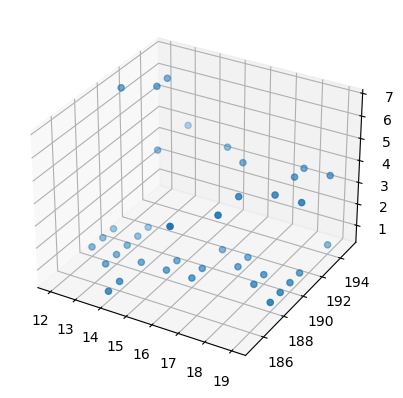

16.0 13 76
16.0 14
[0.64 3.84 6.72]


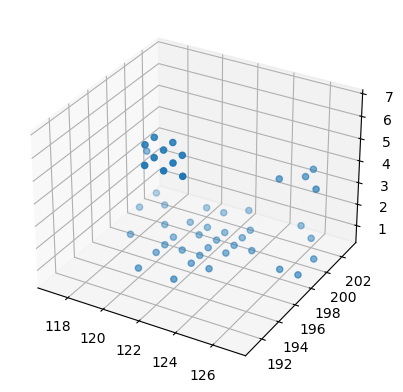

16.0 14 96
16.0 15
[0.64 6.72]


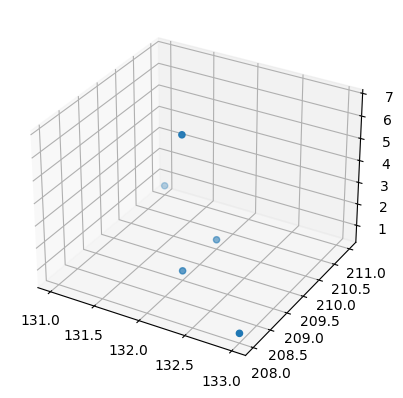

16.0 15 6
16.0 16
[0.32 0.64 3.84]


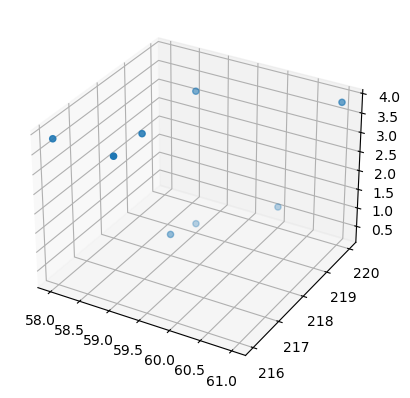

16.0 16 12
16.0 17
[0.64]


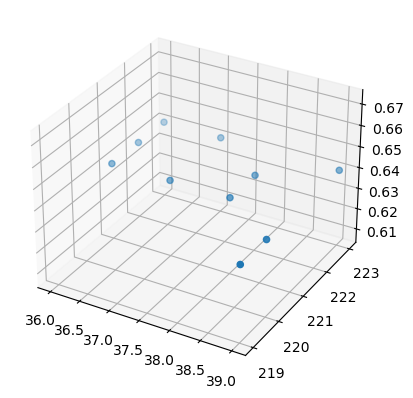

16.0 17 0
16.0 18
[3.84]


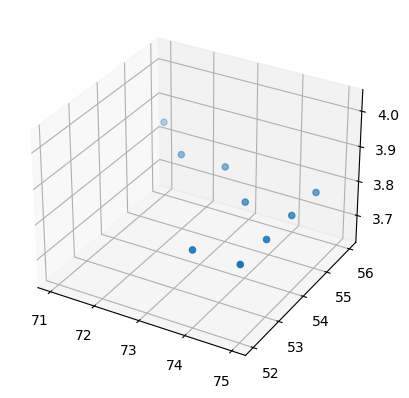

16.0 18 0
16.0 19
[3.84]


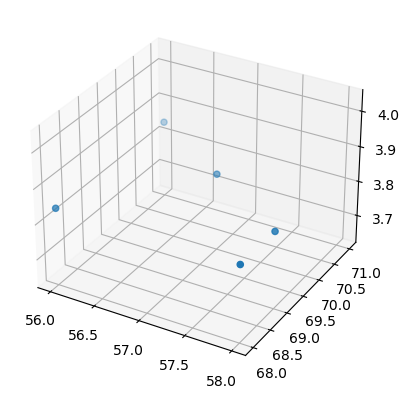

16.0 19 0
16.0 20
[0.32 3.84]


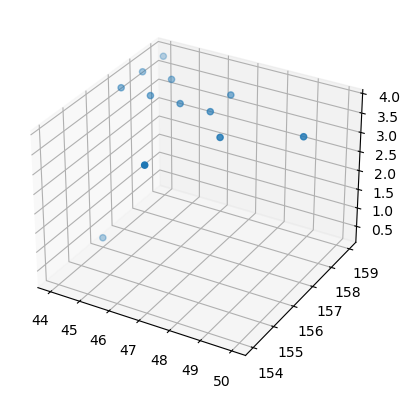

16.0 20 22
16.0 21
[0.64 3.84]


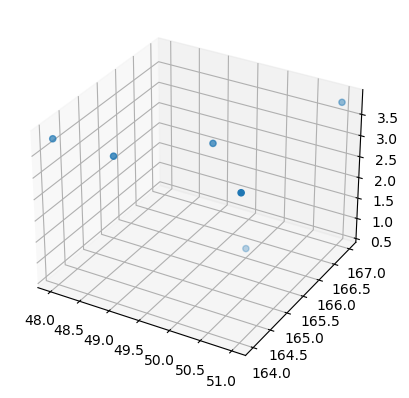

16.0 21 8
16.0 22
[3.84]


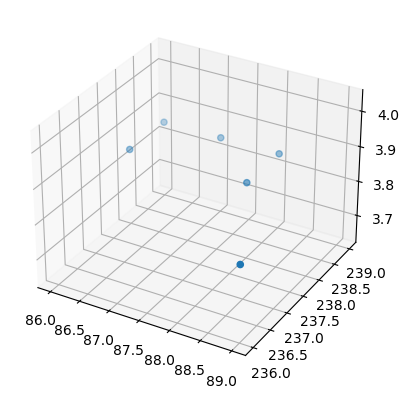

16.0 22 0
16.0 23
[3.84 6.72]


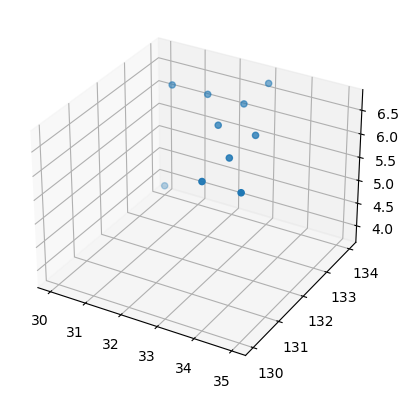

16.0 23 10
16.0 24
[0.64 6.72]


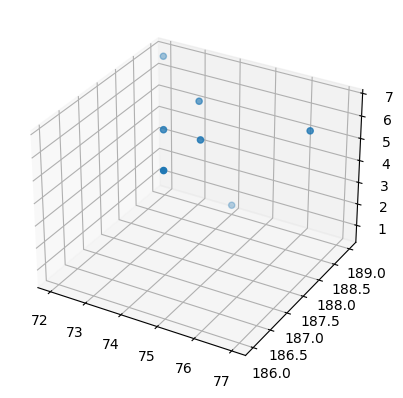

16.0 24 10
16.0 25
[3.84 6.72]


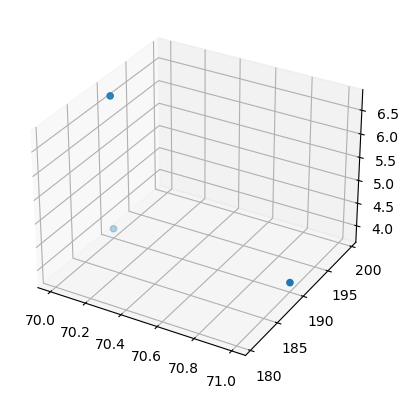

16.0 25 0
16.0 26
[6.72]


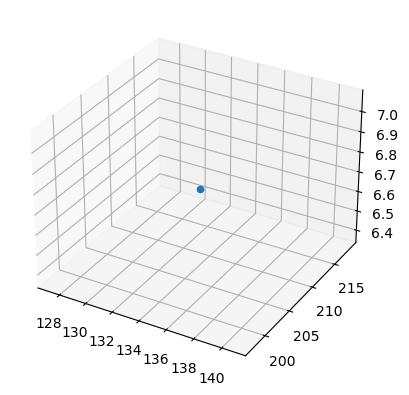

16.0 26 0
17.0 [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17.0 0
[0.32 0.64 3.84 6.72]


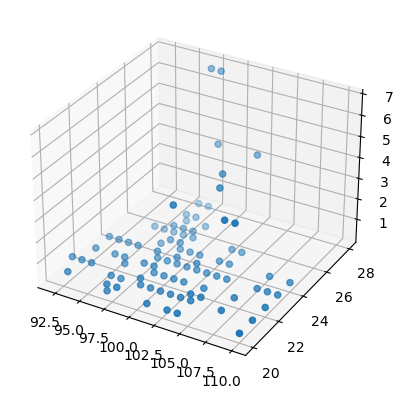

17.0 0 152
17.0 1
[0.32 0.64]


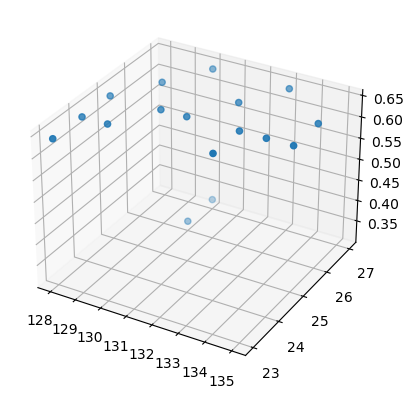

17.0 1 16
17.0 2
[0.32 0.64 3.84 6.72]


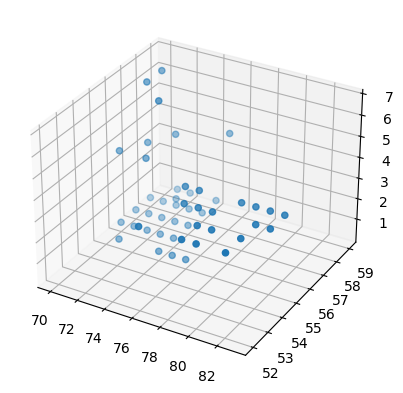

17.0 2 74
17.0 3
[0.32]


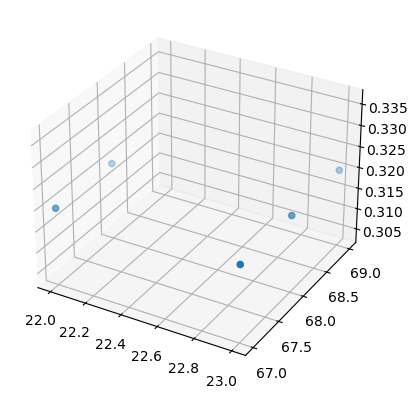

17.0 3 0
17.0 4
[0.32]


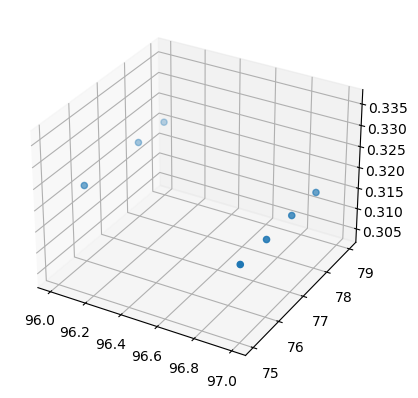

17.0 4 0
17.0 5
[0.32 0.64 3.84 6.72]


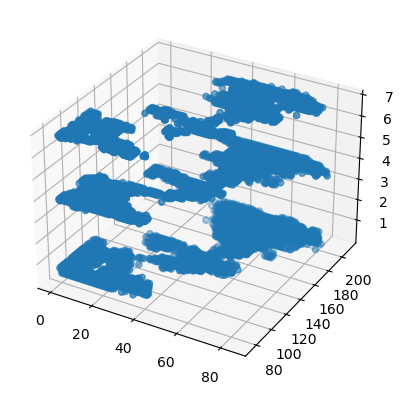

17.0 5 10812
17.0 6
[0.32 0.64 3.84 6.72]


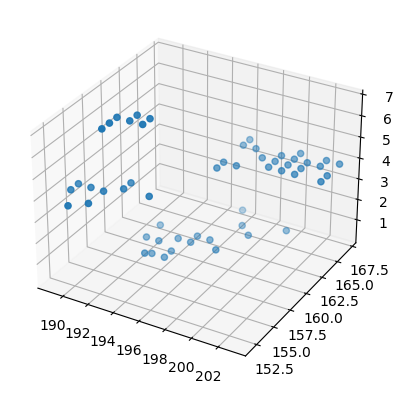

17.0 6 98
17.0 7
[0.32 0.64 3.84 6.72]


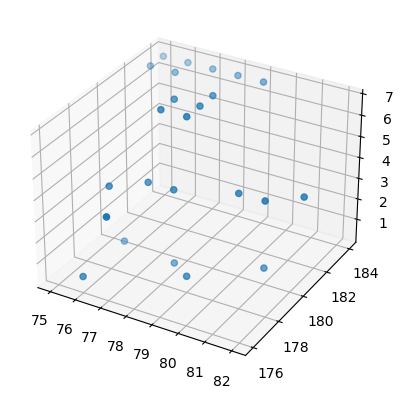

17.0 7 46
17.0 8
[0.32 0.64]


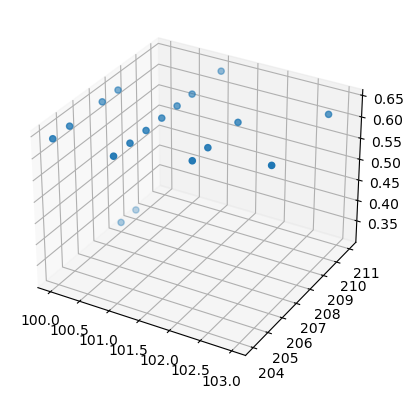

17.0 8 14
17.0 9
[0.32 0.64]


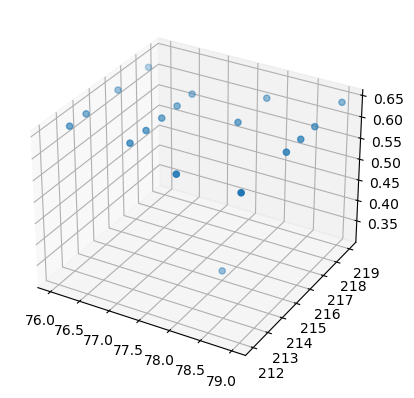

17.0 9 28
17.0 10
[0.64 3.84 6.72]


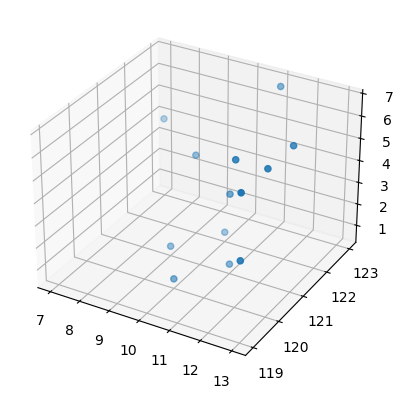

17.0 10 24
17.0 11
[0.64 3.84 6.72]


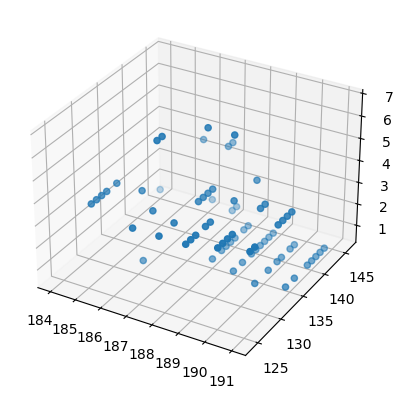

17.0 11 122
17.0 12
[0.64 3.84]


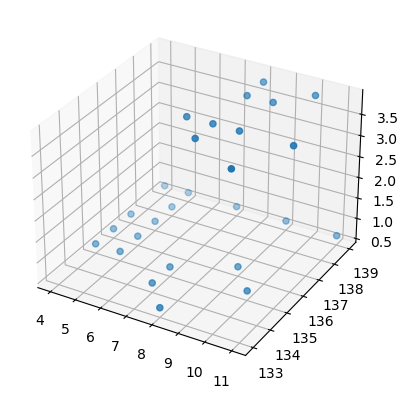

17.0 12 50
17.0 13
[0.64]


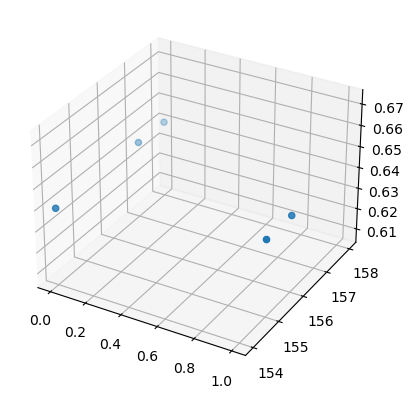

17.0 13 0
17.0 14
[0.64 3.84]


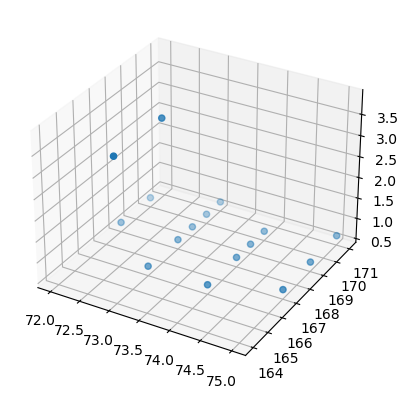

17.0 14 28
17.0 15
[0.64 3.84]


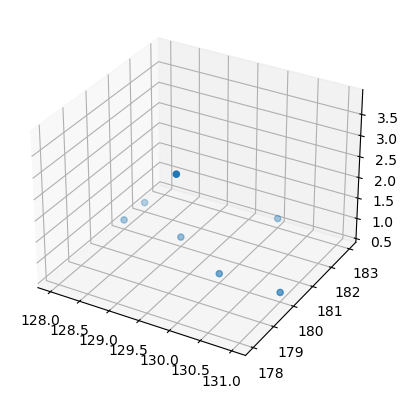

17.0 15 10
17.0 16
[3.84]


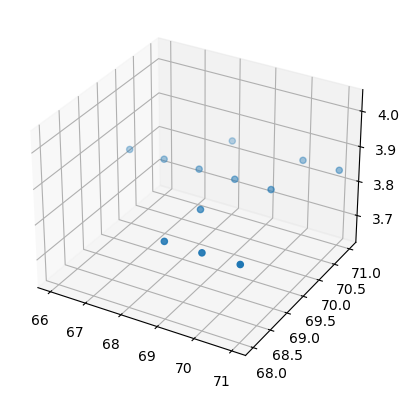

17.0 16 0
17.0 17
[3.84]


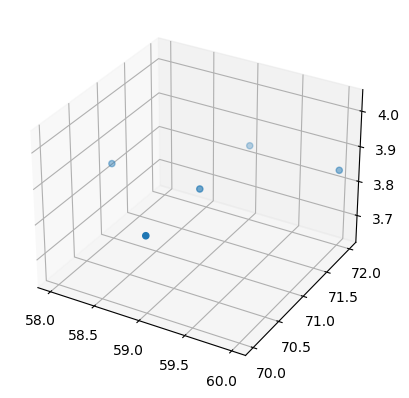

17.0 17 0
17.0 18
[3.84]


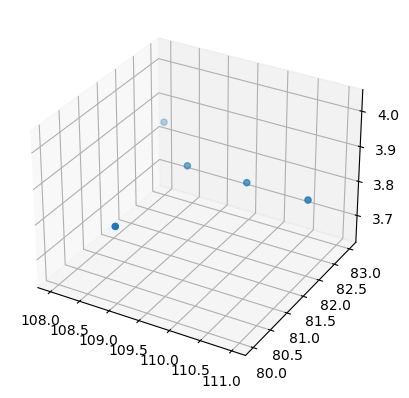

17.0 18 0
17.0 19
[3.84 6.72]


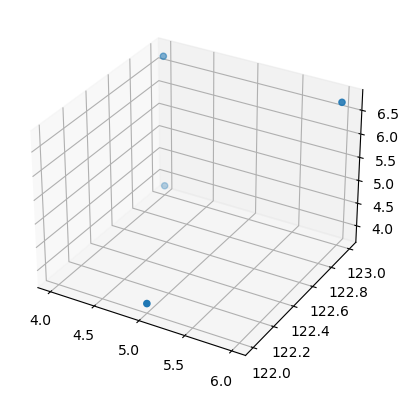

17.0 19 4
18.0 [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13]
18.0 0
[0.32 0.64 3.84 6.72]


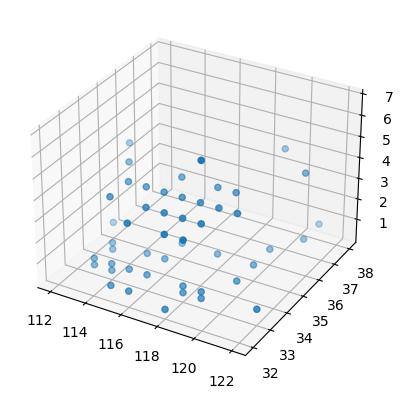

18.0 0 76
18.0 1
[0.32 0.64 3.84 6.72]


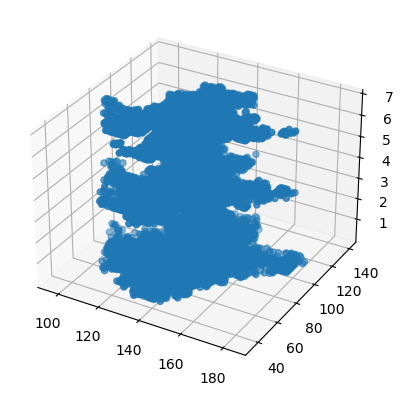

18.0 1 12650
18.0 2
[0.32 0.64 3.84 6.72]


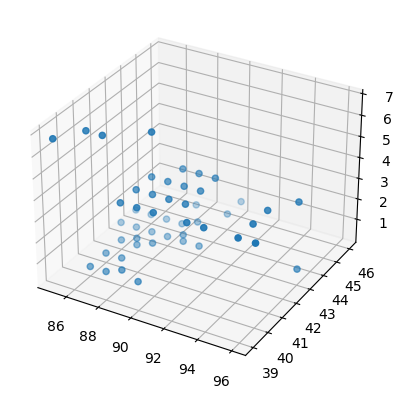

18.0 2 78
18.0 3
[0.32 0.64]


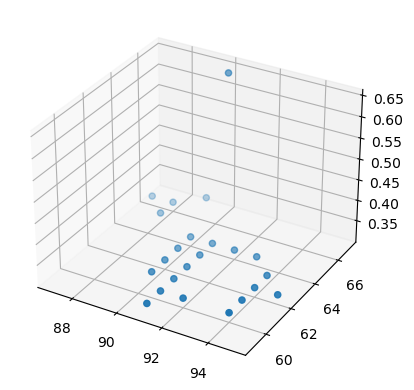

18.0 3 26
18.0 4
[0.32 0.64 6.72]


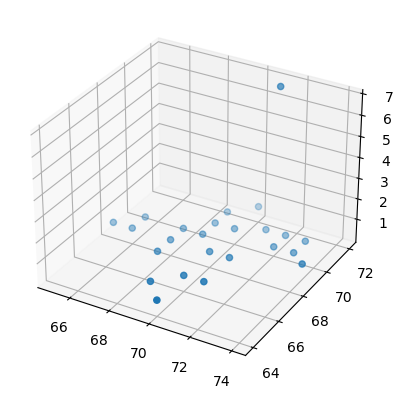

18.0 4 24
18.0 5
[0.32 0.64]


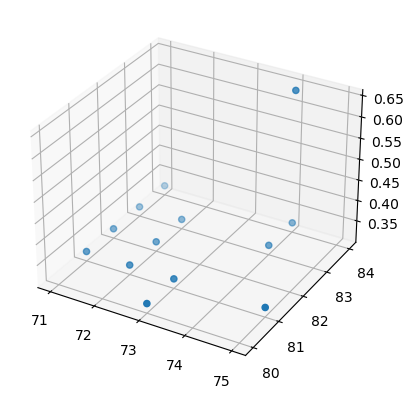

18.0 5 18
18.0 6
[0.32 0.64]


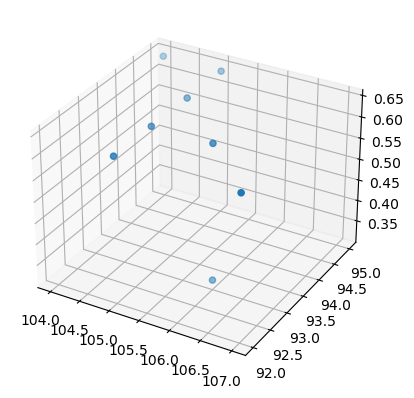

18.0 6 10
18.0 7
[0.64 3.84]


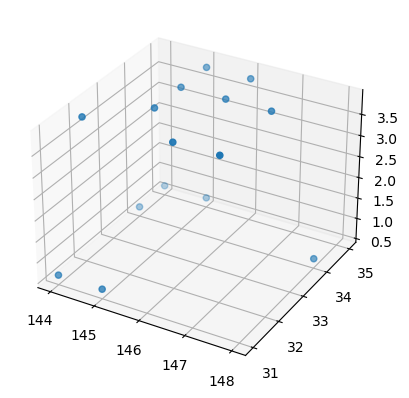

18.0 7 26
18.0 8
[0.64 3.84 6.72]


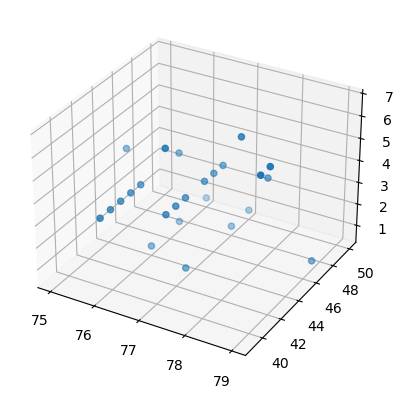

18.0 8 44
18.0 9
[0.64]


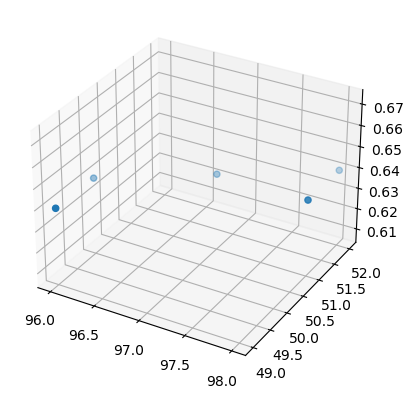

18.0 9 0
18.0 10
[0.64]


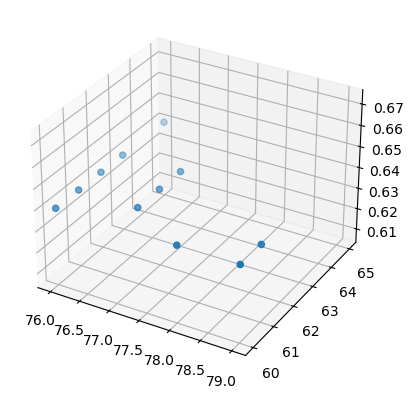

18.0 10 0
18.0 11
[6.72]


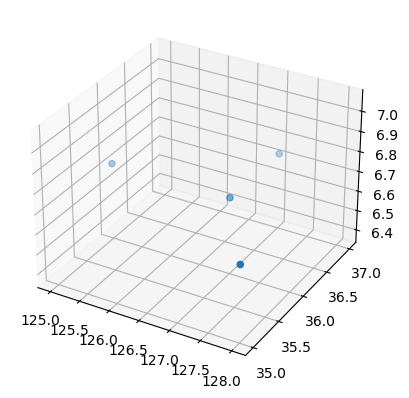

18.0 11 0
18.0 12
[3.84 6.72]


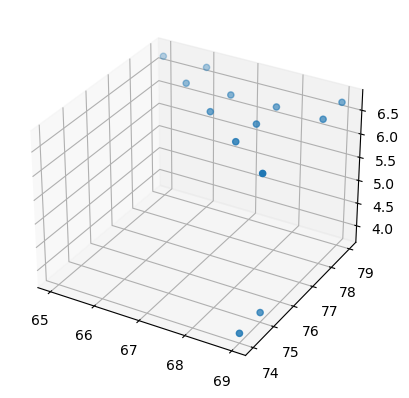

18.0 12 18
18.0 13
[6.72]


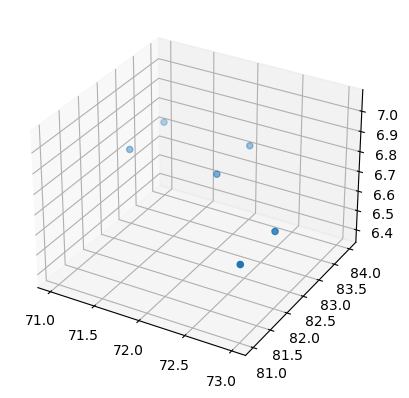

18.0 13 0
19.0 [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31 32 33]
19.0 0
[0.32 0.64 3.84 6.72]


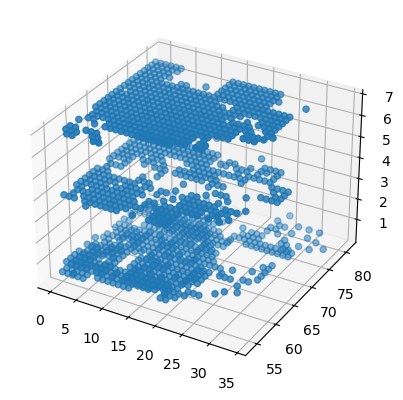

19.0 0 1990
19.0 1
[0.32 0.64 3.84 6.72]


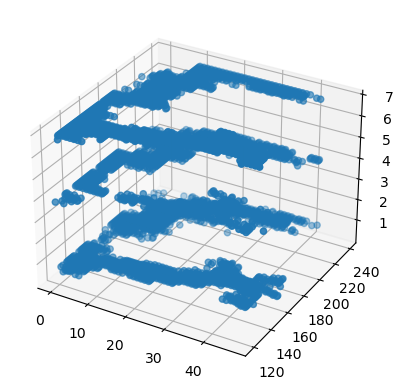

19.0 1 6704
19.0 2
[0.32 3.84]


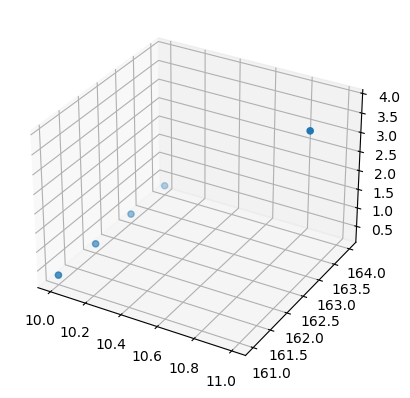

19.0 2 0
19.0 3
[0.32 0.64 3.84]


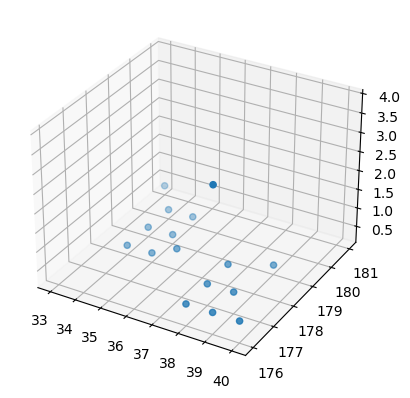

19.0 3 32
19.0 4
[0.32 0.64 3.84 6.72]


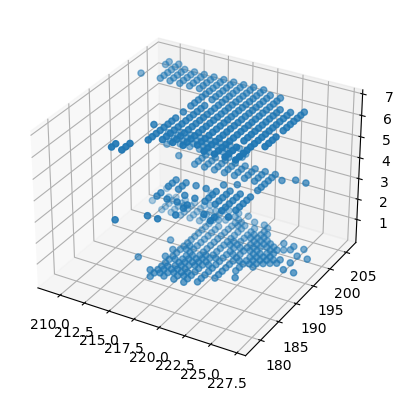

19.0 4 896
19.0 5
[0.32 0.64 3.84 6.72]


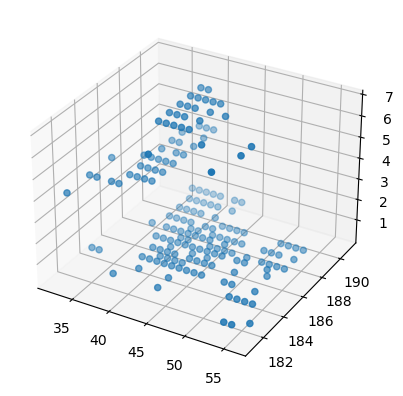

19.0 5 274
19.0 6
[0.32 0.64 3.84 6.72]


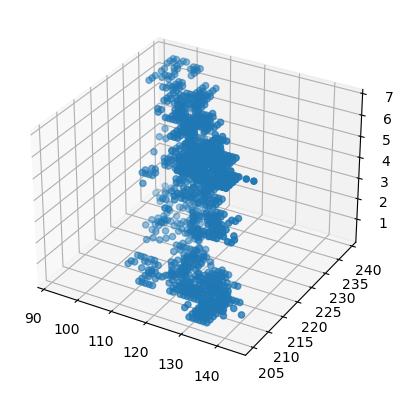

19.0 6 1442
19.0 7
[0.32 0.64 3.84]


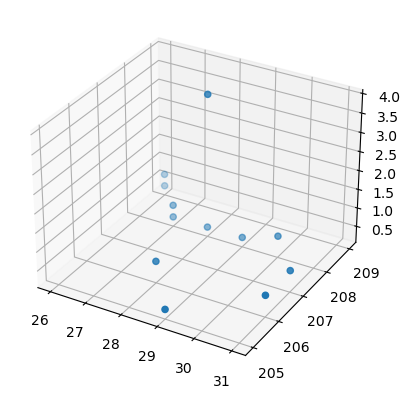

19.0 7 20
19.0 8
[0.32 0.64 3.84]


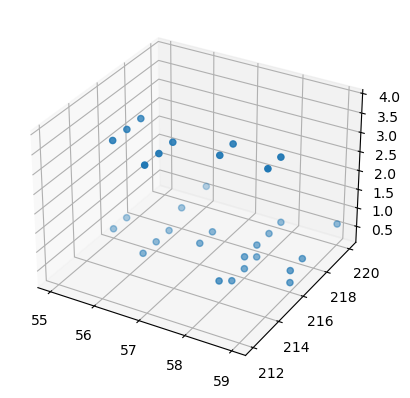

19.0 8 46
19.0 9
[0.64 3.84 6.72]


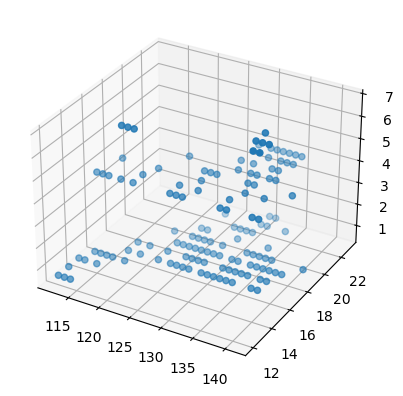

19.0 9 268
19.0 10
[0.64 3.84 6.72]


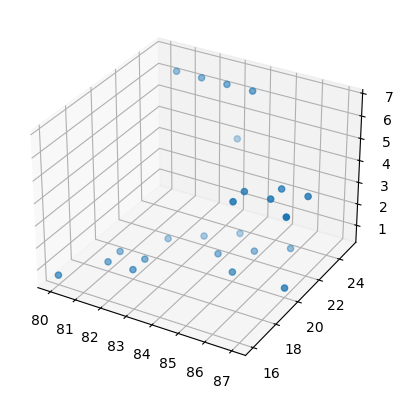

19.0 10 40
19.0 11
[0.64 6.72]


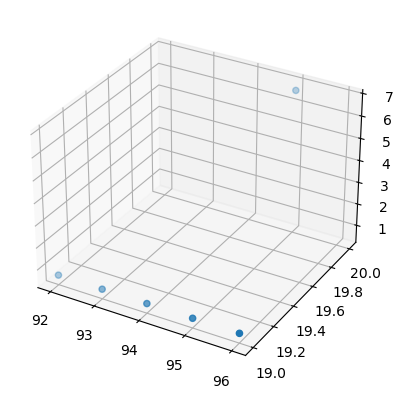

19.0 11 0
19.0 12
[0.64]


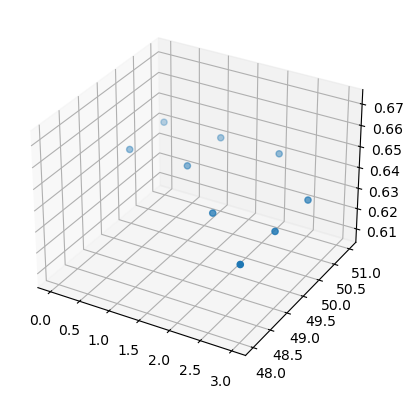

19.0 12 0
19.0 13
[0.64 3.84]


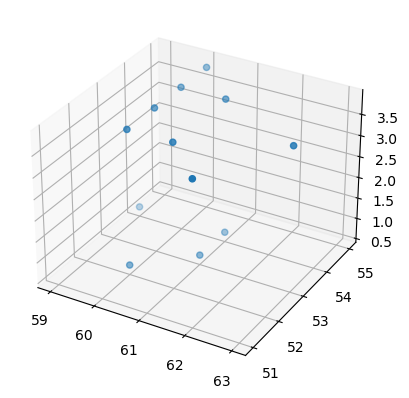

19.0 13 20
19.0 14
[0.64 6.72]


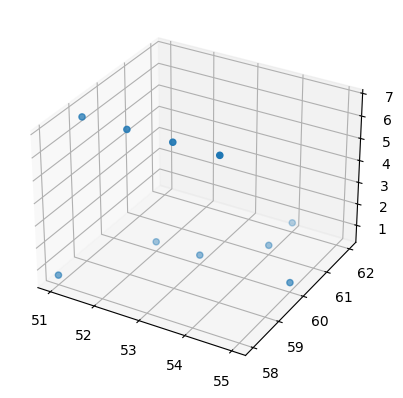

19.0 14 16
19.0 15
[0.64 3.84]


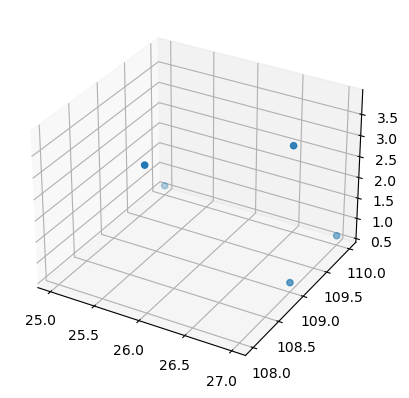

19.0 15 6
19.0 16
[0.64 3.84 6.72]


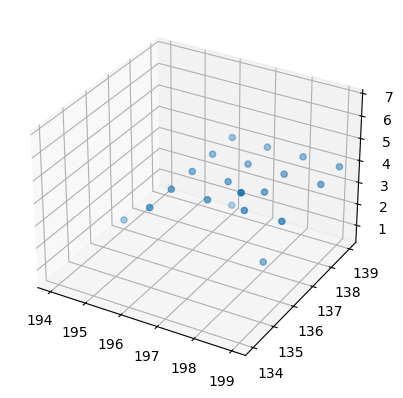

19.0 16 32
19.0 17
[0.64]


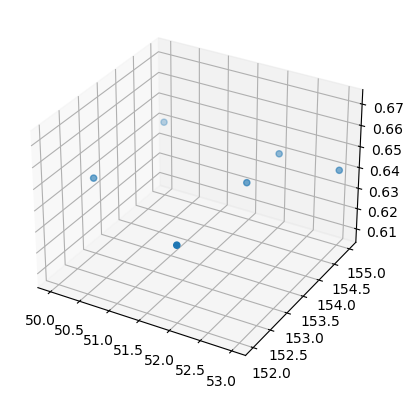

19.0 17 0
19.0 18
[0.64 3.84]


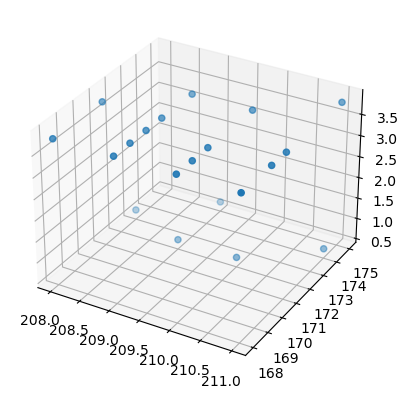

19.0 18 36
19.0 19
[0.64 3.84]


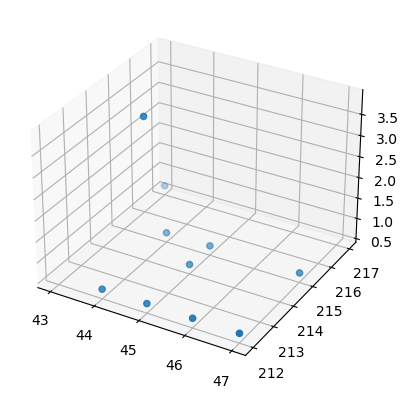

19.0 19 16
19.0 20
[0.64 6.72]


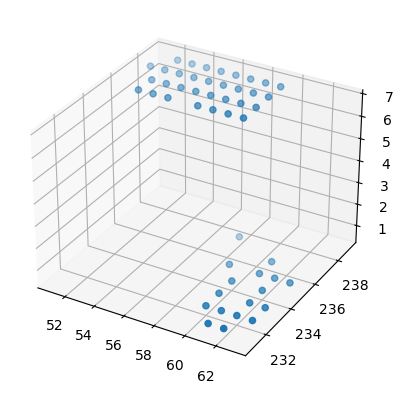

19.0 20 94
19.0 21
[3.84]


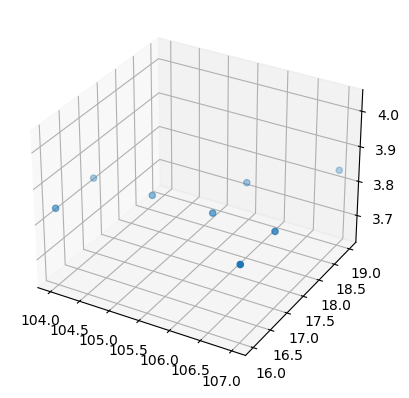

19.0 21 0
19.0 22
[3.84]


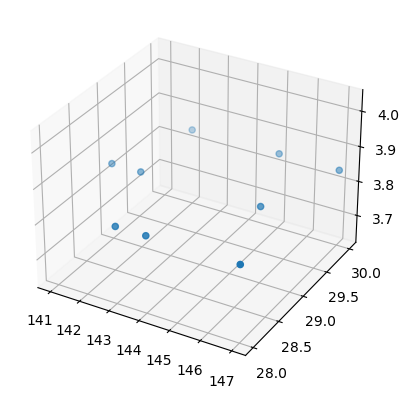

19.0 22 0
19.0 23
[3.84]


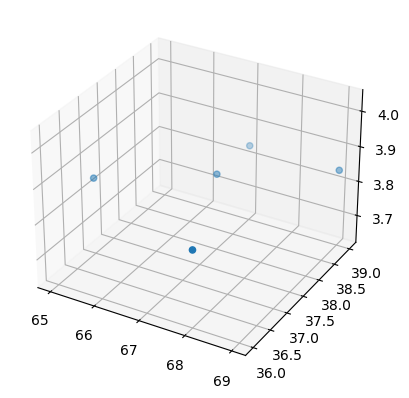

19.0 23 0
19.0 24
[0.64 3.84]


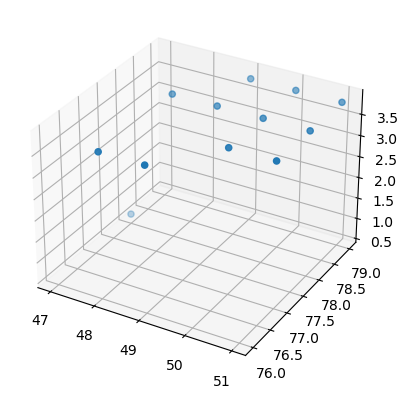

19.0 24 20
19.0 25
[3.84]


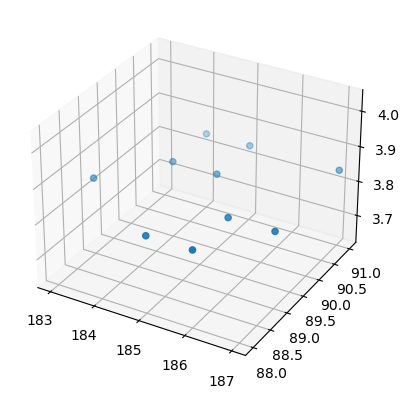

19.0 25 0
19.0 26
[0.64 3.84 6.72]


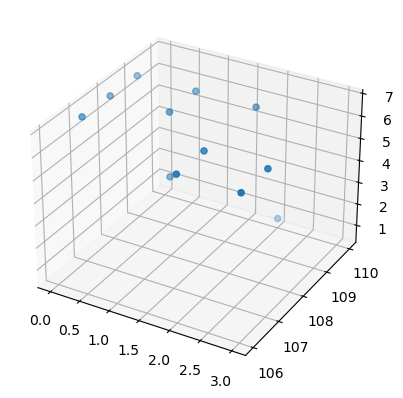

19.0 26 20
19.0 27
[0.32 3.84]


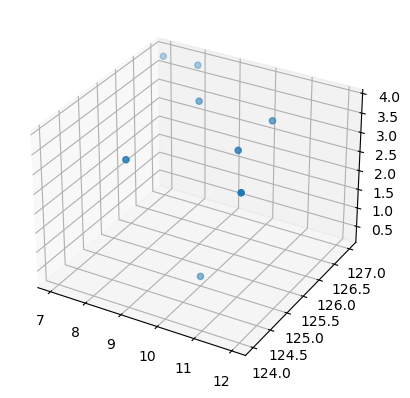

19.0 27 12
19.0 28
[3.84]


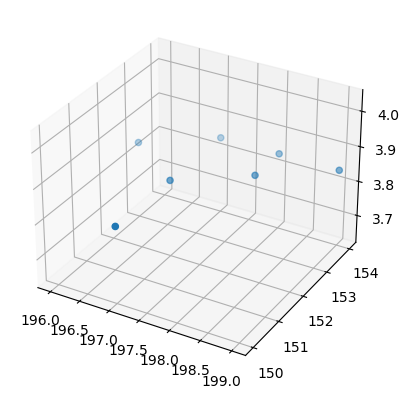

19.0 28 0
19.0 29
[3.84]


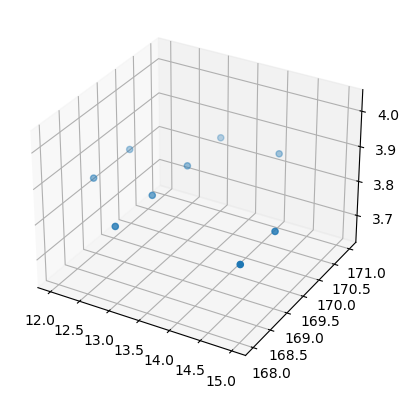

19.0 29 0
19.0 30
[3.84]


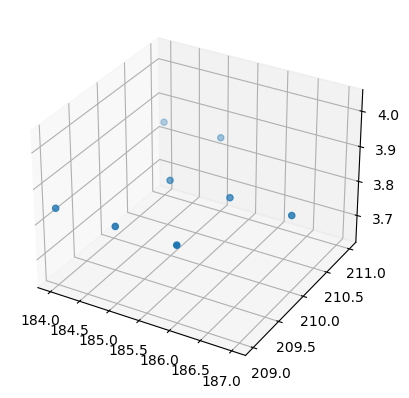

19.0 30 0
19.0 31
[0.64 3.84 6.72]


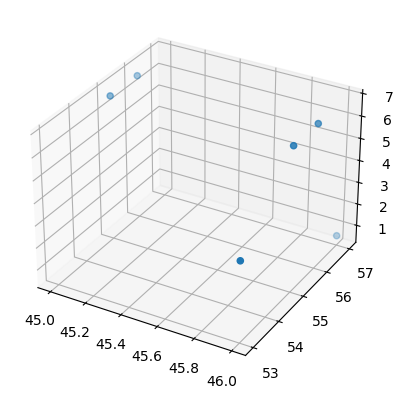

19.0 31 8
19.0 32
[0.64 6.72]


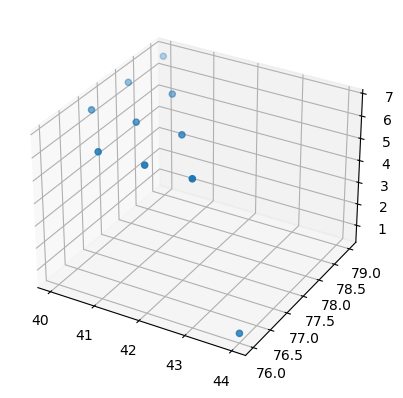

19.0 32 10
19.0 33
[3.84 6.72]


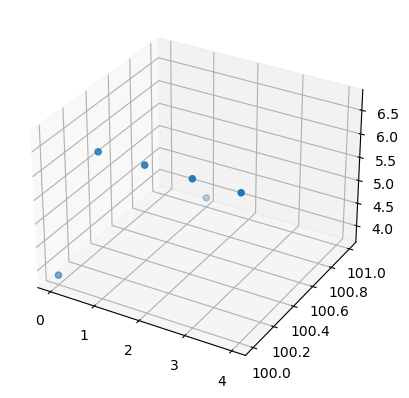

19.0 33 6


In [857]:
mesh_dict = cluster_pt_clouds(z_scaled_xyz[:, :-1], z_scaled_xyz[:, -1], alpha=.25)

In [855]:
d = mesh_dict[11][11]

mesh = trimesh.Trimesh(d['vertices'], d['faces'], d['face_normals'])

In [856]:
mesh.show()

In [846]:
import json
to_save = {int(k):{int(k2):v2 for k2, v2 in v.items()} for k, v in mesh_dict.items()}
json.dump(to_save, open(os.path.join(result_dir, 'meshes.json'), 'w'))

In [535]:
p = shapely.Point(51, -1)
l = shapely.LineString([(52, -1), (49, 2)])
gc = shapely.GeometryCollection([p, l])

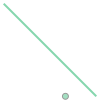

In [536]:
gc

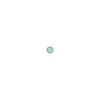

In [538]:
gc.geoms[0]

In [497]:
x.to

array([0.56485355, 0.56066948, 0.51882845, 0.49790794, 0.45606694,
       0.39330545, 0.37656903, 0.36820084, 0.33054394, 0.30125523,
       0.29707113, 0.26778242, 0.25104603, 0.25104603, 0.25104603,
       0.25104603, 0.25104603, 0.23430963, 0.22175732, 0.22175732,
       0.22175732, 0.22594142, 0.28451884, 0.29288703, 0.38493723,
       0.38912135, 0.40167364, 0.53556484, 0.55230123, 0.57322174,
       0.57740587, 0.59414226, 0.58995813, 0.58158994, 0.56485355])

In [315]:
300 / 1000

0.3

In [508]:
import shapely

In [520]:
ob = shapely.MultiPolygon([
    (
        ((0.0, 0.0), (0.0, 1.0), (1.0, 1.0), (1.0, 0.0)),
        [((0.1,0.1), (0.1,0.2), (0.2,0.2), (0.2,0.1))]
    )
])

In [528]:
ob.convex_hull.exterior.xy

(array('d', [0.0, 0.0, 1.0, 1.0, 0.0]), array('d', [0.0, 1.0, 1.0, 0.0, 0.0]))

In [298]:
from sklearn.cluster import DBSCAN

In [301]:
xyz = np.load(os.path.join(result_dir, '20kmeans_xyz.npy'))
xyz.shape

(226560, 4)

In [361]:
xyz

array([[  0,   0,   1,   1],
       [  1,   0,   1,   1],
       [  2,   0,   1,   1],
       ...,
       [233, 239,  21,   1],
       [234, 239,  21,   1],
       [235, 239,  21,   6]])

In [675]:
smooshed = xyz.copy().astype(np.float32)
mapping = {x:i for i, x in enumerate(np.unique(xyz[:, 2]))}
smooshed[:, 2] = [mapping[x] for x in smooshed[:, 2]]
smooshed

array([[  0.,   0.,   0.,   1.],
       [  1.,   0.,   0.,   1.],
       [  2.,   0.,   0.,   1.],
       ...,
       [233., 239.,   3.,   1.],
       [234., 239.,   3.,   1.],
       [235., 239.,   3.,   6.]], dtype=float32)

In [676]:
cluster = 11
f = smooshed[smooshed[:, -1]==cluster][:, :-1].astype(np.float32)
f /= f.max()
f

array([[0.5420561 , 0.1495327 , 0.        ],
       [0.5373832 , 0.1542056 , 0.        ],
       [0.5420561 , 0.1542056 , 0.        ],
       ...,
       [0.40654206, 0.97196263, 0.01401869],
       [0.41121495, 0.97196263, 0.01401869],
       [0.41588786, 0.97196263, 0.01401869]], dtype=float32)

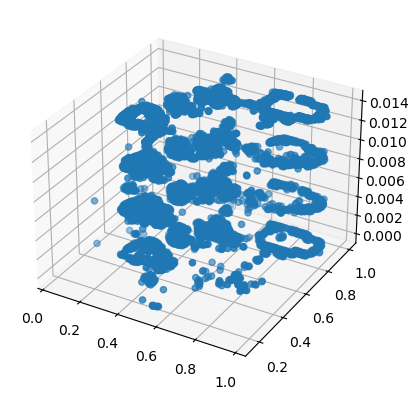

In [677]:
fig = plt.figure()
ax = fig.add_subplot(111, projection="3d")
ax.scatter(f[:, 0], f[:, 1], f[:, 2])

In [678]:
clustering = DBSCAN(eps=.01)
cs = clustering.fit_predict(f)

In [679]:
np.unique(cs, return_counts=True)

(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
        16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]),
 array([ 320,   37,   10, 3328,   22,   32,   15,   40, 1414,   48,    6,
          57,   11, 2673,    9, 2048,    5,   96,  269,    9,    4,    7,
           7,    7,    6,    5,   24,   10,    6,    6,   18]))

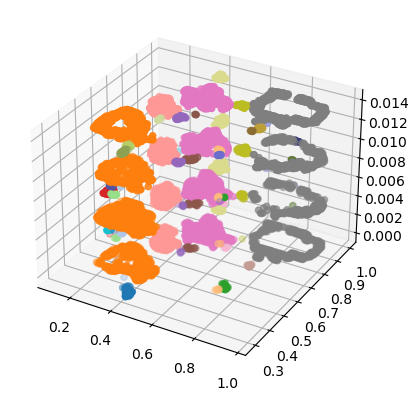

In [680]:
fig = plt.figure()
ax = fig.add_subplot(111, projection="3d")
cmap = sns.color_palette('tab20') + sns.color_palette('tab20b')
for c in np.unique(cs):
    if c >= 0:
        color = cmap[c]
        fs = f[cs==c]
        ax.scatter(fs[:, 0], fs[:, 1], fs[:, 2], color=color)
        

In [686]:
sns.color_palette('tab20')

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (0.6823529411764706, 0.7803921568627451, 0.9098039215686274),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (1.0, 0.7333333333333333, 0.47058823529411764),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.596078431372549, 0.8745098039215686, 0.5411764705882353),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (1.0, 0.596078431372549, 0.5882352941176471),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.7725490196078432, 0.6901960784313725, 0.8352941176470589),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.7686274509803922, 0.611764705882353, 0.5803921568627451),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.9686274509803922, 0.7137254901960784, 0.8235294117647058),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7803921568627451, 0.7803921568627451, 0.7803921568627451),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.8588235294117647, 0.8588235294117647, 0.5529411764705883),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529),
 (0.6196078431372549, 0.8549019607843137, 0.8980392156862745)]

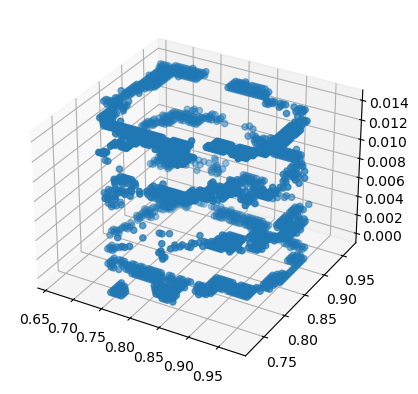

In [701]:
pts = f[cs==14]
fig = plt.figure()
ax = fig.add_subplot(111, projection="3d")
ax.scatter(pts[:, 0], pts[:, 1], pts[:, 2])

In [702]:
from scipy.spatial import ConvexHull
hull = ConvexHull(pts)

In [703]:
np.unique(hull.simplices)

array([   0,    4,   25,   84,  207,  223,  280,  284,  293,  301,  372,
        424,  447,  560,  593,  594,  595,  598,  672,  687,  714,  746,
        764,  777,  801,  844,  950, 1188, 1197, 1325, 1377, 1378, 1382,
       1383, 1385, 1390, 1602, 1618, 1708, 1714, 1723, 1810, 1855, 1911,
       1996, 2022, 2044, 2045, 2047], dtype=int32)

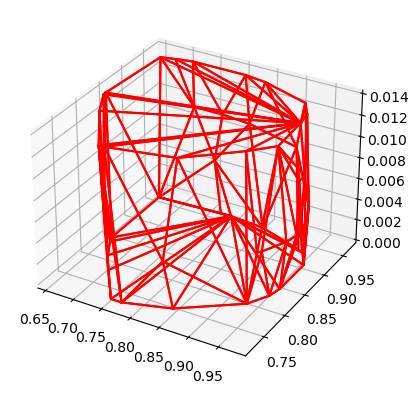

In [704]:
fig = plt.figure()
ax = fig.add_subplot(111, projection="3d")
for s in hull.simplices:
    s = np.append(s, s[0])  # Here we cycle back to the first coordinate
    ax.plot(pts[s, 0], pts[s, 1], pts[s, 2], "r-")

In [705]:
import alphashape
import trimesh

In [719]:
show_pts = pts.copy()
show_pts = show_pts[:, :]
mesh = alphashape.alphashape(show_pts, 50., )

In [720]:
# mesh.exterior

In [721]:
# x, y = mesh.exterior.xy
# x, y = np.asarray(x), np.asarray(y)
# xy = np.concatenate([np.expand_dims(arr, -1) for arr in [x, y]], axis=-1)
# xy.shape

In [722]:
# show_pts = pts.copy()
# show_pts[:, 2] *= 10.
# mesh = alphashape.alphashape(show_pts, 10., )

In [723]:
mesh.show()

In [602]:
mesh.convex_hull.show()

In [445]:
d = trimesh.exchange.export.export_dict(mesh.convex_hull)
d

{'metadata': {},
 'faces': [[15, 35, 30],
  [52, 29, 28],
  [6, 20, 3],
  [8, 25, 24],
  [24, 45, 23],
  [3, 16, 2],
  [2, 16, 35],
  [46, 21, 44],
  [21, 42, 44],
  [36, 30, 35],
  [15, 30, 36],
  [18, 42, 21],
  [21, 5, 18],
  [26, 50, 52],
  [52, 28, 26],
  [28, 12, 26],
  [26, 12, 50],
  [33, 12, 11],
  [11, 21, 33],
  [33, 21, 46],
  [23, 6, 7],
  [7, 24, 23],
  [8, 24, 7],
  [22, 6, 23],
  [20, 6, 22],
  [9, 14, 29],
  [13, 28, 29],
  [29, 14, 13],
  [13, 12, 28],
  [32, 41, 20],
  [20, 22, 32],
  [23, 45, 32],
  [32, 22, 23],
  [35, 16, 38],
  [51, 34, 53],
  [53, 29, 52],
  [53, 34, 29],
  [29, 34, 27],
  [27, 34, 25],
  [27, 25, 8],
  [8, 9, 27],
  [27, 9, 29],
  [48, 34, 51],
  [25, 34, 48],
  [45, 24, 48],
  [48, 24, 25],
  [1, 2, 35],
  [1, 35, 15],
  [15, 0, 1],
  [10, 21, 11],
  [10, 5, 21],
  [17, 0, 15],
  [4, 0, 17],
  [42, 18, 17],
  [17, 5, 4],
  [17, 18, 5],
  [47, 33, 46],
  [43, 32, 45],
  [41, 32, 43],
  [31, 16, 3],
  [31, 38, 16],
  [39, 17, 15],
  [50, 12, 49]

In [430]:
idxs = np.unique(np.asarray(d['faces']))
idxs.shape

(4337,)

In [403]:
verts = np.asarray(d['vertices'])
verts.shape

(4478, 3)

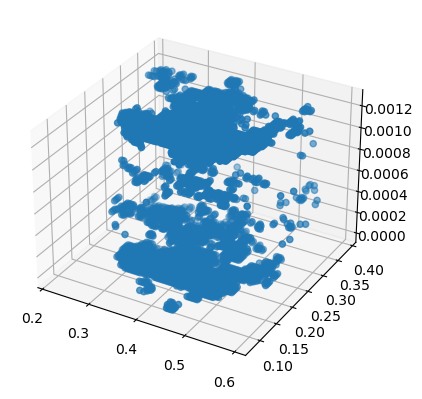

In [404]:
fig = plt.figure()
ax = fig.add_subplot(111, projection="3d")
ax.scatter(verts[idxs, 0], verts[idxs, 1], verts[idxs, 2])

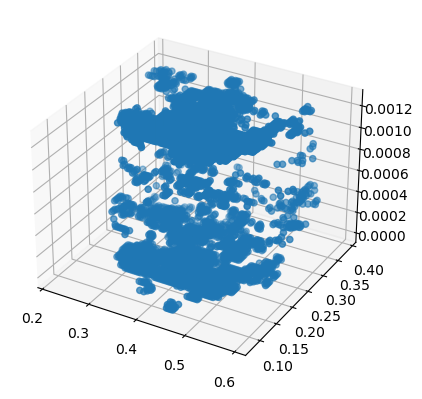

In [391]:
fig = plt.figure()
ax = fig.add_subplot(111, projection="3d")
ax.scatter(verts[:, 0], verts[:, 1], verts[:, 2])

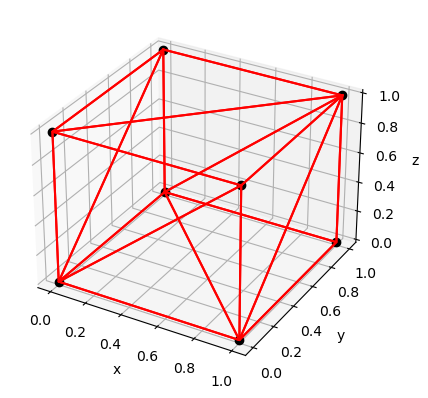

In [297]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.spatial import ConvexHull


# 8 points defining the cube corners
pts = np.array([[0, 0, 0], [1, 0, 0], [1, 1, 0], [0, 1, 0],
                [0, 0, 1], [1, 0, 1], [1, 1, 1], [0, 1, 1], ])

hull = ConvexHull(pts)

fig = plt.figure()
ax = fig.add_subplot(111, projection="3d")

# Plot defining corner points
ax.plot(pts.T[0], pts.T[1], pts.T[2], "ko")

# 12 = 2 * 6 faces are the simplices (2 simplices per square face)
for s in hull.simplices:
    s = np.append(s, s[0])  # Here we cycle back to the first coordinate
    ax.plot(pts[s, 0], pts[s, 1], pts[s, 2], "r-")

# Make axis label
for i in ["x", "y", "z"]:
    eval("ax.set_{:s}label('{:s}')".format(i, i))

plt.show()